In [ ]:
!nvidia-smi

Wed Jun 12 03:35:52 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   45C    P8              10W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
!pip install PyMuPDF
!pip install python-Levenshtein
!pip install editdistance

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.5/3.5 MB 31.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.9/15.9 MB 89.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 177.4/177.4 kB 3.5 MB/s eta 0:00:00


In [ ]:
!pip install scikit-image

In [ ]:
!pip install python-docx

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 244.3/244.3 kB 4.3 MB/s eta 0:00:00


In [ ]:
# Restart the notebook
!pip install transformers[torch]
!pip install accelerate -U

  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl.metadata (1.8 kB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-manylinu

In [ ]:
# Restart the notebook
!pip install datasets
!pip install jiwer

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 547.8/547.8 kB 11.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 10.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 316.1/316.1 kB 23.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 39.9/39.9 MB 16.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 64.9/64.9 kB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 11.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 12.1 MB/s eta 0:00:00
  Attempting uninstall: requests
    Found existing installation: requests 2.31.0
    Uninstalling requests-2.31.0:
      Successfully uninstalled requests-2.31.0
  Attempting uninstall: pyarrow
    Found existing installation: pyarrow 14.0.2
    Uninstalling pyarrow-14.0.2:
      Successfully uninstalled pyarrow-14.0.2
  Attempting uninstall: fsspec
    Found existing installation: fsspec 2024.6.1
    Uninstalling fsspec-2024.6.1:
  

# Installing Transformer Model


In [ ]:
!pip install -q git+https://github.com/huggingface/transformers.git


  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


In [ ]:
import os
import numpy as np
from skimage.io import imread
from skimage.color import rgb2gray
from skimage.filters import threshold_otsu
import matplotlib.pyplot as plt
from heapq import heappop, heappush
from transformers import TrOCRProcessor, VisionEncoderDecoderModel
import torch
from torch.utils.data import Dataset, DataLoader

# Converting PDF To Png

In [ ]:
import shutil


file_path1 = '/content/drive/MyDrive/A/Padilla - 1 Nobleza virtuosa_Extract.pdf'
doc_path1 = '/content/drive/MyDrive/A/Padilla - 1 Nobleza virtuosa_Transcription (1).docx'
file_path2 = '/content/drive/MyDrive/A/Padilla - 2 Noble perfecto_Extract.pdf'
doc_path2 = '/content/drive/MyDrive/A/Padilla - 2 Noble perfecto_Transcription.docx'

shutil.copy(file_path1, './Padilla - 1 Nobleza virtuosa_Extract.pdf')
shutil.copy(file_path2, './Padilla - 2 Noble perfecto_Extract.pdf')
shutil.copy(doc_path1, './Padilla - 1 Nobleza virtuosa_Transcription (1).docx')
shutil.copy(doc_path2, './Padilla - 2 Noble perfecto_Transcription.docx')



'./Padilla - 2 Noble perfecto_Transcription.docx'

In [ ]:
import fitz
from PIL import Image

# Convert PDF to PNG images using fitz
def convert_pdf_to_images(pdf_path, output_folder):
    doc = fitz.open(pdf_path)
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    image_paths = []
    for page_num in range(doc.page_count):
        page = doc.load_page(page_num)
        pix = page.get_pixmap()
        image_path = os.path.join(output_folder, f"{pdf_path[9:20]}_page_{page_num + 1}.png")
        pix.save(image_path)
        image_paths.append(image_path)

    doc.close()
    return image_paths

In [ ]:
pdf_path1 = "/content/Padilla - 1 Nobleza virtuosa_Extract.pdf"
image_folder1 = "/content/image_folder1"
pdf_path2 = "/content/Padilla - 2 Noble perfecto_Extract.pdf"
image_folder2 = "/content/image_folder2"
image_path1 = convert_pdf_to_images(pdf_path1, image_folder1)
image_path2 = convert_pdf_to_images(pdf_path2, image_folder2)

image_path = []
image_path.extend(image_path1)
image_path.extend(image_path2)
print(image_path)

['/content/image_folder1/Padilla - 1_page_1.png', '/content/image_folder1/Padilla - 1_page_2.png', '/content/image_folder1/Padilla - 1_page_3.png', '/content/image_folder1/Padilla - 1_page_4.png', '/content/image_folder1/Padilla - 1_page_5.png', '/content/image_folder1/Padilla - 1_page_6.png', '/content/image_folder1/Padilla - 1_page_7.png', '/content/image_folder1/Padilla - 1_page_8.png', '/content/image_folder1/Padilla - 1_page_9.png', '/content/image_folder1/Padilla - 1_page_10.png', '/content/image_folder1/Padilla - 1_page_11.png', '/content/image_folder1/Padilla - 1_page_12.png', '/content/image_folder1/Padilla - 1_page_13.png', '/content/image_folder1/Padilla - 1_page_14.png', '/content/image_folder1/Padilla - 1_page_15.png', '/content/image_folder1/Padilla - 1_page_16.png', '/content/image_folder2/Padilla - 2_page_1.png', '/content/image_folder2/Padilla - 2_page_2.png', '/content/image_folder2/Padilla - 2_page_3.png', '/content/image_folder2/Padilla - 2_page_4.png', '/content/im

# Extract the text from doc and assign it to its corresponding image(page)

In [ ]:
import docx

transcript = {}
def read_transcriptions(image_paths, file_path):
    # Load the DOCX file
    doc = docx.Document(file_path)

    # Initialize the dictionary to store text from each page

    # Extract text from each paragraph and assign it to the corresponding image path in the dictionary
    text = ''
    image_index = -1
    num_images = len(image_paths)

    for para in doc.paragraphs:
        stripped_text = para.text.strip()
        if "PDF" in stripped_text or "END OF EXTRACT" in stripped_text:
            if image_index >= 0:
                transcript[image_paths[image_index]] = text.strip()
            image_index += 1
            text = ''
        elif stripped_text != '':
            text += stripped_text + "\n"

    # Add the last page text if exists
    if text.strip() and image_index < num_images:
        transcript[image_paths[image_index]] = text.strip()

    return transcript


In [ ]:
transcription_path = "/content/Padilla - 1 Nobleza virtuosa_Transcription (1).docx"
transcriptions = read_transcriptions(image_path1, transcription_path)  # Read transcriptions
transcription_path = "/content/Padilla - 2 Noble perfecto_Transcription.docx"
transcriptions = read_transcriptions(image_path2, transcription_path)  # Read transcriptions
print(transcript.keys())

dict_keys(['/content/image_folder1/Padilla - 1_page_1.png', '/content/image_folder1/Padilla - 1_page_2.png', '/content/image_folder1/Padilla - 1_page_3.png', '/content/image_folder1/Padilla - 1_page_4.png', '/content/image_folder1/Padilla - 1_page_5.png', '/content/image_folder1/Padilla - 1_page_6.png', '/content/image_folder1/Padilla - 1_page_7.png', '/content/image_folder1/Padilla - 1_page_8.png', '/content/image_folder1/Padilla - 1_page_9.png', '/content/image_folder1/Padilla - 1_page_10.png', '/content/image_folder1/Padilla - 1_page_11.png', '/content/image_folder1/Padilla - 1_page_12.png', '/content/image_folder1/Padilla - 1_page_13.png', '/content/image_folder1/Padilla - 1_page_14.png', '/content/image_folder1/Padilla - 1_page_15.png', '/content/image_folder1/Padilla - 1_page_16.png', '/content/image_folder2/Padilla - 2_page_1.png', '/content/image_folder2/Padilla - 2_page_2.png', '/content/image_folder2/Padilla - 2_page_3.png', '/content/image_folder2/Padilla - 2_page_4.png', '/

#Line Segmentation using A* Path Planning Algo

In [ ]:
from skimage.io import imread
from skimage.color import rgb2gray
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
from skimage.transform import resize
from skimage.filters import threshold_otsu
import os
from heapq import *
from skimage.graph import route_through_array

def heuristic(a, b):
    return (b[0] - a[0]) ** 2 + (b[1] - a[1]) ** 2

def get_binary(img):
    mean = np.mean(img)
    if mean == 0.0 or mean == 1.0:
        return img

    thresh = threshold_otsu(img)
    binary = img <= thresh
    binary = binary.astype(np.uint8)  # Convert to uint8 for consistency
    return binary

def astar(array, start, goal):

    neighbors = [(0,1),(0,-1),(1,0),(-1,0),(1,1),(1,-1),(-1,1),(-1,-1)]
    close_set = set()
    came_from = {}
    gscore = {start:0}
    fscore = {start:heuristic(start, goal)}
    oheap = []

    heappush(oheap, (fscore[start], start))

    while oheap:

        current = heappop(oheap)[1]

        if current == goal:
            data = []
            while current in came_from:
                data.append(current)
                current = came_from[current]
            return data

        close_set.add(current)
        for i, j in neighbors:
            neighbor = current[0] + i, current[1] + j
            tentative_g_score = gscore[current] + heuristic(current, neighbor)
            if 0 <= neighbor[0] < array.shape[0]:
                if 0 <= neighbor[1] < array.shape[1]:
                    if array[neighbor[0]][neighbor[1]] == 1:
                        continue
                else:
                    # array bound y walls
                    continue
            else:
                # array bound x walls
                continue

            if neighbor in close_set and tentative_g_score >= gscore.get(neighbor, 0):
                continue

            if  tentative_g_score < gscore.get(neighbor, 0) or neighbor not in [i[1]for i in oheap]:
                came_from[neighbor] = current
                gscore[neighbor] = tentative_g_score
                fscore[neighbor] = tentative_g_score + heuristic(neighbor, goal)
                heappush(oheap, (fscore[neighbor], neighbor))

    return []

def preprocess_image(image_path):
    img = imread(image_path)[:, :, :3]  # Read the image
    if img.ndim > 2:
        img = rgb2gray(img)  # Convert to grayscale if needed
    return img

def horizontal_projections(sobel_image):
    return np.sum(sobel_image, axis=1)

def binarize_image(image):
    threshold = threshold_otsu(image)
    return image < threshold

def find_peak_regions(hpp, threshold):
    peaks = []
    for i, hppv in enumerate(hpp):
        if hppv < threshold:
           peaks.append([i, hppv])
    return peaks


def line_segmentation(image_path, segmented_image_folder):
    image = imread(image_path)

    count = 0
    img = preprocess_image(image_path)  # Preprocess image
    page = 1

    if img.shape[1] > 400:
        top, bottom = 15, 420
        left1, right1 = 70, 290
        img1 = img[top:bottom, left1:right1]

        left2, right2 = 310, 550
        img2 = img[top:bottom, left2:right2]

        page = 2
    else:
        top, bottom = 25, 400
        left, right = 2, 250
        img1 = img[top:bottom, left:right]

    for i in range(page):
        img = img1 if i == 0 else img2

        img = resize(img, (511, 366))

        binarized_image = binarize_image(img)
        hpp = horizontal_projections(binarized_image)


        threshold = 100  # Using a fixed threshold value
        peaks = find_peak_regions(hpp, threshold)

        peaks_indexes = np.array(peaks)[:, 0].astype(int)

        segmented_img = np.copy(img)
        r, c = segmented_img.shape
        for ri in range(r):
            if ri in peaks_indexes:
                segmented_img[ri, :] = 0

        diff_between_consec_numbers = np.diff(peaks_indexes)  # Difference between consecutive numbers
        indexes_with_larger_diff = np.where(diff_between_consec_numbers > 1)[0].flatten()
        peak_groups = np.split(peaks_indexes, indexes_with_larger_diff)
        peak_groups = [item for item in peak_groups if len(item) > 8]

        binary_image = get_binary(img)
        segment_separating_lines = []

        for sub_image_index in peak_groups:
            start_row = sub_image_index[0]
            end_row = sub_image_index[-1]

            # Ensure start_row and end_row are within the bounds of the image
            start_row = max(0, start_row)
            end_row = min(binary_image.shape[0], end_row)

            # Extract the relevant portion of the binary image
            nmap = binary_image[start_row:end_row, :]

            # Define start and end points for A* algorithm
            start_point = (int(nmap.shape[0] / 2), 0)
            end_point = (int(nmap.shape[0] / 2), nmap.shape[1] - 1)

            # Find path using A* algorithm
            path, _ = route_through_array(nmap, start_point, end_point)

            # Add the offset to the path to get coordinates in the original image
            path = np.array(path) + start_row

            # Append the path to the list of segment separating lines
            segment_separating_lines.append(path)

        seperated_images = []

        for index, line_segments in enumerate(segment_separating_lines):
            if index < len(segment_separating_lines)-1:
                lower_line = np.min(segment_separating_lines[index][:,0])
                upper_line = np.max(segment_separating_lines[index+1][:,0])
                seperated_images.append(img[lower_line:upper_line])

        fig, axs = plt.subplots(len(seperated_images), 1, figsize=(10, 10))
        if len(seperated_images) == 1:
            axs = [axs]

        for index, line_image in enumerate(seperated_images):
            axs[index].imshow(line_image, cmap="gray")
            axs[index].axis('off')

        plt.show()

        if not os.path.exists(segmented_image_folder):
            os.makedirs(segmented_image_folder)

        for index, line_image in enumerate(seperated_images):
            output_path = os.path.join(segmented_image_folder, f'{os.path.basename(image_path)}_line_{count+1}.png')
            plt.imsave(output_path, line_image, cmap='gray')
            count += 1
            print(f"Saved line image to {output_path}")


# Aligning Line segemented images with its corresponding text

In [ ]:
import os
import re
import numpy as np
from skimage.io import imread
from skimage.color import rgb2gray

def get_segmented_image_paths(input_path, segmented_image_dir):
    # Get the base name from the input path
    base_name = os.path.basename(input_path)

    # List all files in the directory
    files = os.listdir(segmented_image_dir)

    # Filter the files to get only those that start with the base name and end with "_line_*.png"
    segmented_files = [os.path.join(segmented_image_dir, f) for f in files if f.startswith(base_name) and "_line_" in f and f.endswith(".png")]

    return segmented_files

def extract_line_number(file_path):
    # Extract the line number(s) from the file name using regex
    match = re.search(r'_line_(\d+(_\d+)?).png$', file_path)
    if match:
        return list(map(int, match.group(1).split('_')))
    return [-1]

def sort_segmented_image_paths(image_paths):
    # Sort the list of paths based on the extracted line number
    sorted_paths = sorted(image_paths, key=extract_line_number)
    return sorted_paths

def align_segments_with_transcriptions(image_path, line_segmentation_path, transcription):
    img = imread(image_path)[:,:,:3]
    if img.ndim > 2:
        img = rgb2gray(img)
    # Binarization function needs to be defined
    # binary_image = binarize_image(img)

    segmented_image_paths = get_segmented_image_paths(image_path, line_segmentation_path)
    segmented_image_paths = sort_segmented_image_paths(segmented_image_paths)
    line_text = transcription.split('\n')

    count = 0
    data = []

    for path in segmented_image_paths:
        transcript = ""

        line_img = imread(path)[:,:,:3]

        if line_img.ndim > 2:
            line_img = rgb2gray(line_img)

        try:
            if line_img.shape[0] < 50:
                transcript = line_text[count]
                count += 1
            elif line_img.shape[0] >= 50 and line_img.shape[0] < 92:
                for i in range(2):
                    transcript += line_text[count]
                    if i < 1:
                        transcript += "\n"
                    count += 1
            elif line_img.shape[0] >= 92 and line_img.shape[0] < 100:
                for i in range(4):
                    transcript += line_text[count]
                    if i < 3:
                        transcript += "\n"
                    count += 1
            elif line_img.shape[0] >= 100 and line_img.shape[0] < 110:
                for i in range(5):
                    transcript += line_text[count]
                    if i < 4:
                        transcript += "\n"
                    count += 1
            elif line_img.shape[0] >= 110:
                for i in range(6):
                    transcript += line_text[count]
                    if i < 5:
                        transcript += "\n"
                    count += 1

            data.append((line_img, transcript))
        except Exception as e:
            print(f"Error processing {image_path} - {path}: {e}")
            continue
    return data

# segmented_image_folder = "/content/drive/MyDrive/A/Line_Segmented_images"
segmented_image_folder = "/content/drive/MyDrive/A/New_Line_Segmented_images"
aligned_data = {}


for img_path in image_path:
    if img_path == '/content/image_folder1/Padilla - 1_page_16.png':
        # Left out of training for testing
        continue

    aligned_data[img_path] = align_segments_with_transcriptions(img_path, segmented_image_folder, transcript[img_path])


# Training 9

## Implemented both Beam Search Loss Function with Label smoothening technique, and hyperparameter tuning

In [ ]:
from transformers import GenerationConfig

generation_config = GenerationConfig(
    max_length=128,
    no_repeat_ngram_size=3
)

generation_config.save_pretrained("generation_config_5")

In [ ]:
import albumentations as A
import torch
from torch.utils.data import Dataset, DataLoader, random_split
from transformers import TrOCRProcessor, VisionEncoderDecoderModel, Trainer, TrainingArguments, GenerationConfig, EarlyStoppingCallback
from PIL import Image
import numpy as np
from torch.nn.utils.rnn import pad_sequence
from torch.optim import AdamW
from torch.optim.lr_scheduler import ReduceLROnPlateau
from datasets import load_metric
import torch.nn.functional as F
import random
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader
import os
os.environ['CUDA_LAUNCH_BLOCKING'] = '1'
os.environ['TORCH_USE_CUDA_DSA'] = '0'


# Load the CER and WER metrics
cer_metric = load_metric("cer")
wer_metric = load_metric("wer")
processor = TrOCRProcessor.from_pretrained("qantev/trocr-large-spanish", do_rescale=False)
model = VisionEncoderDecoderModel.from_pretrained("qantev/trocr-large-spanish")

def set_random_seed(seed):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)

def compute_metrics(eval_pred):
    logits, labels = eval_pred
    if isinstance(logits, tuple):
        logits = logits[0]
    predictions = logits.argmax(-1)
    decoded_preds = processor.tokenizer.batch_decode(predictions, skip_special_tokens=True)
    decoded_labels = []
    for label in labels:
        label_filtered = [token for token in label if token != -100]
        decoded_label = processor.tokenizer.decode(label_filtered, skip_special_tokens=True)
        decoded_labels.append(decoded_label)
    cer_score = cer_metric.compute(predictions=decoded_preds, references=decoded_labels)
    wer_score = wer_metric.compute(predictions=decoded_preds, references=decoded_labels)
    return {"cer": cer_score, "wer": wer_score}

class LineDataset(Dataset):
    def __init__(self, processor, model, line_images, texts, target_size=(256, 64), max_length=512, apply_augmentation=False):
        self.line_images = line_images
        self.texts = texts
        self.processor = processor
        self.processor.image_processor.max_length = max_length
        self.processor.tokenizer.model_max_length = max_length
        self.model = model
        self.model.config.max_length = max_length
        self.target_size = target_size
        self.max_length = max_length
        self.apply_augmentation = apply_augmentation

        if apply_augmentation:
            self.transform = A.Compose([
                A.OneOf([
                    A.Rotate(limit=3, p=1.0),
                    A.GaussNoise(var_limit=(10.0, 50.0), p=1.0),
                    A.ElasticTransform(alpha=0.3, sigma=50.0, alpha_affine=0.3, p=1.0),
                    A.OpticalDistortion(distort_limit=0.03, shift_limit=0.03, p=1.0),
                    A.CLAHE(clip_limit=2, tile_grid_size=(4, 4), p=1.0),
                    A.Affine(scale=(0.95, 1.05), translate_percent=(0.015, 0.015), shear=(-2, 2), p=1.0),
                    A.Perspective(scale=(0.01, 0.03), p=1.0),
                    A.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.1, p=1.0),
                    A.GaussianBlur(blur_limit=(3, 7), p=1.0),
                    A.GridDistortion(num_steps=3, distort_limit=0.02, p=1.0),
                    A.HueSaturationValue(hue_shift_limit=10, sat_shift_limit=10, val_shift_limit=10, p=1.0),
                    A.MedianBlur(blur_limit=3, p=1.0)
                ], p=0.8),
            ])
        else:
            self.transform = A.Compose([])

    def __len__(self):
        return len(self.line_images)

    def __getitem__(self, idx):
        image = self.line_images[idx]
        text = self.texts[idx]

        if isinstance(image, Image.Image):
            image = np.array(image)

        if image.ndim == 2:
            image = np.expand_dims(image, axis=-1)
            image = np.repeat(image, 3, axis=-1)

        image = (image * 255).astype(np.uint8)

        if self.apply_augmentation:
            augmented = self.transform(image=image)
            image = augmented['image']

        image = Image.fromarray(image)
        image = image.resize(self.target_size, Image.BILINEAR)
        image = np.array(image) / 255.0
        image = np.transpose(image, (2, 0, 1))

        encoding = self.processor(images=image, text=text, return_tensors="pt")
        encoding['labels'] = encoding['labels'][:, :self.max_length]
        encoding = {k: v.squeeze() for k, v in encoding.items()}
        return encoding

def collate_fn(batch):
    pixel_values = torch.stack([item['pixel_values'] for item in batch])
    labels = pad_sequence([item['labels'] for item in batch], batch_first=True, padding_value=-100)
    return {'pixel_values': pixel_values, 'labels': labels}

def beam_search_loss(logits, labels, beam_size=5, length_penalty=2.0, alpha=0.6, label_smoothing=0.1):
    batch_size, seq_len, vocab_size = logits.shape
    beam_scores, beam_indices = logits.topk(beam_size, dim=-1)
    log_probs = F.log_softmax(logits, dim=-1)
    beam_log_probs = log_probs.gather(-1, beam_indices)

    mask = (labels != -100).float()
    sequence_lengths = mask.sum(dim=1)

    # Ensure labels are within valid range
    labels = labels.long()
    valid_labels = labels.clamp(min=0, max=vocab_size - 1)

    # Apply label smoothing
    smooth_labels = torch.zeros_like(logits).scatter_(-1, valid_labels.unsqueeze(-1), 1)
    smooth_labels = smooth_labels * (1 - label_smoothing) + label_smoothing / vocab_size

    beam_loss = -(smooth_labels * log_probs).sum(dim=-1)
    beam_loss = beam_loss.masked_fill(mask == 0, 0).sum(dim=1)

    normalized_beam_loss = beam_loss / (sequence_lengths ** length_penalty)
    log_likelihood = -normalized_beam_loss
    normalized_log_likelihood = log_likelihood / sequence_lengths.pow(alpha)

    losses = [-normalized_log_likelihood]
    stacked_losses = torch.stack(losses, dim=1)
    min_loss = stacked_losses.min(dim=1)[0]

    return min_loss.mean()



class BeamSearchTrainer(Trainer):
    def __init__(self, *args, label_smoothing=0.1, **kwargs):
        super().__init__(*args, **kwargs)
        self.label_smoothing = label_smoothing

    def compute_loss(self, model, inputs, return_outputs=False):
        labels = inputs.pop("labels")
        pixel_values = inputs.pop("pixel_values")

        outputs = model(pixel_values=pixel_values, labels=labels)
        logits = outputs.logits

        loss = beam_search_loss(logits, labels, label_smoothing=self.label_smoothing)

        return (loss, outputs) if return_outputs else loss

def train_transformer_model(line_images, texts, target_size=(256, 64), batch_size=8, max_length=512, val_split=0.1, initial_seed=42, label_smoothing=0.1):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    processor = TrOCRProcessor.from_pretrained("qantev/trocr-large-spanish", do_rescale=False)
    model = VisionEncoderDecoderModel.from_pretrained("qantev/trocr-large-spanish")
    generation_config = GenerationConfig.from_pretrained("generation_config_5")

    model.config.pad_token_id = processor.tokenizer.pad_token_id
    model.config.decoder_start_token_id = processor.tokenizer.bos_token_id

    dataset = LineDataset(processor, model, line_images, texts, target_size, max_length, apply_augmentation=True)

    val_size = int(len(dataset) * val_split)
    train_size = len(dataset) - val_size
    train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

    model = dataset.model.to(device)

    training_args = TrainingArguments(
        output_dir="./results",
        num_train_epochs=20,
        per_device_train_batch_size=batch_size,
        per_device_eval_batch_size=batch_size,
        logging_dir="./logs",
        logging_steps=50,
        save_steps=50,
        save_total_limit=2,
        evaluation_strategy="steps",
        eval_steps=50,
        learning_rate=3e-5,
        weight_decay=0.01,
        load_best_model_at_end=True,
        metric_for_best_model="cer",
        greater_is_better=False,
        logging_first_step=True,
        gradient_accumulation_steps=32,
        fp16=False,
        warmup_ratio=0.1,
        report_to="all"
    )

    optimizer = AdamW(model.parameters(), lr=training_args.learning_rate, weight_decay=training_args.weight_decay)

    scheduler = ReduceLROnPlateau(
        optimizer,
        mode='min',
        factor=0.1,
        patience=2,
        verbose=True
    )

    trainer = BeamSearchTrainer(
        model=model,
        args=training_args,
        train_dataset=train_dataset,
        eval_dataset=val_dataset,
        data_collator=collate_fn,
        optimizers=(optimizer, scheduler),
        callbacks=[EarlyStoppingCallback(early_stopping_patience=5)],
        compute_metrics=compute_metrics,
        label_smoothing=label_smoothing
    )

    for epoch in range(training_args.num_train_epochs):
        set_random_seed(initial_seed + epoch)
        trainer.train()

    model.save_pretrained("finetuned_transformer_model9")
    processor.save_pretrained("finetuned_transformer_model9")

    return trainer

<ipython-input-14-ab3b82729acf>:21: FutureWarning: load_metric is deprecated and will be removed in the next major version of datasets. Use 'evaluate.load' instead, from the new library 🤗 Evaluate: https://huggingface.co/docs/evaluate
  cer_metric = load_metric("cer")


The repository for cer contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/cer.
You can avoid this prompt in future by passing the argument `trust_remote_code=True`.

Do you wish to run the custom code? [y/N] y


The repository for wer contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/wer.
You can avoid this prompt in future by passing the argument `trust_remote_code=True`.

Do you wish to run the custom code? [y/N] y


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/364 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/1.38k [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/798k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/2.11M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/957 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.97k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/2.44G [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/420 [00:00<?, ?B/s]

In [ ]:
line_images = []
texts = []
for page_data in aligned_data.values():
    for line_img, text in page_data:
        line_images.append(line_img)
        texts.append(text)

trainer= train_transformer_model(line_images, texts, target_size=(256, 64), batch_size=2, max_length=128,val_split=0.1)
! cp -r /content/finetuned_transformer_model9 /content/drive/MyDrive/finetuned_transformer_model9


/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Step,Training Loss,Validation Loss,Cer,Wer
50,0.036100,0.030762,0.110946,0.255319
100,0.029600,0.029766,0.114334,0.249720
150,0.028200,0.028906,0.101842,0.239642
200,0.027500,0.029107,0.109041,0.249720


Some non-default generation parameters are set in the model config. These should go into a GenerationConfig file (https://huggingface.co/docs/transformers/generation_strategies#save-a-custom-decoding-strategy-with-your-model) instead. This warning will be raised to an exception in v4.41.
Non-default generation parameters: {'max_length': 128, 'no_repeat_ngram_size': 3}
Your generation config was originally created from the model config, but the model config has changed since then. Unless you pass the `generation_config` argument to this model's `generate` calls, they will revert to the legacy behavior where the base `generate` parameterization is loaded from the model config instead. To avoid this behavior and this warning, we recommend you to overwrite the generation config model attribute before calling the model's `save_pretrained`, preferably also removing any generation kwargs from the model config. This warning will be raised to an exception in v4.41.
Some non-default generation p

Step,Training Loss,Validation Loss,Cer,Wer
50,0.036100,0.030762,0.110946,0.255319
100,0.029600,0.029766,0.114334,0.249720
150,0.028200,0.028906,0.101842,0.239642
200,0.027500,0.029107,0.109041,0.249720
250,0.027500,0.029064,0.108406,0.248600
300,0.027600,0.030112,0.119839,0.263158
350,0.026900,0.029083,0.107347,0.246361


Some non-default generation parameters are set in the model config. These should go into a GenerationConfig file (https://huggingface.co/docs/transformers/generation_strategies#save-a-custom-decoding-strategy-with-your-model) instead. This warning will be raised to an exception in v4.41.
Non-default generation parameters: {'max_length': 128, 'no_repeat_ngram_size': 3}
Your generation config was originally created from the model config, but the model config has changed since then. Unless you pass the `generation_config` argument to this model's `generate` calls, they will revert to the legacy behavior where the base `generate` parameterization is loaded from the model config instead. To avoid this behavior and this warning, we recommend you to overwrite the generation config model attribute before calling the model's `save_pretrained`, preferably also removing any generation kwargs from the model config. This warning will be raised to an exception in v4.41.
Some non-default generation p

In [ ]:
import matplotlib.pyplot as plt

def plot_training_results(trainer):
    # Extract the training history
    history = trainer.state.log_history

    # Separate data into different lists
    train_loss = []
    eval_loss = []
    eval_cer = []
    eval_wer = []
    steps = []

    for entry in history:
        if 'loss' in entry:
            train_loss.append(entry['loss'])
            steps.append(entry['step'])
        elif 'eval_loss' in entry:
            eval_loss.append(entry['eval_loss'])
            eval_cer.append(entry['eval_cer'])
            eval_wer.append(entry['eval_wer'])

    # Create a figure with 2 rows and 2 columns
    fig, axs = plt.subplots(2, 2, figsize=(15, 15))

    # Plot training loss
    axs[0, 0].plot(steps, train_loss)
    axs[0, 0].set_title('Training Loss')
    axs[0, 0].set_xlabel('Steps')
    axs[0, 0].set_ylabel('Loss')

    # Plot validation loss
    eval_steps = [step for step in steps if step % trainer.args.eval_steps == 0]
    axs[0, 1].plot(eval_steps, eval_loss)
    axs[0, 1].set_title('Validation Loss')
    axs[0, 1].set_xlabel('Steps')
    axs[0, 1].set_ylabel('Loss')

    # Plot CER
    axs[1, 0].plot(eval_steps, eval_cer)
    axs[1, 0].set_title('Character Error Rate (CER)')
    axs[1, 0].set_xlabel('Steps')
    axs[1, 0].set_ylabel('CER')

    # Plot WER
    axs[1, 1].plot(eval_steps, eval_wer)
    axs[1, 1].set_title('Word Error Rate (WER)')
    axs[1, 1].set_xlabel('Steps')
    axs[1, 1].set_ylabel('WER')

    # Adjust layout and display the plot
    plt.tight_layout()
    plt.show()

    # Optionally, save the figure
    plt.savefig('training_results.png')

# After training is complete
plot_training_results(trainer)

#Training 8

## Implemented Beam Search Loss function and made custom BeamSearch Trainer

In [ ]:
from transformers import GenerationConfig

generation_config = GenerationConfig(
    max_length=512,
    no_repeat_ngram_size=3
)

generation_config.save_pretrained("generation_config_5")

In [ ]:
import albumentations as A
import torch
from torch.utils.data import Dataset, DataLoader, random_split
from transformers import TrOCRProcessor, VisionEncoderDecoderModel, Trainer, TrainingArguments, GenerationConfig, EarlyStoppingCallback
from PIL import Image
import numpy as np
from torch.nn.utils.rnn import pad_sequence
from torch.optim import AdamW
from torch.optim.lr_scheduler import ReduceLROnPlateau
from datasets import load_metric
import torch.nn.functional as F

# Load the CER and WER metrics
cer_metric = load_metric("cer")
wer_metric = load_metric("wer")
processor = TrOCRProcessor.from_pretrained("qantev/trocr-large-spanish", do_rescale=False)
model = VisionEncoderDecoderModel.from_pretrained("qantev/trocr-large-spanish")

def compute_metrics(eval_pred):
    logits, labels = eval_pred
    if isinstance(logits, tuple):
        logits = logits[0]
    predictions = logits.argmax(-1)
    decoded_preds = processor.tokenizer.batch_decode(predictions, skip_special_tokens=True)
    decoded_labels = []
    for label in labels:
        label_filtered = [token for token in label if token != -100]
        decoded_label = processor.tokenizer.decode(label_filtered, skip_special_tokens=True)
        decoded_labels.append(decoded_label)
    cer_score = cer_metric.compute(predictions=decoded_preds, references=decoded_labels)
    wer_score = wer_metric.compute(predictions=decoded_preds, references=decoded_labels)
    return {"cer": cer_score, "wer": wer_score}

class LineDataset(Dataset):
    def __init__(self, processor, model, line_images, texts, target_size=(256, 64), max_length=512, apply_augmentation=False):
        self.line_images = line_images
        self.texts = texts
        self.processor = processor
        self.processor.image_processor.max_length = max_length
        self.processor.tokenizer.model_max_length = max_length
        self.model = model
        self.model.config.max_length = max_length
        self.target_size = target_size
        self.max_length = max_length
        self.apply_augmentation = apply_augmentation

        if apply_augmentation:
            self.transform = A.Compose([
                A.OneOf([
                    A.Rotate(limit=2, p=1.0),
                    A.GaussNoise(var_limit=(10.0, 30.0), p=1.0),
                    A.ElasticTransform(alpha=0.3, sigma=50.0, alpha_affine=0.3, p=1.0),
                    A.OpticalDistortion(distort_limit=0.03, shift_limit=0.03, p=1.0),
                    A.CLAHE(clip_limit=2, tile_grid_size=(4, 4), p=1.0),
                    A.Affine(scale=(0.95, 1.05), translate_percent=(0.01, 0.01), shear=(-2, 2), p=1.0),
                    A.Perspective(scale=(0.01, 0.03), p=1.0),
                    A.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.1, p=1.0),
                    A.GaussianBlur(blur_limit=(3, 7), p=1.0),
                    A.GridDistortion(num_steps=3, distort_limit=0.02, p=1.0),
                    A.HueSaturationValue(hue_shift_limit=10, sat_shift_limit=10, val_shift_limit=10, p=1.0),
                    A.MedianBlur(blur_limit=3, p=1.0)
                ], p=0.7),
            ])
        else:
            self.transform = A.Compose([])

    def __len__(self):
        return len(self.line_images)

    def __getitem__(self, idx):
        image = self.line_images[idx]
        text = self.texts[idx]

        if isinstance(image, Image.Image):
            image = np.array(image)

        if image.ndim == 2:
            image = np.expand_dims(image, axis=-1)
            image = np.repeat(image, 3, axis=-1)

        image = (image * 255).astype(np.uint8)

        if self.apply_augmentation:
            augmented = self.transform(image=image)
            image = augmented['image']

        image = Image.fromarray(image)
        image = image.resize(self.target_size, Image.BILINEAR)
        image = np.array(image) / 255.0
        image = np.transpose(image, (2, 0, 1))

        encoding = self.processor(images=image, text=text, return_tensors="pt")
        encoding['labels'] = encoding['labels'][:, :self.max_length]
        encoding = {k: v.squeeze() for k, v in encoding.items()}
        return encoding

def collate_fn(batch):
    pixel_values = torch.stack([item['pixel_values'] for item in batch])
    labels = pad_sequence([item['labels'] for item in batch], batch_first=True, padding_value=-100)
    return {'pixel_values': pixel_values, 'labels': labels}

def beam_search_loss(logits, labels, beam_size=5, length_penalty=0.6, alpha=0.6):
    batch_size, seq_len, vocab_size = logits.shape

    beam_scores, beam_indices = logits.topk(beam_size, dim=-1)
    log_probs = F.log_softmax(logits, dim=-1)
    beam_log_probs = log_probs.gather(-1, beam_indices)

    mask = (labels != -100).float()
    sequence_lengths = mask.sum(dim=1)

    losses = []
    for k in range(beam_size):
        beam_loss = F.cross_entropy(logits.view(-1, vocab_size), labels.view(-1), reduction='none')
        beam_loss = beam_loss.view(batch_size, seq_len)

        normalized_beam_loss = beam_loss.sum(dim=1) / (sequence_lengths ** length_penalty)
        log_likelihood = -normalized_beam_loss
        normalized_log_likelihood = log_likelihood / sequence_lengths.pow(alpha)

        losses.append(-normalized_log_likelihood)

    stacked_losses = torch.stack(losses, dim=1)
    min_loss = stacked_losses.min(dim=1)[0]

    return min_loss.mean()

class BeamSearchTrainer(Trainer):
    def compute_loss(self, model, inputs, return_outputs=False):
        labels = inputs.pop("labels")
        pixel_values = inputs.pop("pixel_values")

        outputs = model(pixel_values=pixel_values, labels=labels)
        logits = outputs.logits

        loss = beam_search_loss(logits, labels)

        return (loss, outputs) if return_outputs else loss

def train_transformer_model(line_images, texts, target_size=(256, 64), batch_size=8, max_length=512, val_split=0.1):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    processor = TrOCRProcessor.from_pretrained("qantev/trocr-large-spanish", do_rescale=False)
    model = VisionEncoderDecoderModel.from_pretrained("qantev/trocr-large-spanish")
    generation_config = GenerationConfig.from_pretrained("generation_config_5")

    model.config.pad_token_id = processor.tokenizer.pad_token_id
    model.config.decoder_start_token_id = processor.tokenizer.bos_token_id

    dataset = LineDataset(processor, model, line_images, texts, target_size, max_length, apply_augmentation=True)

    val_size = int(len(dataset) * val_split)
    train_size = len(dataset) - val_size
    train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

    model = dataset.model.to(device)

    training_args = TrainingArguments(
        output_dir="./results",
        num_train_epochs=40,
        per_device_train_batch_size=batch_size,
        per_device_eval_batch_size=batch_size,
        logging_dir="./logs",
        logging_steps=100,
        save_steps=100,
        save_total_limit=2,
        evaluation_strategy="steps",
        eval_steps=100,
        learning_rate=3e-5,
        weight_decay=0.01,
        load_best_model_at_end=True,
        metric_for_best_model="cer",
        greater_is_better=False,
        logging_first_step=True,
        gradient_accumulation_steps=32,
        fp16=True,
        report_to="all"
    )

    optimizer = AdamW(model.parameters(), lr=training_args.learning_rate, weight_decay=training_args.weight_decay)

    scheduler = ReduceLROnPlateau(
        optimizer,
        mode='min',
        factor=0.1,
        patience=2,
        verbose=True
    )

    trainer = BeamSearchTrainer(
        model=model,
        args=training_args,
        train_dataset=train_dataset,
        eval_dataset=val_dataset,
        data_collator=collate_fn,
        optimizers=(optimizer, scheduler),
        callbacks=[EarlyStoppingCallback(early_stopping_patience=4)],
        compute_metrics=compute_metrics
    )

    trainer.train()

    model.save_pretrained("finetuned_transformer_model8")
    processor.save_pretrained("finetuned_transformer_model8")

    return trainer

In [ ]:
line_images = []
texts = []
for page_data in aligned_data.values():
    for line_img, text in page_data:
        line_images.append(line_img)
        texts.append(text)

trainer= train_transformer_model(line_images, texts, target_size=(256, 64), batch_size=2, max_length=512,val_split=0.1)

/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Step,Training Loss,Validation Loss,Cer,Wer
100,0.242800,0.216719,0.106970,0.239501
200,0.126200,0.221418,0.101916,0.238365
300,0.109500,0.256912,0.114761,0.246311
400,0.096100,0.275037,0.111602,0.239501
500,0.077200,0.337907,0.114761,0.239501
600,0.025500,0.163115,0.049274,0.119183
700,0.011200,0.165090,0.056012,0.122588
800,0.009400,0.173648,0.058117,0.123723


Some non-default generation parameters are set in the model config. These should go into a GenerationConfig file (https://huggingface.co/docs/transformers/generation_strategies#save-a-custom-decoding-strategy-with-your-model) instead. This warning will be raised to an exception in v4.41.
Non-default generation parameters: {'max_length': 512, 'no_repeat_ngram_size': 3}
Your generation config was originally created from the model config, but the model config has changed since then. Unless you pass the `generation_config` argument to this model's `generate` calls, they will revert to the legacy behavior where the base `generate` parameterization is loaded from the model config instead. To avoid this behavior and this warning, we recommend you to overwrite the generation config model attribute before calling the model's `save_pretrained`, preferably also removing any generation kwargs from the model config. This warning will be raised to an exception in v4.41.
Some non-default generation p

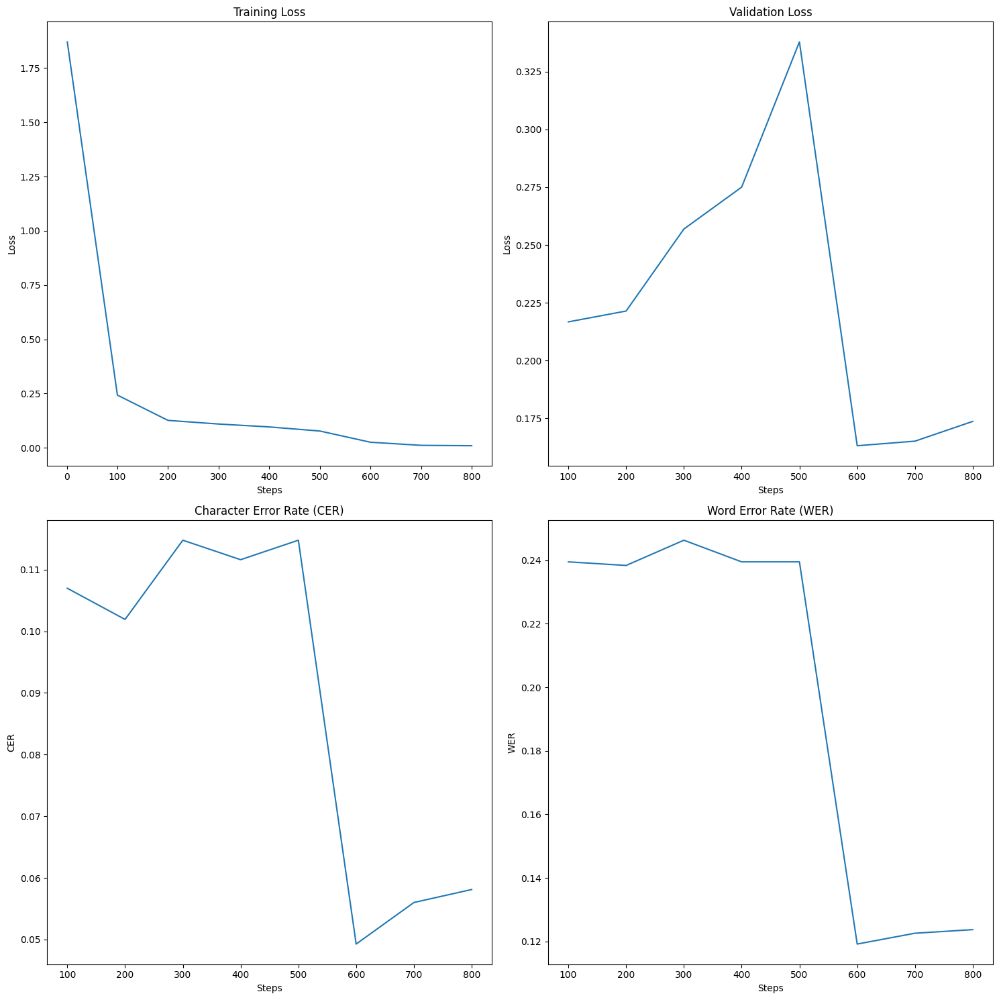

<Figure size 640x480 with 0 Axes>

In [ ]:
import matplotlib.pyplot as plt

def plot_training_results(trainer):
    # Extract the training history
    history = trainer.state.log_history

    # Separate data into different lists
    train_loss = []
    eval_loss = []
    eval_cer = []
    eval_wer = []
    steps = []

    for entry in history:
        if 'loss' in entry:
            train_loss.append(entry['loss'])
            steps.append(entry['step'])
        elif 'eval_loss' in entry:
            eval_loss.append(entry['eval_loss'])
            eval_cer.append(entry['eval_cer'])
            eval_wer.append(entry['eval_wer'])

    # Create a figure with 2 rows and 2 columns
    fig, axs = plt.subplots(2, 2, figsize=(15, 15))

    # Plot training loss
    axs[0, 0].plot(steps, train_loss)
    axs[0, 0].set_title('Training Loss')
    axs[0, 0].set_xlabel('Steps')
    axs[0, 0].set_ylabel('Loss')

    # Plot validation loss
    eval_steps = [step for step in steps if step % trainer.args.eval_steps == 0]
    axs[0, 1].plot(eval_steps, eval_loss)
    axs[0, 1].set_title('Validation Loss')
    axs[0, 1].set_xlabel('Steps')
    axs[0, 1].set_ylabel('Loss')

    # Plot CER
    axs[1, 0].plot(eval_steps, eval_cer)
    axs[1, 0].set_title('Character Error Rate (CER)')
    axs[1, 0].set_xlabel('Steps')
    axs[1, 0].set_ylabel('CER')

    # Plot WER
    axs[1, 1].plot(eval_steps, eval_wer)
    axs[1, 1].set_title('Word Error Rate (WER)')
    axs[1, 1].set_xlabel('Steps')
    axs[1, 1].set_ylabel('WER')

    # Adjust layout and display the plot
    plt.tight_layout()
    plt.show()

    # Optionally, save the figure
    plt.savefig('training_results.png')

# After training is complete
plot_training_results(trainer)

# Training 7

## Training Stratergy : Initially trained the model for 30 epochs on non augmented data (using pretrained TrOCR weights), and then trained the model for more 30 epochs on augmented data (using initial 30 epoch weights)

In [ ]:
import albumentations as A
import torch
from torch.utils.data import Dataset, DataLoader, random_split
from transformers import TrOCRProcessor, VisionEncoderDecoderModel, Trainer, TrainingArguments, GenerationConfig, EarlyStoppingCallback
from PIL import Image
import numpy as np
from torch.nn.utils.rnn import pad_sequence
from torch.optim import AdamW
from torch.optim.lr_scheduler import ReduceLROnPlateau
from datasets import load_metric

# Load the CER and WER metrics
cer_metric = load_metric("cer")
wer_metric = load_metric("wer")

# processor = TrOCRProcessor.from_pretrained("qantev/trocr-large-spanish", do_rescale=False)
# model = VisionEncoderDecoderModel.from_pretrained("qantev/trocr-large-spanish")

def compute_metrics(eval_pred):
    logits, labels = eval_pred
    if isinstance(logits, tuple):
        logits = logits[0]
    predictions = logits.argmax(-1)
    decoded_preds = processor.tokenizer.batch_decode(predictions, skip_special_tokens=True)
    decoded_labels = []
    for label in labels:
        label_filtered = [token for token in label if token != -100]
        decoded_label = processor.tokenizer.decode(label_filtered, skip_special_tokens=True)
        decoded_labels.append(decoded_label)
    cer_score = cer_metric.compute(predictions=decoded_preds, references=decoded_labels)
    wer_score = wer_metric.compute(predictions=decoded_preds, references=decoded_labels)
    return {"cer": cer_score, "wer": wer_score}

class LineDataset(Dataset):
    def __init__(self, processor, model, line_images, texts, target_size=(256, 64), max_length=512, apply_augmentation=False):
        self.line_images = line_images
        self.texts = texts
        self.processor = processor
        self.processor.image_processor.max_length = max_length
        self.processor.tokenizer.model_max_length = max_length
        self.model = model
        self.model.config.max_length = max_length
        self.target_size = target_size
        self.max_length = max_length
        self.apply_augmentation = apply_augmentation

        if apply_augmentation:
            self.transform = A.Compose([
                A.OneOf([
                    A.Rotate(limit=2, p=1.0),
                    A.GaussNoise(var_limit=(10.0, 30.0), p=1.0),
                    A.ElasticTransform(alpha=0.3, sigma=50.0, alpha_affine=0.3, p=1.0),
                    A.OpticalDistortion(distort_limit=0.03, shift_limit=0.03, p=1.0),
                    A.CLAHE(clip_limit=2, tile_grid_size=(4, 4), p=1.0),
                    A.Affine(scale=(0.95, 1.05), translate_percent=(0.01, 0.01), shear=(-2, 2), p=1.0),
                    A.Perspective(scale=(0.01, 0.03), p=1.0),
                    A.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.1, p=1.0),
                    A.GaussianBlur(blur_limit=(3, 7), p=1.0),
                    A.GridDistortion(num_steps=3, distort_limit=0.02, p=1.0),
                    A.HueSaturationValue(hue_shift_limit=10, sat_shift_limit=10, val_shift_limit=10, p=1.0),
                    A.MedianBlur(blur_limit=3, p=1.0)
                ], p=1.0),
            ])
        else:
            self.transform = A.Compose([])

    def __len__(self):
        return len(self.line_images)

    def __getitem__(self, idx):
        image = self.line_images[idx]
        text = self.texts[idx]

        # Convert image to numpy array and ensure it has 3 dimensions
        if isinstance(image, Image.Image):
            image = np.array(image)

        if image.ndim == 2:
            image = np.expand_dims(image, axis=-1)  # Add a channel dimension if it's missing
            image = np.repeat(image, 3, axis=-1)   # Repeat the single channel to create 3 channels

        image = (image * 255).astype(np.uint8)

        # Apply augmentations
        if self.apply_augmentation:
            augmented = self.transform(image=image)
            image = augmented['image']

        # Convert image to PIL for resizing
        image = Image.fromarray(image)

        # Resize image
        image = image.resize(self.target_size, Image.BILINEAR)

        # Convert image back to numpy array
        image = np.array(image) / 255.0

        # Ensure the image has shape (3, height, width)
        image = np.transpose(image, (2, 0, 1))

        encoding = self.processor(images=image, text=text, return_tensors="pt")

        # Truncate labels if they exceed the maximum length
        encoding['labels'] = encoding['labels'][:, :self.max_length]

        encoding = {k: v.squeeze() for k, v in encoding.items()}
        return encoding

def collate_fn(batch):
    pixel_values = torch.stack([item['pixel_values'] for item in batch])
    labels = pad_sequence([item['labels'] for item in batch], batch_first=True, padding_value=-100)
    return {'pixel_values': pixel_values, 'labels': labels}

def train_transformer_model(line_images, texts, target_size=(256, 64), batch_size=8, max_length=512, val_split=0.1):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    processor = TrOCRProcessor.from_pretrained("qantev/trocr-large-spanish", do_rescale=False)
    model = VisionEncoderDecoderModel.from_pretrained("qantev/trocr-large-spanish")
    generation_config = GenerationConfig.from_pretrained("generation_config_5")

    dataset = LineDataset(processor, model, line_images, texts, target_size, max_length, apply_augmentation=False)

    val_size = int(len(dataset) * val_split)
    train_size = len(dataset) - val_size
    train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

    model = dataset.model.to(device)

    training_args = TrainingArguments(
        output_dir="./results",
        num_train_epochs=30,
        per_device_train_batch_size=batch_size,
        per_device_eval_batch_size=batch_size,
        logging_dir="./logs",
        logging_steps=50,
        save_steps=50,
        save_total_limit=2,
        evaluation_strategy="steps",
        eval_steps=50,
        learning_rate=5e-5,
        weight_decay=0.01,
        load_best_model_at_end=True,
        metric_for_best_model="cer",
        greater_is_better=False,
        logging_first_step=True,
        gradient_accumulation_steps=32,
        fp16=True,
        report_to="all"
    )

    optimizer = AdamW(model.parameters(), lr=training_args.learning_rate, weight_decay=training_args.weight_decay)

    scheduler = ReduceLROnPlateau(
        optimizer,
        mode='min',
        factor=0.1,
        patience=2,
        verbose=True
    )

    trainer = Trainer(
        model=model,
        args=training_args,
        train_dataset=train_dataset,
        eval_dataset=val_dataset,
        data_collator=collate_fn,
        optimizers=(optimizer, scheduler),
        callbacks=[EarlyStoppingCallback(early_stopping_patience=4)],
        compute_metrics=compute_metrics
    )

    trainer.train()

    model.save_pretrained("finetuned_transformer_model7")
    processor.save_pretrained("finetuned_transformer_model7")

    return trainer


<ipython-input-12-c94298191ea5>:13: FutureWarning: load_metric is deprecated and will be removed in the next major version of datasets. Use 'evaluate.load' instead, from the new library 🤗 Evaluate: https://huggingface.co/docs/evaluate
  cer_metric = load_metric("cer")


The repository for cer contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/cer.
You can avoid this prompt in future by passing the argument `trust_remote_code=True`.

Do you wish to run the custom code? [y/N] y


The repository for wer contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/wer.
You can avoid this prompt in future by passing the argument `trust_remote_code=True`.

Do you wish to run the custom code? [y/N] y


In [ ]:
line_images = []
texts = []
for page_data in aligned_data.values():
    for line_img, text in page_data:
        line_images.append(line_img)
        texts.append(text)

trainer= train_transformer_model(line_images, texts, target_size=(256, 64), batch_size=2, max_length=512,val_split=0.15)

/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Step,Training Loss,Validation Loss,Cer,Wer
50,0.419800,0.402111,0.059122,0.146863
100,0.176600,0.347040,0.056018,0.138745
150,0.124200,0.351198,0.055454,0.136531
200,0.112400,0.300694,0.049245,0.135793
250,0.089100,0.343386,0.062932,0.157934
300,0.074800,0.355267,0.054607,0.132841
350,0.078300,0.411433,0.063638,0.157196
400,0.022900,0.328716,0.046564,0.114391
450,0.004400,0.330929,0.044165,0.109963


Some non-default generation parameters are set in the model config. These should go into a GenerationConfig file (https://huggingface.co/docs/transformers/generation_strategies#save-a-custom-decoding-strategy-with-your-model) instead. This warning will be raised to an exception in v4.41.
Non-default generation parameters: {'max_length': 512, 'no_repeat_ngram_size': 3}
Your generation config was originally created from the model config, but the model config has changed since then. Unless you pass the `generation_config` argument to this model's `generate` calls, they will revert to the legacy behavior where the base `generate` parameterization is loaded from the model config instead. To avoid this behavior and this warning, we recommend you to overwrite the generation config model attribute before calling the model's `save_pretrained`, preferably also removing any generation kwargs from the model config. This warning will be raised to an exception in v4.41.
Some non-default generation p

In [ ]:
# test

In [ ]:
! cp -r /content/drive/MyDrive/finetuned_transformer_model7 /content/finetuned_transformer_model7

In [ ]:
import torch
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
from nltk.translate.bleu_score import sentence_bleu, corpus_bleu
from jiwer import wer
import jiwer

def evaluating_model(line_images, texts, target_size=(256, 64), batch_size=2):
    # device = torch.device('cpu')
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    model_path = "./finetuned_transformer_model7"
    processor_path = "./finetuned_transformer_model7"

    processor = TrOCRProcessor.from_pretrained(processor_path)
    model = VisionEncoderDecoderModel.from_pretrained(model_path)

    dataset = LineDataset(processor, model, line_images, texts, target_size,apply_augmentation=False)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False, collate_fn=collate_fn)
    model = dataset.model.to(device)
    model.eval()
    total_loss = 0
    num_batches = 0

    cer_scores = []
    wer_scores = []
    bleu_scores = []
    text = []

    with torch.no_grad():
        for batch in dataloader:
            pixel_values = batch["pixel_values"].to(device)

            # Generate predictions
            generated_ids = model.generate(pixel_values)
            generated_texts = dataset.processor.batch_decode(generated_ids, skip_special_tokens=True)

            # Calculate CER and WER for each prediction
            for i in range(len(generated_texts)):
                gt = texts[num_batches * batch_size + i]
                pred = generated_texts[i]

                # Calculate CER
                cer = jiwer.wer(gt, pred) / len(gt)
                cer_scores.append(cer)

                # Calculate WER
                wer_score = wer(gt, pred)
                wer_scores.append(wer_score)

                # Calculate BLEU score
                bleu_score = sentence_bleu([gt.split()], pred.split())
                bleu_scores.append(bleu_score)

                # Display image and predictions
                image = line_images[num_batches * batch_size + i]
                plt.figure(figsize=(8, 6))
                plt.imshow(image, cmap='gray')
                plt.title(f"Target: {gt}\nPrediction: {pred}")
                plt.axis('off')
                plt.show()
                print("="*50)
                text.append(pred)

            num_batches += 1

    avg_cer = sum(cer_scores) / len(cer_scores) if cer_scores else 0
    avg_wer = sum(wer_scores) / len(wer_scores) if wer_scores else 0
    avg_bleu = sum(bleu_scores) / len(bleu_scores) if bleu_scores else 0

    print(f"Average CER: {avg_cer:.4f}")
    print(f"Average WER: {avg_wer:.4f}")
    print(f"Average BLEU: {avg_bleu:.4f}")
    print("Evaluation completed.")

    for i, pred in enumerate(text):
        print(f"{i+1} : {pred}")



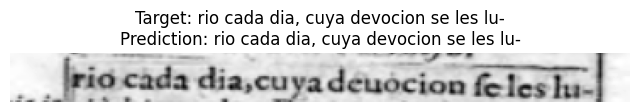

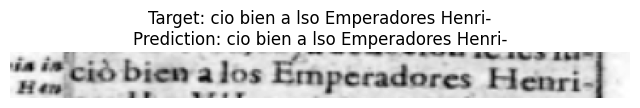

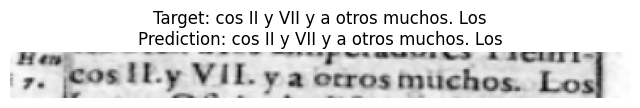

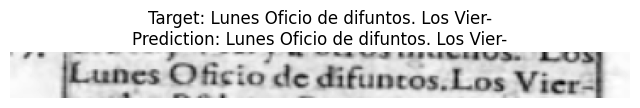

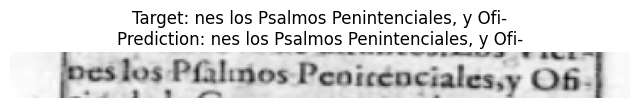

...

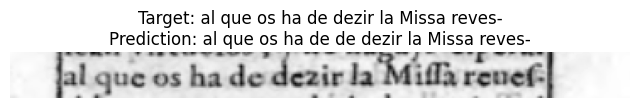

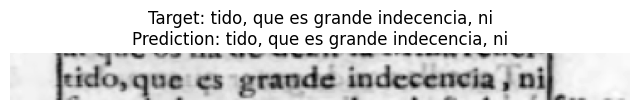

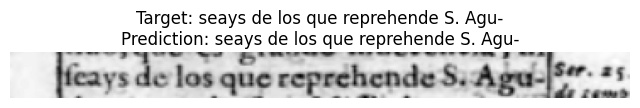

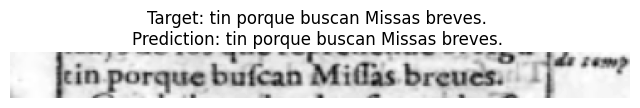

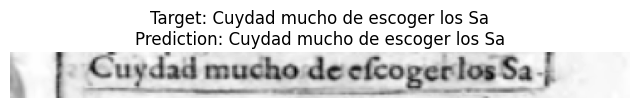

Average CER: 0.0003
Average WER: 0.0101
Average BLEU: 0.9118
Evaluation completed.
1 : rio cada dia, cuya devocion se les lu-
2 : cio bien a lso Emperadores Henri-
3 : cos II y VII y a otros muchos. Los
4 : Lunes Oficio de difuntos. Los Vier-
5 : nes los Psalmos Penintenciales, y Ofi-
6 : cio de la Cruz, y un rato de oracion,
7 : procurad no perderle, pensando en
8 : clesin para que suystes criado, y si
9 : cumplis con las obligacioens de
10 : Christiano, y de vuestro Estado, que
11 : el Emperador Carlos Quinto ocu-
12 : pava cada dia dos hora en este
13 : exercicio, en medio de sus grandes
14 : negocios, conociendo ser el mas im-
15 : portante. 
16 : Cada noche hazed cuentas con
17 : Dios, y examen de vuestra concien-
18 : cia, pues no sabeys si amanecereys 
19 : en el otro mundo, como sucedió a 
20 : muchos. 
21 : La quaresma, y Semana Santa, 
22 : mostrad con particularidad, que
23 : soys Christiano, celebrando con
24 : vestido (siempre negro) y semblante
25 : que proceda de vivo se

In [ ]:
test_line_images = '/content/test_images/P1-16'

aligned_data = {}
aligned_data['/content/image_folder1/Padilla - 1_page_16.png'] = align_segments_with_transcriptions('/content/image_folder1/Padilla - 1_page_16.png', test_line_images, transcript['/content/image_folder1/Padilla - 1_page_16.png'])

test_line_img = []
test_texts = []
for page_data in aligned_data.values():
    for line_img, text in page_data:
        test_line_img.append(line_img)
        test_texts.append(text)

evaluating_model(test_line_img, test_texts, target_size=(256, 64), batch_size=2)

In [ ]:
# v2

In [ ]:
import albumentations as A
import torch
from torch.utils.data import Dataset, DataLoader, random_split
from transformers import TrOCRProcessor, VisionEncoderDecoderModel, Trainer, TrainingArguments, GenerationConfig, EarlyStoppingCallback
from PIL import Image
import numpy as np
from torch.nn.utils.rnn import pad_sequence
from torch.optim import AdamW
from torch.optim.lr_scheduler import ReduceLROnPlateau
from datasets import load_metric

# Load the CER and WER metrics
cer_metric = load_metric("cer")
wer_metric = load_metric("wer")
# model_path = "./finetuned_transformer_model7"
# processor_path = "./finetuned_transformer_model7"

# processor = TrOCRProcessor.from_pretrained(processor_path, do_rescale=False)
# model = VisionEncoderDecoderModel.from_pretrained(model_path)

def compute_metrics(eval_pred):
    logits, labels = eval_pred
    if isinstance(logits, tuple):
        logits = logits[0]
    predictions = logits.argmax(-1)
    decoded_preds = processor.tokenizer.batch_decode(predictions, skip_special_tokens=True)
    decoded_labels = []
    for label in labels:
        label_filtered = [token for token in label if token != -100]
        decoded_label = processor.tokenizer.decode(label_filtered, skip_special_tokens=True)
        decoded_labels.append(decoded_label)
    cer_score = cer_metric.compute(predictions=decoded_preds, references=decoded_labels)
    wer_score = wer_metric.compute(predictions=decoded_preds, references=decoded_labels)
    return {"cer": cer_score, "wer": wer_score}

class LineDataset(Dataset):
    def __init__(self, processor, model, line_images, texts, target_size=(256, 64), max_length=512, apply_augmentation=False):
        self.line_images = line_images
        self.texts = texts
        self.processor = processor
        self.processor.image_processor.max_length = max_length
        self.processor.tokenizer.model_max_length = max_length
        self.model = model
        self.model.config.max_length = max_length
        self.target_size = target_size
        self.max_length = max_length
        self.apply_augmentation = apply_augmentation

        if apply_augmentation:
            self.transform = A.Compose([
                A.OneOf([
                    A.Rotate(limit=2, p=1.0),
                    A.GaussNoise(var_limit=(10.0, 30.0), p=1.0),
                    A.ElasticTransform(alpha=0.3, sigma=50.0, alpha_affine=0.3, p=1.0),
                    A.OpticalDistortion(distort_limit=0.03, shift_limit=0.03, p=1.0),
                    A.CLAHE(clip_limit=2, tile_grid_size=(4, 4), p=1.0),
                    A.Affine(scale=(0.95, 1.05), translate_percent=(0.01, 0.01), shear=(-2, 2), p=1.0),
                    A.Perspective(scale=(0.01, 0.03), p=1.0),
                    A.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.1, p=1.0),
                    A.GaussianBlur(blur_limit=(3, 7), p=1.0),
                    A.GridDistortion(num_steps=3, distort_limit=0.02, p=1.0),
                    A.HueSaturationValue(hue_shift_limit=10, sat_shift_limit=10, val_shift_limit=10, p=1.0),
                    A.MedianBlur(blur_limit=3, p=1.0)
                ], p=1.0),
            ])
        else:
            self.transform = A.Compose([])

    def __len__(self):
        return len(self.line_images)

    def __getitem__(self, idx):
        image = self.line_images[idx]
        text = self.texts[idx]

        # Convert image to numpy array and ensure it has 3 dimensions
        if isinstance(image, Image.Image):
            image = np.array(image)

        if image.ndim == 2:
            image = np.expand_dims(image, axis=-1)  # Add a channel dimension if it's missing
            image = np.repeat(image, 3, axis=-1)   # Repeat the single channel to create 3 channels

        image = (image * 255).astype(np.uint8)

        # Apply augmentations
        if self.apply_augmentation:
            augmented = self.transform(image=image)
            image = augmented['image']

        # Convert image to PIL for resizing
        image = Image.fromarray(image)

        # Resize image
        image = image.resize(self.target_size, Image.BILINEAR)

        # Convert image back to numpy array
        image = np.array(image) / 255.0

        # Ensure the image has shape (3, height, width)
        image = np.transpose(image, (2, 0, 1))

        encoding = self.processor(images=image, text=text, return_tensors="pt")

        # Truncate labels if they exceed the maximum length
        encoding['labels'] = encoding['labels'][:, :self.max_length]

        encoding = {k: v.squeeze() for k, v in encoding.items()}
        return encoding

def collate_fn(batch):
    pixel_values = torch.stack([item['pixel_values'] for item in batch])
    labels = pad_sequence([item['labels'] for item in batch], batch_first=True, padding_value=-100)
    return {'pixel_values': pixel_values, 'labels': labels}

def train_transformer_model(line_images, texts, target_size=(256, 64), batch_size=8, max_length=512, val_split=0.1):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    model_path = "./finetuned_transformer_model7"
    processor_path = "./finetuned_transformer_model7"

    processor = TrOCRProcessor.from_pretrained(processor_path, do_rescale=False)
    model = VisionEncoderDecoderModel.from_pretrained(model_path)
    generation_config = GenerationConfig.from_pretrained("generation_config_5")

    dataset = LineDataset(processor, model, line_images, texts, target_size, max_length, apply_augmentation=True)

    val_size = int(len(dataset) * val_split)
    train_size = len(dataset) - val_size
    train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

    model = dataset.model.to(device)

    training_args = TrainingArguments(
        output_dir="./results",
        num_train_epochs=30,
        per_device_train_batch_size=batch_size,
        per_device_eval_batch_size=batch_size,
        logging_dir="./logs",
        logging_steps=100,
        save_steps=100,
        save_total_limit=2,
        evaluation_strategy="steps",
        eval_steps=100,
        learning_rate=3e-5,
        weight_decay=0.01,
        load_best_model_at_end=True,
        metric_for_best_model="cer",
        greater_is_better=False,
        logging_first_step=True,
        gradient_accumulation_steps=32,
        fp16=True,
        report_to="all"
    )

    optimizer = AdamW(model.parameters(), lr=training_args.learning_rate, weight_decay=training_args.weight_decay)

    scheduler = ReduceLROnPlateau(
        optimizer,
        mode='min',
        factor=0.1,
        patience=2,
        verbose=True
    )

    trainer = Trainer(
        model=model,
        args=training_args,
        train_dataset=train_dataset,
        eval_dataset=val_dataset,
        data_collator=collate_fn,
        optimizers=(optimizer, scheduler),
        callbacks=[EarlyStoppingCallback(early_stopping_patience=4)],
        compute_metrics=compute_metrics
    )

    trainer.train()

    model.save_pretrained("finetuned_transformer_model7v2")
    processor.save_pretrained("finetuned_transformer_model7v2")

    return trainer


In [ ]:
line_images = []
texts = []
for page_data in aligned_data.values():
    for line_img, text in page_data:
        line_images.append(line_img)
        texts.append(text)

trainer= train_transformer_model(line_images, texts, target_size=(256, 64), batch_size=2, max_length=512,val_split=0.1)

/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Step,Training Loss,Validation Loss,Cer,Wer
100,0.060200,0.078895,0.015219,0.042045
200,0.031700,0.089184,0.015642,0.037500


Some non-default generation parameters are set in the model config. These should go into a GenerationConfig file (https://huggingface.co/docs/transformers/generation_strategies#save-a-custom-decoding-strategy-with-your-model) instead. This warning will be raised to an exception in v4.41.
Non-default generation parameters: {'max_length': 512, 'no_repeat_ngram_size': 3}
Your generation config was originally created from the model config, but the model config has changed since then. Unless you pass the `generation_config` argument to this model's `generate` calls, they will revert to the legacy behavior where the base `generate` parameterization is loaded from the model config instead. To avoid this behavior and this warning, we recommend you to overwrite the generation config model attribute before calling the model's `save_pretrained`, preferably also removing any generation kwargs from the model config. This warning will be raised to an exception in v4.41.
Some non-default generation p

Step,Training Loss,Validation Loss,Cer,Wer
100,0.060200,0.078895,0.015219,0.042045
200,0.031700,0.089184,0.015642,0.037500
300,0.029400,0.118077,0.016064,0.043182
400,0.021200,0.125620,0.025576,0.060227
500,0.008300,0.103175,0.023040,0.053409


Some non-default generation parameters are set in the model config. These should go into a GenerationConfig file (https://huggingface.co/docs/transformers/generation_strategies#save-a-custom-decoding-strategy-with-your-model) instead. This warning will be raised to an exception in v4.41.
Non-default generation parameters: {'max_length': 512, 'no_repeat_ngram_size': 3}
Your generation config was originally created from the model config, but the model config has changed since then. Unless you pass the `generation_config` argument to this model's `generate` calls, they will revert to the legacy behavior where the base `generate` parameterization is loaded from the model config instead. To avoid this behavior and this warning, we recommend you to overwrite the generation config model attribute before calling the model's `save_pretrained`, preferably also removing any generation kwargs from the model config. This warning will be raised to an exception in v4.41.
Some non-default generation p

In [ ]:
# test

In [ ]:
! cp -r /content/drive/MyDrive/finetuned_transformer_model7v2 /content/finetuned_transformer_model7v2

In [ ]:
import torch
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
from nltk.translate.bleu_score import sentence_bleu, corpus_bleu
from jiwer import wer
import jiwer

def evaluating_model(line_images, texts, target_size=(256, 64), batch_size=2):
    # device = torch.device('cpu')
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    model_path = "./finetuned_transformer_model7v2"
    processor_path = "./finetuned_transformer_model7v2"

    processor = TrOCRProcessor.from_pretrained(processor_path)
    model = VisionEncoderDecoderModel.from_pretrained(model_path)

    dataset = LineDataset(processor, model, line_images, texts, target_size,apply_augmentation=False)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False, collate_fn=collate_fn)
    model = dataset.model.to(device)
    model.eval()
    total_loss = 0
    num_batches = 0

    cer_scores = []
    wer_scores = []
    bleu_scores = []

    with torch.no_grad():
        for batch in dataloader:
            pixel_values = batch["pixel_values"].to(device)

            # Generate predictions
            generated_ids = model.generate(pixel_values)
            generated_texts = dataset.processor.batch_decode(generated_ids, skip_special_tokens=True)

            # Calculate CER and WER for each prediction
            for i in range(len(generated_texts)):
                gt = texts[num_batches * batch_size + i]
                pred = generated_texts[i]

                # Calculate CER
                cer = jiwer.wer(gt, pred) / len(gt)
                cer_scores.append(cer)

                # Calculate WER
                wer_score = wer(gt, pred)
                wer_scores.append(wer_score)

                # Calculate BLEU score
                bleu_score = sentence_bleu([gt.split()], pred.split())
                bleu_scores.append(bleu_score)

                # Display image and predictions
                image = line_images[num_batches * batch_size + i]
                plt.figure(figsize=(8, 6))
                plt.imshow(image, cmap='gray')
                plt.title(f"Target: {gt}\nPrediction: {pred}")
                plt.axis('off')
                plt.show()
                print("="*50)

            num_batches += 1

    avg_cer = sum(cer_scores) / len(cer_scores) if cer_scores else 0
    avg_wer = sum(wer_scores) / len(wer_scores) if wer_scores else 0
    avg_bleu = sum(bleu_scores) / len(bleu_scores) if bleu_scores else 0

    print(f"Average CER: {avg_cer:.4f}")
    print(f"Average WER: {avg_wer:.4f}")
    print(f"Average BLEU: {avg_bleu:.4f}")
    print("Evaluation completed.")


/usr/local/lib/python3.10/dist-packages/transformers/generation/utils.py:1376: UserWarning: You have modified the pretrained model configuration to control generation. This is a deprecated strategy to control generation and will be removed soon, in a future version. Please use and modify the model generation configuration (see https://huggingface.co/docs/transformers/generation_strategies#default-text-generation-configuration )
  warnings.warn(


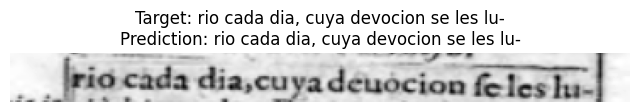

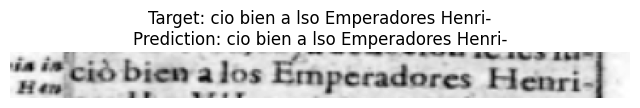

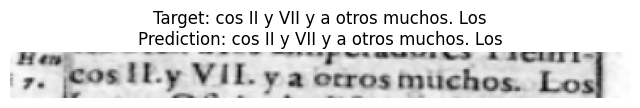

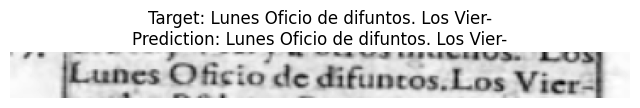

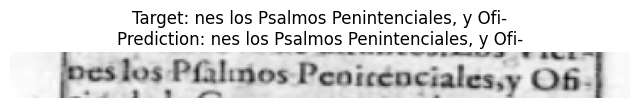

...

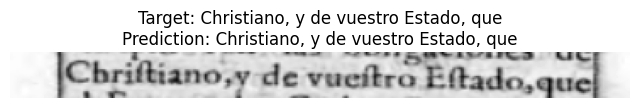

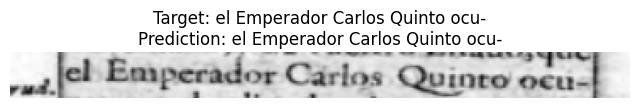

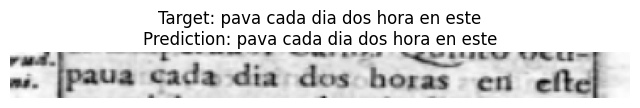

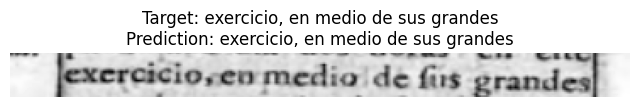

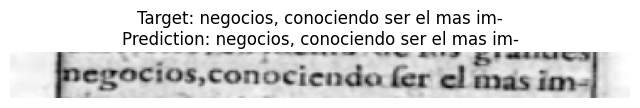

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_

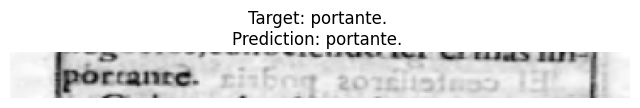

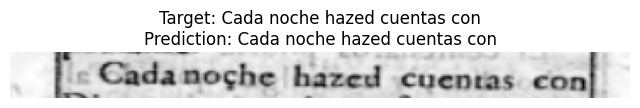

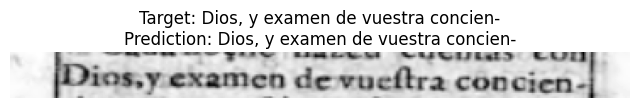

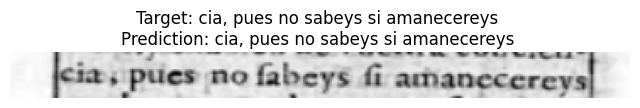

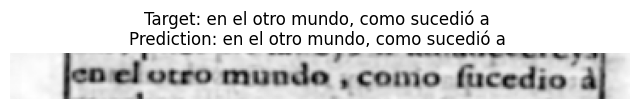

...

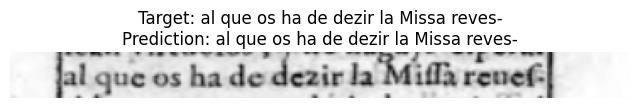

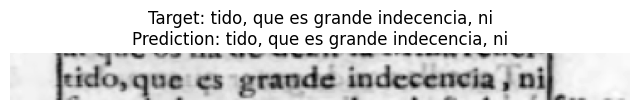

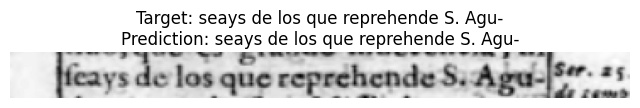

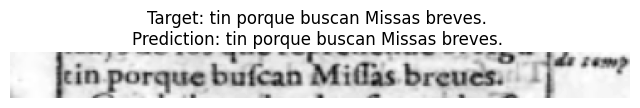

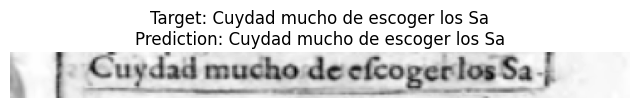

Average CER: 0.0000
Average WER: 0.0000
Average BLEU: 0.9375
Evaluation completed.


In [ ]:
test_line_images = '/content/test_images/P1-16'

aligned_data = {}
aligned_data['/content/image_folder1/Padilla - 1_page_16.png'] = align_segments_with_transcriptions('/content/image_folder1/Padilla - 1_page_16.png', test_line_images, transcript['/content/image_folder1/Padilla - 1_page_16.png'])

test_line_img = []
test_texts = []
for page_data in aligned_data.values():
    for line_img, text in page_data:
        test_line_img.append(line_img)
        test_texts.append(text)

evaluating_model(test_line_img, test_texts, target_size=(256, 64), batch_size=2)

# Training 6

### Using weights from Training 5v3 (trained on augmented data) and training the model for 15 epochs on non augmented data and changed scheduler

In [ ]:
! cp -r /content/drive/MyDrive/finetuned_transformer_model5v3 /content/finetuned_transformer_model5v3

In [ ]:
import albumentations as A
import torch
from torch.utils.data import Dataset, DataLoader, random_split
from transformers import TrOCRProcessor, VisionEncoderDecoderModel, Trainer, TrainingArguments, GenerationConfig, EarlyStoppingCallback
from PIL import Image
import numpy as np
from torch.nn.utils.rnn import pad_sequence
from torch.optim import AdamW
from torch.optim.lr_scheduler import ReduceLROnPlateau
from datasets import load_metric

# Load the CER and WER metrics
cer_metric = load_metric("cer")
wer_metric = load_metric("wer")

# model_path = "./finetuned_transformer_model5v3"
# processor_path = "./finetuned_transformer_model5v3"

# processor = TrOCRProcessor.from_pretrained(processor_path, do_rescale=False)
# model = VisionEncoderDecoderModel.from_pretrained(model_path)

def compute_metrics(eval_pred):
    logits, labels = eval_pred

    # Extract the logits from the tuple if necessary
    if isinstance(logits, tuple):
        logits = logits[0]

    # Convert logits to the most likely token IDs
    predictions = logits.argmax(-1)

    # Decode predictions to text
    decoded_preds = processor.tokenizer.batch_decode(predictions, skip_special_tokens=True)

    # Prepare labels for decoding
    decoded_labels = []
    for label in labels:
        # Filter out -100 values which are used for padding/ignored indices
        label_filtered = [token for token in label if token != -100]
        decoded_label = processor.tokenizer.decode(label_filtered, skip_special_tokens=True)
        decoded_labels.append(decoded_label)

    # Compute CER and WER using the loaded metrics
    cer_score = cer_metric.compute(predictions=decoded_preds, references=decoded_labels)
    wer_score = wer_metric.compute(predictions=decoded_preds, references=decoded_labels)

    return {"cer": cer_score, "wer": wer_score}



class LineDataset(Dataset):
    def __init__(self, processor, model, line_images, texts, target_size=(256, 64), max_length=512, apply_augmentation=False):
        self.line_images = line_images
        self.texts = texts
        self.processor = processor
        self.processor.image_processor.max_length = max_length
        self.processor.tokenizer.model_max_length = max_length
        self.model = model
        self.model.config.max_length = max_length
        self.target_size = target_size
        self.max_length = max_length
        self.apply_augmentation = apply_augmentation

        if apply_augmentation:
            self.transform = A.Compose([
                A.OneOf([
                    A.Rotate(limit=2, p=1.0),
                    A.GaussNoise(var_limit=(5.0, 10.0), p=1.0),
                    A.ElasticTransform(alpha=0.2, sigma=50.0, alpha_affine=0.2, p=1.0),
                    A.OpticalDistortion(distort_limit=0.02, shift_limit=0.02, p=1.0),
                    A.CLAHE(clip_limit=2, tile_grid_size=(4, 4), p=1.0),
                    A.Affine(scale=(0.95, 1.05), translate_percent=(0.01, 0.01), shear=(-2, 2), p=1.0),
                    A.Perspective(scale=(0.01, 0.03), p=1.0),
                    A.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.1, p=1.0),
                    A.GaussianBlur(blur_limit=(3, 5), p=1.0),
                    A.GridDistortion(num_steps=3, distort_limit=0.02, p=1.0),
                    A.HueSaturationValue(hue_shift_limit=10, sat_shift_limit=10, val_shift_limit=10, p=1.0),
                    A.MedianBlur(blur_limit=3, p=1.0)
                ], p=1.0),

            ])
        else:
            self.transform = A.Compose([
            ])

    def __len__(self):
        return len(self.line_images)

    def __getitem__(self, idx):
        image = self.line_images[idx]
        text = self.texts[idx]

        # Convert image to numpy array and ensure it has 3 dimensions
        if isinstance(image, Image.Image):
            image = np.array(image)

        if image.ndim == 2:
            image = np.expand_dims(image, axis=-1)  # Add a channel dimension if it's missing
            image = np.repeat(image, 3, axis=-1)   # Repeat the single channel to create 3 channels

        image = (image * 255).astype(np.uint8)

        # Apply augmentations
        if self.apply_augmentation:
            augmented = self.transform(image=image)
            image = augmented['image']

        # Convert image to PIL for resizing
        image = Image.fromarray(image)

        # Resize image
        image = image.resize(self.target_size, Image.BILINEAR)

        # Convert image back to numpy array
        image = np.array(image) / 255.0

        # Ensure the image has shape (3, height, width)
        image = np.transpose(image, (2, 0, 1))

        encoding = self.processor(images=image, text=text, return_tensors="pt")

        # Truncate labels if they exceed the maximum length
        encoding['labels'] = encoding['labels'][:, :self.max_length]

        encoding = {k: v.squeeze() for k, v in encoding.items()}
        return encoding

def collate_fn(batch):
    pixel_values = torch.stack([item['pixel_values'] for item in batch])
    labels = pad_sequence([item['labels'] for item in batch], batch_first=True, padding_value=-100)
    return {'pixel_values': pixel_values, 'labels': labels}

def train_transformer_model(line_images, texts, target_size=(256, 64), batch_size=8, max_length=512, val_split=0.1):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    model_path = "./finetuned_transformer_model5v3"
    processor_path = "./finetuned_transformer_model5v3"

    processor = TrOCRProcessor.from_pretrained(processor_path, do_rescale=False)
    model = VisionEncoderDecoderModel.from_pretrained(model_path)

    generation_config = GenerationConfig.from_pretrained("generation_config_5")

    dataset = LineDataset(processor, model, line_images, texts, target_size, max_length, apply_augmentation=False)

    # Split the dataset into training and validation datasets
    val_size = int(len(dataset) * val_split)
    train_size = len(dataset) - val_size
    train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

    # Create the model
    model = dataset.model.to(device)

    training_args = TrainingArguments(
        output_dir="./results",
        num_train_epochs=15,
        per_device_train_batch_size=batch_size,
        per_device_eval_batch_size=batch_size,
        logging_dir="./logs",
        logging_steps=100,
        save_steps=100,
        save_total_limit=2,
        evaluation_strategy="steps",
        eval_steps=100,
        learning_rate=3e-5,
        weight_decay=0.01,
        load_best_model_at_end=True,
        metric_for_best_model="cer",
        greater_is_better=False,
        logging_first_step=True,
        gradient_accumulation_steps=16,
        fp16=True,
        report_to="all"
    )

    optimizer = AdamW(model.parameters(), lr=training_args.learning_rate, weight_decay=training_args.weight_decay)

    scheduler = ReduceLROnPlateau(
        optimizer,
        mode='min',
        factor=0.1,
        patience=2,
        verbose=True
    )

    trainer = Trainer(
        model=model,
        args=training_args,
        train_dataset=train_dataset,
        eval_dataset=val_dataset,
        data_collator=collate_fn,
        optimizers=(optimizer, scheduler),
        callbacks=[EarlyStoppingCallback(early_stopping_patience=2)],
        compute_metrics=compute_metrics  # Ensure metrics are computed
    )

    trainer.train()

    model.save_pretrained("finetuned_transformer_model6")
    processor.save_pretrained("finetuned_transformer_model6")

In [ ]:
line_images = []
texts = []
for page_data in aligned_data.values():
    for line_img, text in page_data:
        line_images.append(line_img)
        texts.append(text)

train_transformer_model(line_images, texts, target_size=(256, 64), batch_size=2, max_length=512,val_split=0.2)

/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Step,Training Loss,Validation Loss,Cer,Wer
100,0.446700,0.518430,0.135631,0.184071
200,0.239100,0.587081,0.119726,0.189971
300,0.133900,0.591195,0.128672,0.192920
400,0.079600,0.690460,0.117296,0.186431


Some non-default generation parameters are set in the model config. These should go into a GenerationConfig file (https://huggingface.co/docs/transformers/generation_strategies#save-a-custom-decoding-strategy-with-your-model) instead. This warning will be raised to an exception in v4.41.
Non-default generation parameters: {'max_length': 512, 'no_repeat_ngram_size': 3}
Your generation config was originally created from the model config, but the model config has changed since then. Unless you pass the `generation_config` argument to this model's `generate` calls, they will revert to the legacy behavior where the base `generate` parameterization is loaded from the model config instead. To avoid this behavior and this warning, we recommend you to overwrite the generation config model attribute before calling the model's `save_pretrained`, preferably also removing any generation kwargs from the model config. This warning will be raised to an exception in v4.41.
Some non-default generation p

In [ ]:
# test

In [ ]:
! cp -r /content/drive/MyDrive/finetuned_transformer_model6 /content/finetuned_transformer_model6

In [ ]:
import torch
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
from nltk.translate.bleu_score import sentence_bleu, corpus_bleu
from jiwer import wer
import jiwer

def evaluating_model(line_images, texts, target_size=(256, 64), batch_size=2):
    # device = torch.device('cpu')
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    model_path = "./finetuned_transformer_model6"
    processor_path = "./finetuned_transformer_model6"

    processor = TrOCRProcessor.from_pretrained(processor_path)
    model = VisionEncoderDecoderModel.from_pretrained(model_path)

    dataset = LineDataset(processor, model, line_images, texts, target_size,apply_augmentation=False)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False, collate_fn=collate_fn)
    model = dataset.model.to(device)
    model.eval()
    total_loss = 0
    num_batches = 0

    cer_scores = []
    wer_scores = []
    bleu_scores = []

    with torch.no_grad():
        for batch in dataloader:
            pixel_values = batch["pixel_values"].to(device)

            # Generate predictions
            generated_ids = model.generate(pixel_values)
            generated_texts = dataset.processor.batch_decode(generated_ids, skip_special_tokens=True)

            # Calculate CER and WER for each prediction
            for i in range(len(generated_texts)):
                gt = texts[num_batches * batch_size + i]
                pred = generated_texts[i]

                # Calculate CER
                cer = jiwer.wer(gt, pred) / len(gt)
                cer_scores.append(cer)

                # Calculate WER
                wer_score = wer(gt, pred)
                wer_scores.append(wer_score)

                # Calculate BLEU score
                bleu_score = sentence_bleu([gt.split()], pred.split())
                bleu_scores.append(bleu_score)

                # Display image and predictions
                image = line_images[num_batches * batch_size + i]
                plt.figure(figsize=(8, 6))
                plt.imshow(image, cmap='gray')
                plt.title(f"Target: {gt}\nPrediction: {pred}")
                plt.axis('off')
                plt.show()
                print("="*50)

            num_batches += 1

    avg_cer = sum(cer_scores) / len(cer_scores) if cer_scores else 0
    avg_wer = sum(wer_scores) / len(wer_scores) if wer_scores else 0
    avg_bleu = sum(bleu_scores) / len(bleu_scores) if bleu_scores else 0

    print(f"Average CER: {avg_cer:.4f}")
    print(f"Average WER: {avg_wer:.4f}")
    print(f"Average BLEU: {avg_bleu:.4f}")
    print("Evaluation completed.")


/usr/local/lib/python3.10/dist-packages/transformers/generation/utils.py:1368: UserWarning: You have modified the pretrained model configuration to control generation. This is a deprecated strategy to control generation and will be removed soon, in a future version. Please use and modify the model generation configuration (see https://huggingface.co/docs/transformers/generation_strategies#default-text-generation-configuration )
  warnings.warn(


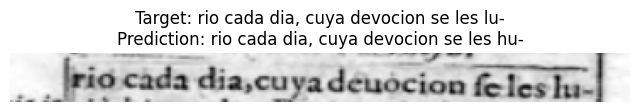

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


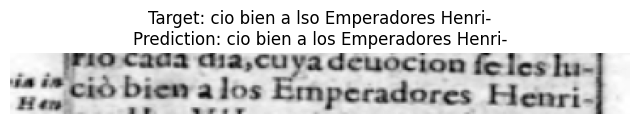

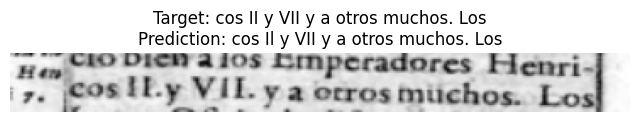

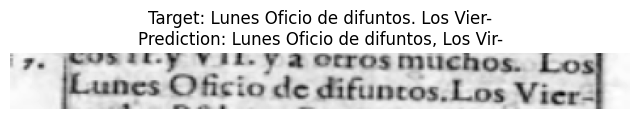

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


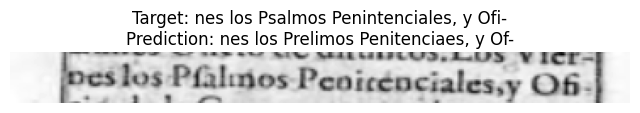

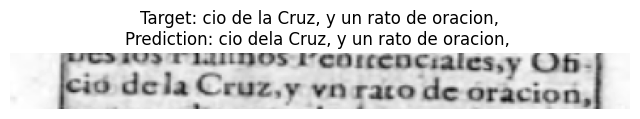

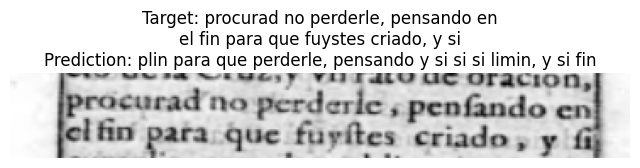

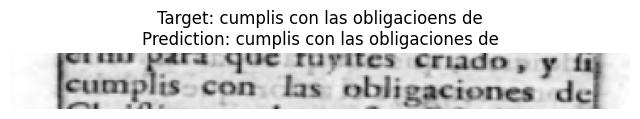

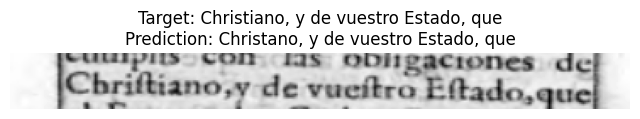

...

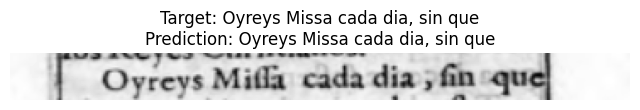

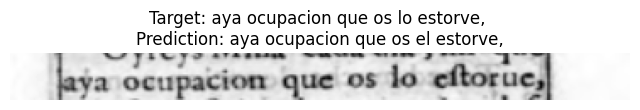

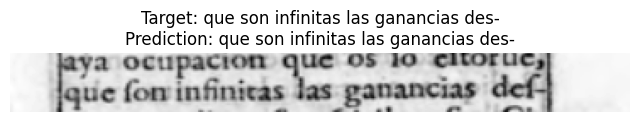

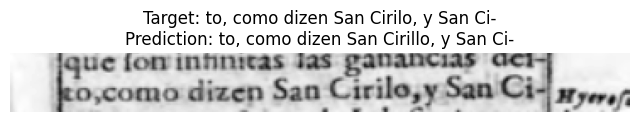

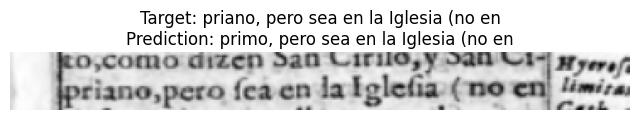

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


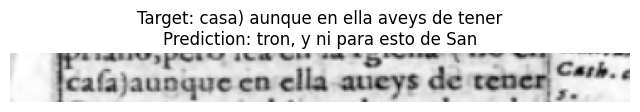

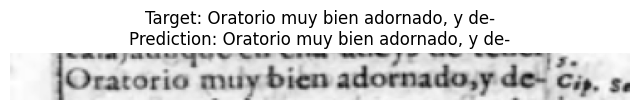

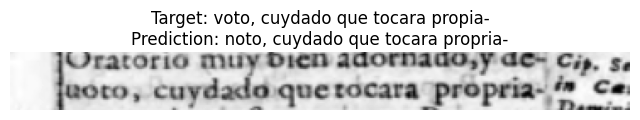

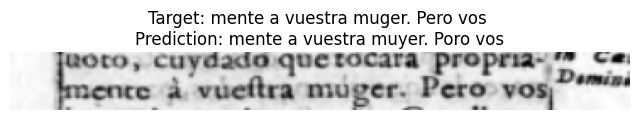

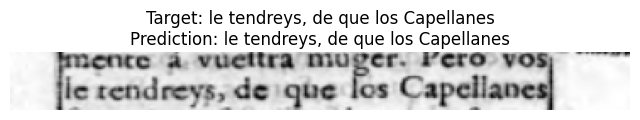

...

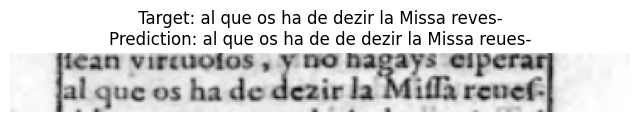

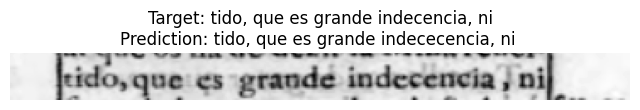

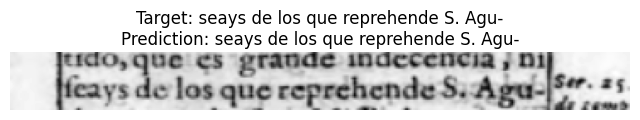

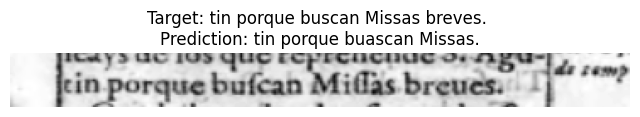

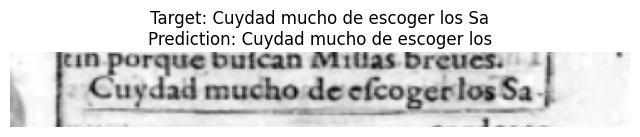

Average CER: 0.0049
Average WER: 0.1789
Average BLEU: 0.5670
Evaluation completed.


In [ ]:
test_line_images = '/content/test_images/P1-16'

aligned_data = {}
aligned_data['/content/image_folder1/Padilla - 1_page_16.png'] = align_segments_with_transcriptions('/content/image_folder1/Padilla - 1_page_16.png', test_line_images, transcript['/content/image_folder1/Padilla - 1_page_16.png'])

test_line_img = []
test_texts = []
for page_data in aligned_data.values():
    for line_img, text in page_data:
        test_line_img.append(line_img)
        test_texts.append(text)

evaluating_model(test_line_img, test_texts, target_size=(256, 64), batch_size=2)

#Training 5

### Training images undergoes random augmentation during each epoch, due to these diverse on the fly computations with a p probability. Also implemented Label smoothening stratergy, to prevent overfitting

In [ ]:
from transformers import GenerationConfig

generation_config = GenerationConfig(
    max_length=512,
    no_repeat_ngram_size=3
)

generation_config.save_pretrained("generation_config_5")

In [ ]:
#v1
import albumentations as A
import torch
from torch.utils.data import Dataset, DataLoader, random_split
from transformers import TrOCRProcessor, VisionEncoderDecoderModel, Trainer, TrainingArguments, GenerationConfig, EarlyStoppingCallback
from PIL import Image
import numpy as np
from torch.nn.utils.rnn import pad_sequence
from torch.optim import AdamW
from torch.optim.lr_scheduler import ReduceLROnPlateau

class LineDataset(Dataset):
    def __init__(self, processor, model, line_images, texts, target_size=(256, 64), max_length=512, apply_augmentation=False):
        self.line_images = line_images
        self.texts = texts
        self.processor = processor
        self.processor.image_processor.max_length = max_length
        self.processor.tokenizer.model_max_length = max_length
        self.model = model
        self.model.config.max_length = max_length
        self.target_size = target_size
        self.max_length = max_length
        self.apply_augmentation = apply_augmentation

        if apply_augmentation:
            self.transform = A.Compose([
                A.OneOf([
                    A.Rotate(limit=2, p=1.0),
                    A.GaussNoise(var_limit=(5.0, 10.0), p=1.0),
                    A.ElasticTransform(alpha=0.1, sigma=50.0, alpha_affine=0.1, p=0.9),
                    A.OpticalDistortion(distort_limit=0.02, shift_limit=0.02, p=1.0),
                    A.CLAHE(clip_limit=2, tile_grid_size=(2, 2), p=1.0),
                    A.Affine(scale=(0.95, 1.05), translate_percent=(0.01, 0.01), shear=(-2, 2), p=0.9),
                    A.Perspective(scale=(0.01, 0.025), p=1.0),
                    A.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.1, p=1.0),
                    A.GaussianBlur(blur_limit=(1, 3), p=1.0),
                    A.GridDistortion(num_steps=3, distort_limit=0.02, p=0.9),
                    A.HueSaturationValue(hue_shift_limit=10, sat_shift_limit=10, val_shift_limit=10, p=1.0),
                    A.MedianBlur(blur_limit=3, p=0.9)
                ], p=0.8),
            ])
        else:
            self.transform = A.Compose([])

    def __len__(self):
        return len(self.line_images)

    def __getitem__(self, idx):
        image = self.line_images[idx]
        text = self.texts[idx]

        # Convert image to numpy array and ensure it has 3 dimensions
        if isinstance(image, Image.Image):
            image = np.array(image)

        if image.ndim == 2:
            image = np.expand_dims(image, axis=-1)  # Add a channel dimension if it's missing
            image = np.repeat(image, 3, axis=-1)   # Repeat the single channel to create 3 channels

        image = (image * 255).astype(np.uint8)

        # Apply augmentations
        if self.apply_augmentation:
            augmented = self.transform(image=image)
            image = augmented['image']

        # Convert image to PIL for resizing
        image = Image.fromarray(image)

        # Resize image
        image = image.resize(self.target_size, Image.BILINEAR)

        # Convert image back to numpy array
        image = np.array(image) / 255.0

        # Ensure the image has shape (3, height, width)
        image = np.transpose(image, (2, 0, 1))

        encoding = self.processor(images=image, text=text, return_tensors="pt")

        encoding = {k: v.squeeze() for k, v in encoding.items()}
        return encoding

def collate_fn(batch):
    pixel_values = torch.stack([item['pixel_values'] for item in batch])
    labels = pad_sequence([item['labels'] for item in batch], batch_first=True, padding_value=-100)
    return {'pixel_values': pixel_values, 'labels': labels}

def train_transformer_model(line_images, texts, target_size=(256, 64), batch_size=8, max_length=512, val_split=0.1):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    processor = TrOCRProcessor.from_pretrained("qantev/trocr-large-spanish", do_rescale=False)
    model = VisionEncoderDecoderModel.from_pretrained("qantev/trocr-large-spanish")

    generation_config = GenerationConfig.from_pretrained("generation_config_5")

    dataset = LineDataset(processor, model, line_images, texts, target_size, max_length, apply_augmentation=True)

    # Split the dataset into training and validation datasets
    val_size = int(len(dataset) * val_split)
    train_size = len(dataset) - val_size
    train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

    # Create the model
    model = dataset.model.to(device)

    training_args = TrainingArguments(
        output_dir="./results",
        num_train_epochs=50,
        per_device_train_batch_size=batch_size,
        per_device_eval_batch_size=batch_size,
        logging_dir="./logs",
        logging_steps=20,
        save_steps=20,
        save_total_limit=2,
        evaluation_strategy="steps",
        eval_steps=20,
        learning_rate= 3e-5,
        weight_decay=0.01,
        load_best_model_at_end=True,
        metric_for_best_model="loss",
        greater_is_better=False,
        logging_first_step=True,
        gradient_accumulation_steps= 64,
        fp16=True,
        report_to="all"
    )

    optimizer = AdamW(model.parameters(), lr=training_args.learning_rate, weight_decay=training_args.weight_decay)

    scheduler = ReduceLROnPlateau(
        optimizer,
        mode='min',
        factor=0.1,
        patience=2,
        verbose=True
    )

    trainer = Trainer(
        model=model,
        args=training_args,
        train_dataset=train_dataset,
        eval_dataset=val_dataset,
        data_collator=collate_fn,
        optimizers=(optimizer, scheduler),
        callbacks=[EarlyStoppingCallback(early_stopping_patience=5)],
    )

    trainer.train()

    model.save_pretrained("finetuned_transformer_model5")
    processor.save_pretrained("finetuned_transformer_model5")


In [ ]:
line_images = []
texts = []
for page_data in aligned_data.values():
    for line_img, text in page_data:
        line_images.append(line_img)
        texts.append(text)

train_transformer_model(line_images, texts, target_size=(256, 64), batch_size=2, max_length=512)


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/364 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/1.38k [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/798k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/2.11M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/957 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.97k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/2.44G [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/420 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Step,Training Loss,Validation Loss
20,0.878400,0.671016
40,0.531100,0.653839
60,0.386500,0.656142
80,0.252600,0.701221
100,0.188100,0.678738
120,0.109300,0.686304
140,0.088300,0.684620


Some non-default generation parameters are set in the model config. These should go into a GenerationConfig file (https://huggingface.co/docs/transformers/generation_strategies#save-a-custom-decoding-strategy-with-your-model) instead. This warning will be raised to an exception in v4.41.
Non-default generation parameters: {'max_length': 512, 'no_repeat_ngram_size': 3}
Your generation config was originally created from the model config, but the model config has changed since then. Unless you pass the `generation_config` argument to this model's `generate` calls, they will revert to the legacy behavior where the base `generate` parameterization is loaded from the model config instead. To avoid this behavior and this warning, we recommend you to overwrite the generation config model attribute before calling the model's `save_pretrained`, preferably also removing any generation kwargs from the model config. This warning will be raised to an exception in v4.41.
Some non-default generation p

In [ ]:
#v2 - Label Smoothening Stratergy
import albumentations as A
import torch
from torch.utils.data import Dataset, DataLoader, random_split
from transformers import TrOCRProcessor, VisionEncoderDecoderModel, Trainer, TrainingArguments, GenerationConfig, EarlyStoppingCallback
from PIL import Image
import numpy as np
from torch.nn.utils.rnn import pad_sequence
from torch.optim import AdamW
from torch.optim.lr_scheduler import ReduceLROnPlateau

class LineDataset(Dataset):
    def __init__(self, processor, model, line_images, texts, target_size=(256, 64), max_length=512, apply_augmentation=False):
        self.line_images = line_images
        self.texts = texts
        self.processor = processor
        self.processor.image_processor.max_length = max_length
        self.processor.tokenizer.model_max_length = max_length
        self.model = model
        self.model.config.max_length = max_length
        self.target_size = target_size
        self.max_length = max_length
        self.apply_augmentation = apply_augmentation

        if apply_augmentation:
            self.transform = A.Compose([
                A.OneOf([
                    A.Rotate(limit=2, p=1.0),
                    A.GaussNoise(var_limit=(5.0, 10.0), p=1.0),
                    A.ElasticTransform(alpha=0.1, sigma=50.0, alpha_affine=0.1, p=0.9),
                    A.OpticalDistortion(distort_limit=0.02, shift_limit=0.02, p=1.0),
                    A.CLAHE(clip_limit=2, tile_grid_size=(2, 2), p=1.0),
                    A.Affine(scale=(0.95, 1.05), translate_percent=(0.01, 0.01), shear=(-2, 2), p=0.9),
                    A.Perspective(scale=(0.01, 0.025), p=1.0),
                    A.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.1, p=1.0),
                    A.GaussianBlur(blur_limit=(1, 3), p=1.0),
                    A.GridDistortion(num_steps=3, distort_limit=0.02, p=0.9),
                    A.HueSaturationValue(hue_shift_limit=10, sat_shift_limit=10, val_shift_limit=10, p=1.0),
                    A.MedianBlur(blur_limit=3, p=0.9)
                ], p=0.8),
            ])
        else:
            self.transform = A.Compose([])

    def __len__(self):
        return len(self.line_images)

    def __getitem__(self, idx):
        image = self.line_images[idx]
        text = self.texts[idx]

        # Convert image to numpy array and ensure it has 3 dimensions
        if isinstance(image, Image.Image):
            image = np.array(image)

        if image.ndim == 2:
            image = np.expand_dims(image, axis=-1)  # Add a channel dimension if it's missing
            image = np.repeat(image, 3, axis=-1)   # Repeat the single channel to create 3 channels

        image = (image * 255).astype(np.uint8)

        # Apply augmentations
        if self.apply_augmentation:
            augmented = self.transform(image=image)
            image = augmented['image']

        # Convert image to PIL for resizing
        image = Image.fromarray(image)

        # Resize image
        image = image.resize(self.target_size, Image.BILINEAR)

        # Convert image back to numpy array
        image = np.array(image) / 255.0

        # Ensure the image has shape (3, height, width)
        image = np.transpose(image, (2, 0, 1))

        encoding = self.processor(images=image, text=text, return_tensors="pt")

        encoding = {k: v.squeeze() for k, v in encoding.items()}
        return encoding

def collate_fn(batch):
    pixel_values = torch.stack([item['pixel_values'] for item in batch])
    labels = pad_sequence([item['labels'] for item in batch], batch_first=True, padding_value=-100)
    return {'pixel_values': pixel_values, 'labels': labels}

class LabelSmoothingTrainer(Trainer):
    def __init__(self, *args, tokenizer=None, smoothing=0.1, **kwargs):
        super().__init__(*args, **kwargs)
        self.smoothing = smoothing
        self.tokenizer = tokenizer
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    def compute_loss(self, model, inputs, return_outputs=False):
        labels = inputs.get("labels")
        if labels is not None:
            labels = labels.clone()
            labels[labels == -100] = self.tokenizer.pad_token_id
            smoothing_value = self.smoothing / (self.model.config.vocab_size - 1)
            one_hot = torch.full((labels.size(0), labels.size(1), self.model.config.vocab_size), smoothing_value)
            one_hot = one_hot.to(self.device)
            one_hot.scatter_(2, labels.unsqueeze(-1), 1.0 - self.smoothing)
            logits = model(**inputs).logits
            log_probs = torch.nn.functional.log_softmax(logits, dim=-1)
            loss = -(one_hot * log_probs).sum(dim=-1).mean()
        else:
            loss = super().compute_loss(model, inputs, return_outputs)

        if return_outputs:
            return loss, model(**inputs)
        return loss


def train_transformer_model(line_images, texts, target_size=(256, 64), batch_size=8, max_length=512, val_split=0.1):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    processor = TrOCRProcessor.from_pretrained("qantev/trocr-large-spanish", do_rescale=False)
    model = VisionEncoderDecoderModel.from_pretrained("qantev/trocr-large-spanish")

    generation_config = GenerationConfig.from_pretrained("generation_config_5")

    dataset = LineDataset(processor, model, line_images, texts, target_size, max_length, apply_augmentation=True)

    # Split the dataset into training and validation datasets
    val_size = int(len(dataset) * val_split)
    train_size = len(dataset) - val_size
    train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

    # Create the model
    model = dataset.model.to(device)

    training_args = TrainingArguments(
        output_dir="./results",
        num_train_epochs=50,
        per_device_train_batch_size=batch_size,
        per_device_eval_batch_size=batch_size,
        logging_dir="./logs",
        logging_steps=20,
        save_steps=20,
        save_total_limit=2,
        evaluation_strategy="steps",
        eval_steps=20,
        learning_rate= 3e-5,
        weight_decay=0.01,
        load_best_model_at_end=True,
        metric_for_best_model="loss",
        greater_is_better=False,
        logging_first_step=True,
        gradient_accumulation_steps= 64,
        fp16=True,
        report_to="all"
    )

    optimizer = AdamW(model.parameters(), lr=training_args.learning_rate, weight_decay=training_args.weight_decay)

    scheduler = ReduceLROnPlateau(
        optimizer,
        mode='min',
        factor=0.1,
        patience=2,
        verbose=True
    )

    trainer = LabelSmoothingTrainer(
        model=model,
        args=training_args,
        train_dataset=train_dataset,
        eval_dataset=val_dataset,
        data_collator=collate_fn,
        optimizers=(optimizer, scheduler),
        callbacks=[EarlyStoppingCallback(early_stopping_patience=5)],
        tokenizer=processor.tokenizer,
        smoothing=0.1
    )

    trainer.train()

    model.save_pretrained("finetuned_transformer_model5")
    processor.save_pretrained("finetuned_transformer_model5")


In [ ]:
line_images = []
texts = []
for page_data in aligned_data.values():
    for line_img, text in page_data:
        line_images.append(line_img)
        texts.append(text)

train_transformer_model(line_images, texts, target_size=(256, 64), batch_size=2, max_length=1024)


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Step,Training Loss,Validation Loss
20,2.536000,2.246292
40,2.006100,2.173509
60,1.860000,2.138069
80,1.778600,2.116774
100,1.690200,2.136463
120,1.632300,2.150495
140,1.591500,2.154174
160,1.552000,2.146698


Some non-default generation parameters are set in the model config. These should go into a GenerationConfig file (https://huggingface.co/docs/transformers/generation_strategies#save-a-custom-decoding-strategy-with-your-model) instead. This warning will be raised to an exception in v4.41.
Non-default generation parameters: {'max_length': 1024, 'no_repeat_ngram_size': 3}
Your generation config was originally created from the model config, but the model config has changed since then. Unless you pass the `generation_config` argument to this model's `generate` calls, they will revert to the legacy behavior where the base `generate` parameterization is loaded from the model config instead. To avoid this behavior and this warning, we recommend you to overwrite the generation config model attribute before calling the model's `save_pretrained`, preferably also removing any generation kwargs from the model config. This warning will be raised to an exception in v4.41.
Some non-default generation 

Step,Training Loss,Validation Loss
20,2.536000,2.246292
40,2.006100,2.173509
60,1.860000,2.138069
80,1.778600,2.116774
100,1.690200,2.136463
120,1.632300,2.150495
140,1.591500,2.154174
160,1.552000,2.146698
180,1.539400,2.148294


Some non-default generation parameters are set in the model config. These should go into a GenerationConfig file (https://huggingface.co/docs/transformers/generation_strategies#save-a-custom-decoding-strategy-with-your-model) instead. This warning will be raised to an exception in v4.41.
Non-default generation parameters: {'max_length': 1024, 'no_repeat_ngram_size': 3}
Your generation config was originally created from the model config, but the model config has changed since then. Unless you pass the `generation_config` argument to this model's `generate` calls, they will revert to the legacy behavior where the base `generate` parameterization is loaded from the model config instead. To avoid this behavior and this warning, we recommend you to overwrite the generation config model attribute before calling the model's `save_pretrained`, preferably also removing any generation kwargs from the model config. This warning will be raised to an exception in v4.41.
Some non-default generation 

In [ ]:
#v3
import albumentations as A
import torch
from torch.utils.data import Dataset, DataLoader, random_split
from transformers import TrOCRProcessor, VisionEncoderDecoderModel, Trainer, TrainingArguments, GenerationConfig, EarlyStoppingCallback
from PIL import Image
import numpy as np
from torch.nn.utils.rnn import pad_sequence
from torch.optim import AdamW
from torch.optim.lr_scheduler import ReduceLROnPlateau
from datasets import load_metric

# Load the CER and WER metrics
cer_metric = load_metric("cer")
wer_metric = load_metric("wer")
# processor = TrOCRProcessor.from_pretrained("qantev/trocr-large-spanish", do_rescale=False)
# model = VisionEncoderDecoderModel.from_pretrained("qantev/trocr-large-spanish")

def compute_metrics(eval_pred):
    logits, labels = eval_pred

    # Extract the logits from the tuple if necessary
    if isinstance(logits, tuple):
        logits = logits[0]

    # Convert logits to the most likely token IDs
    predictions = logits.argmax(-1)

    # Decode predictions to text
    decoded_preds = processor.tokenizer.batch_decode(predictions, skip_special_tokens=True)

    # Prepare labels for decoding
    decoded_labels = []
    for label in labels:
        # Filter out -100 values which are used for padding/ignored indices
        label_filtered = [token for token in label if token != -100]
        decoded_label = processor.tokenizer.decode(label_filtered, skip_special_tokens=True)
        decoded_labels.append(decoded_label)

    # Compute CER and WER using the loaded metrics
    cer_score = cer_metric.compute(predictions=decoded_preds, references=decoded_labels)
    wer_score = wer_metric.compute(predictions=decoded_preds, references=decoded_labels)

    return {"cer": cer_score, "wer": wer_score}



class LineDataset(Dataset):
    def __init__(self, processor, model, line_images, texts, target_size=(256, 64), max_length=512, apply_augmentation=False):
        self.line_images = line_images
        self.texts = texts
        self.processor = processor
        self.processor.image_processor.max_length = max_length
        self.processor.tokenizer.model_max_length = max_length
        self.model = model
        self.model.config.max_length = max_length
        self.target_size = target_size
        self.max_length = max_length
        self.apply_augmentation = apply_augmentation

        if apply_augmentation:
            self.transform = A.Compose([
                A.OneOf([
                    A.Rotate(limit=2, p=1.0),
                    A.GaussNoise(var_limit=(5.0, 10.0), p=1.0),
                    A.ElasticTransform(alpha=0.2, sigma=50.0, alpha_affine=0.2, p=1.0),
                    A.OpticalDistortion(distort_limit=0.02, shift_limit=0.02, p=1.0),
                    A.CLAHE(clip_limit=2, tile_grid_size=(4, 4), p=1.0),
                    A.Affine(scale=(0.95, 1.05), translate_percent=(0.01, 0.01), shear=(-2, 2), p=1.0),
                    A.Perspective(scale=(0.01, 0.03), p=1.0),
                    A.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.1, p=1.0),
                    A.GaussianBlur(blur_limit=(3, 5), p=1.0),
                    A.GridDistortion(num_steps=3, distort_limit=0.02, p=1.0),
                    A.HueSaturationValue(hue_shift_limit=10, sat_shift_limit=10, val_shift_limit=10, p=1.0),
                    A.MedianBlur(blur_limit=3, p=1.0)
                ], p=1.0),

            ])
        else:
            self.transform = A.Compose([])

    def __len__(self):
        return len(self.line_images)

    def __getitem__(self, idx):
        image = self.line_images[idx]
        text = self.texts[idx]

        # Convert image to numpy array and ensure it has 3 dimensions
        if isinstance(image, Image.Image):
            image = np.array(image)

        if image.ndim == 2:
            image = np.expand_dims(image, axis=-1)  # Add a channel dimension if it's missing
            image = np.repeat(image, 3, axis=-1)   # Repeat the single channel to create 3 channels

        image = (image * 255).astype(np.uint8)

        # Apply augmentations
        if self.apply_augmentation:
            augmented = self.transform(image=image)
            image = augmented['image']

        # Convert image to PIL for resizing
        image = Image.fromarray(image)

        # Resize image
        image = image.resize(self.target_size, Image.BILINEAR)

        # Convert image back to numpy array
        image = np.array(image) / 255.0

        # Ensure the image has shape (3, height, width)
        image = np.transpose(image, (2, 0, 1))

        encoding = self.processor(images=image, text=text, return_tensors="pt")

        # Truncate labels if they exceed the maximum length
        encoding['labels'] = encoding['labels'][:, :self.max_length]

        encoding = {k: v.squeeze() for k, v in encoding.items()}
        return encoding

def collate_fn(batch):
    pixel_values = torch.stack([item['pixel_values'] for item in batch])
    labels = pad_sequence([item['labels'] for item in batch], batch_first=True, padding_value=-100)
    return {'pixel_values': pixel_values, 'labels': labels}

def train_transformer_model(line_images, texts, target_size=(256, 64), batch_size=8, max_length=512, val_split=0.1):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    processor = TrOCRProcessor.from_pretrained("qantev/trocr-large-spanish", do_rescale=False)
    model = VisionEncoderDecoderModel.from_pretrained("qantev/trocr-large-spanish")

    generation_config = GenerationConfig.from_pretrained("generation_config_5")

    dataset = LineDataset(processor, model, line_images, texts, target_size, max_length, apply_augmentation=True)

    # Split the dataset into training and validation datasets
    val_size = int(len(dataset) * val_split)
    train_size = len(dataset) - val_size
    train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

    # Create the model
    model = dataset.model.to(device)

    training_args = TrainingArguments(
        output_dir="./results",
        num_train_epochs=15,
        per_device_train_batch_size=batch_size,
        per_device_eval_batch_size=batch_size,
        logging_dir="./logs",
        logging_steps=100,
        save_steps=100,
        save_total_limit=2,
        evaluation_strategy="steps",
        eval_steps=100,
        learning_rate=3e-5,
        weight_decay=0.01,
        load_best_model_at_end=True,
        metric_for_best_model="cer",
        greater_is_better=False,
        logging_first_step=True,
        gradient_accumulation_steps=16,  # Adjust if needed
        fp16=True,
        report_to="all"
    )

    optimizer = AdamW(model.parameters(), lr=training_args.learning_rate, weight_decay=training_args.weight_decay)

    scheduler = ReduceLROnPlateau(
        optimizer,
        mode='min',
        factor=0.1,
        patience=2,
        verbose=True
    )

    trainer = Trainer(
        model=model,
        args=training_args,
        train_dataset=train_dataset,
        eval_dataset=val_dataset,
        data_collator=collate_fn,
        optimizers=(optimizer, scheduler),
        callbacks=[EarlyStoppingCallback(early_stopping_patience=5)],
        compute_metrics=compute_metrics  # Ensure metrics are computed
    )

    trainer.train()

    model.save_pretrained("finetuned_transformer_model5v3")
    processor.save_pretrained("finetuned_transformer_model5v3")

In [ ]:
line_images = []
texts = []
for page_data in aligned_data.values():
    for line_img, text in page_data:
        line_images.append(line_img)
        texts.append(text)

train_transformer_model(line_images, texts, target_size=(256, 64), batch_size=2, max_length=512,val_split=0.2)


/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Step,Training Loss,Validation Loss,Cer,Wer
100,0.790000,0.592710,0.122049,0.216817
200,0.400500,0.662483,0.129433,0.209610
300,0.237500,0.639778,0.125070,0.215015
400,0.134900,0.674439,0.132565,0.223423


Some non-default generation parameters are set in the model config. These should go into a GenerationConfig file (https://huggingface.co/docs/transformers/generation_strategies#save-a-custom-decoding-strategy-with-your-model) instead. This warning will be raised to an exception in v4.41.
Non-default generation parameters: {'max_length': 512, 'no_repeat_ngram_size': 3}
Your generation config was originally created from the model config, but the model config has changed since then. Unless you pass the `generation_config` argument to this model's `generate` calls, they will revert to the legacy behavior where the base `generate` parameterization is loaded from the model config instead. To avoid this behavior and this warning, we recommend you to overwrite the generation config model attribute before calling the model's `save_pretrained`, preferably also removing any generation kwargs from the model config. This warning will be raised to an exception in v4.41.
Some non-default generation p

### Testing on both Padilla and Porcones

In [ ]:
! cp -r /content/drive/MyDrive/finetuned_transformer_model5v3 /content/finetuned_transformer_model5v3

In [ ]:
import torch
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
from nltk.translate.bleu_score import sentence_bleu, corpus_bleu
from jiwer import wer
import jiwer

def evaluating_model(line_images, texts, target_size=(256, 64), batch_size=2):
    # device = torch.device('cpu')
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    model_path = "./finetuned_transformer_model5v3"
    processor_path = "./finetuned_transformer_model5v3"

    processor = TrOCRProcessor.from_pretrained(processor_path)
    model = VisionEncoderDecoderModel.from_pretrained(model_path)

    dataset = LineDataset(processor, model, line_images, texts, target_size, apply_augmentation=True)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False, collate_fn=collate_fn)
    model = dataset.model.to(device)
    model.eval()
    total_loss = 0
    num_batches = 0

    cer_scores = []
    wer_scores = []
    bleu_scores = []

    with torch.no_grad():
        for batch in dataloader:
            pixel_values = batch["pixel_values"].to(device)

            # Generate predictions
            generated_ids = model.generate(pixel_values)
            generated_texts = dataset.processor.batch_decode(generated_ids, skip_special_tokens=True)

            # Calculate CER and WER for each prediction
            for i in range(len(generated_texts)):
                gt = texts[num_batches * batch_size + i]
                pred = generated_texts[i]

                # Calculate CER
                cer = jiwer.wer(gt, pred) / len(gt)
                cer_scores.append(cer)

                # Calculate WER
                wer_score = wer(gt, pred)
                wer_scores.append(wer_score)

                # Calculate BLEU score
                bleu_score = sentence_bleu([gt.split()], pred.split())
                bleu_scores.append(bleu_score)

                # Display image and predictions
                image = line_images[num_batches * batch_size + i]
                plt.figure(figsize=(8, 6))
                plt.imshow(image, cmap='gray')
                plt.title(f"Target: {gt}\nPrediction: {pred}")
                plt.axis('off')
                plt.show()
                print("="*50)

            num_batches += 1

    avg_cer = sum(cer_scores) / len(cer_scores) if cer_scores else 0
    avg_wer = sum(wer_scores) / len(wer_scores) if wer_scores else 0
    avg_bleu = sum(bleu_scores) / len(bleu_scores) if bleu_scores else 0

    print(f"Average CER: {avg_cer:.4f}")
    print(f"Average WER: {avg_wer:.4f}")
    print(f"Average BLEU: {avg_bleu:.4f}")
    print("Evaluation completed.")


/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


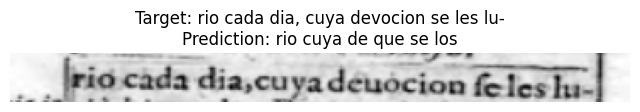

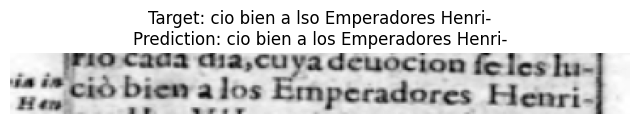

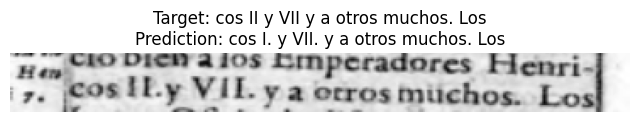

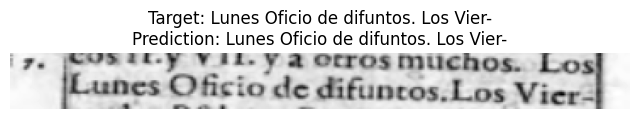

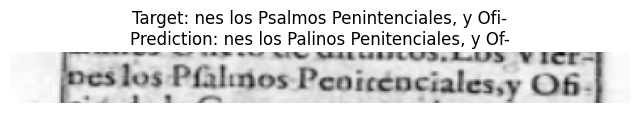

...

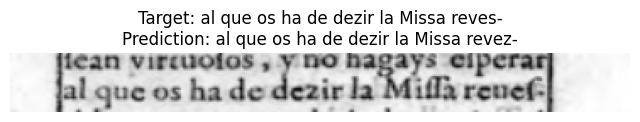

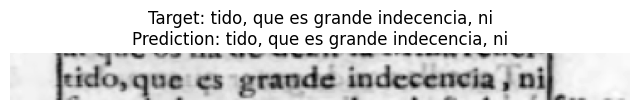

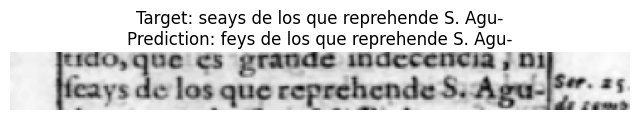

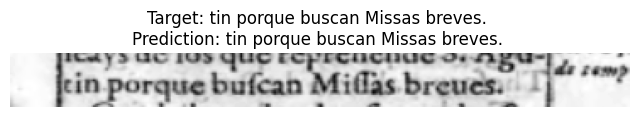

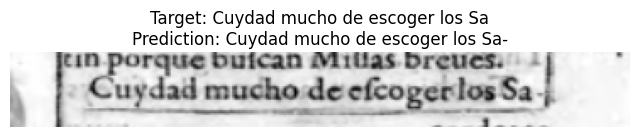

Average CER: 0.0037
Average WER: 0.1388
Average BLEU: 0.6546
Evaluation completed.


In [ ]:
test_line_images = '/content/test_images/P1-16'

aligned_data = {}
aligned_data['/content/image_folder1/Padilla - 1_page_16.png'] = align_segments_with_transcriptions('/content/image_folder1/Padilla - 1_page_16.png', test_line_images, transcript['/content/image_folder1/Padilla - 1_page_16.png'])

test_line_img = []
test_texts = []
for page_data in aligned_data.values():
    for line_img, text in page_data:
        test_line_img.append(line_img)
        test_texts.append(text)

evaluating_model(test_line_img, test_texts, target_size=(256, 64), batch_size=2)

In [ ]:
import torch
from torch.utils.data import DataLoader
import os
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

# Function to load images from a directory
def load_images_from_directory(directory_path, target_size):
    images = []
    image_paths = []
    for filename in os.listdir(directory_path):
        if filename.endswith((".png", ".jpg", ".jpeg")):  # Add more extensions if needed
            image_path = os.path.join(directory_path, filename)
            image = Image.open(image_path).convert("RGB")  # Ensure 3 channels
            # image = image.resize(target_size, Image.BILINEAR)
            image = np.array(image, dtype=np.uint8)  # Ensure dtype uint8
            images.append(image)
            image_paths.append(image_path)
    return images, image_paths


def generate_texts_from_images(line_images, target_size=(256, 64), batch_size=2):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    model_path = "./finetuned_transformer_model5v3"
    processor_path = "./finetuned_transformer_model5v3"

    processor = TrOCRProcessor.from_pretrained(processor_path)
    model = VisionEncoderDecoderModel.from_pretrained(model_path)

    dataset = LineDataset(processor, model, line_images, [""]*len(line_images), target_size)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False, collate_fn=collate_fn)
    model = dataset.model.to(device)
    model.eval()

    generated_texts = []

    with torch.no_grad():
        for batch in dataloader:
            pixel_values = batch["pixel_values"].to(device)

            # Generate predictions
            generated_ids = model.generate(pixel_values)
            generated_texts_batch = dataset.processor.batch_decode(generated_ids, skip_special_tokens=True)


            generated_texts.extend(generated_texts_batch)

    return generated_texts

/usr/local/lib/python3.10/dist-packages/transformers/generation/utils.py:1376: UserWarning: You have modified the pretrained model configuration to control generation. This is a deprecated strategy to control generation and will be removed soon, in a future version. Please use and modify the model generation configuration (see https://huggingface.co/docs/transformers/generation_strategies#default-text-generation-configuration )
  warnings.warn(


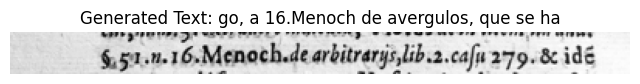

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_26.png
Generated Text: go, a 16.Menoch de avergulos, que se ha


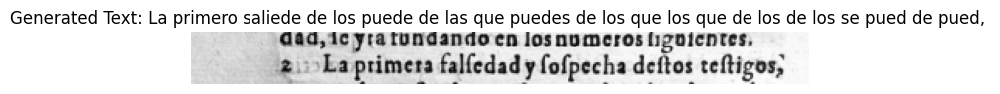

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_12.png
Generated Text: La primero saliede de los puede de las que puedes de los que los que de los de los se pued de pued, 


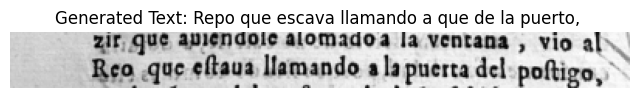

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_34.png
Generated Text: Repo que escava llamando a que de la puerto, 


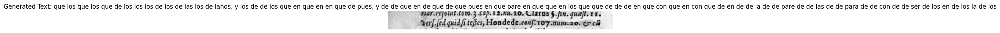

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_21.png
Generated Text: que los que los que de los los los de los de las los de laños, y los de de los que en que en en que de pues, y de de que en de que de que pues en que pare en que que en los que que de de de en que con que en con que de en de de la de de pare de de las de de para de de con de de ser de los en de los la de los


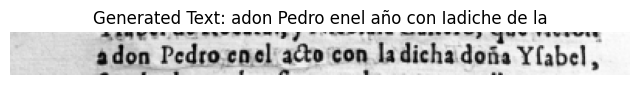

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_29.png
Generated Text: adon Pedro enel año con Iadiche de la


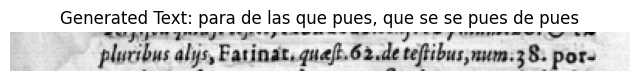

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_22.png
Generated Text: para de las que pues, que se se pues de pues


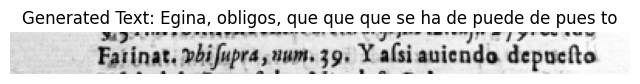

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_27.png
Generated Text: Egina, obligos, que que que se ha de puede de pues to


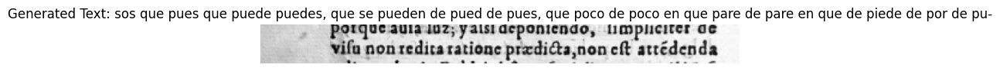

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_16.png
Generated Text: sos que pues que puede puedes, que se pueden de pued de pues, que poco de poco en que pare de pare en que de piede de por de pu-


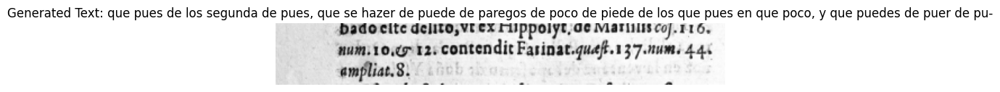

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_6.png
Generated Text: que pues de los segunda de pues, que se hazer de puede de paregos de poco de piede de los que pues en que poco, y que puedes de puer de pu-


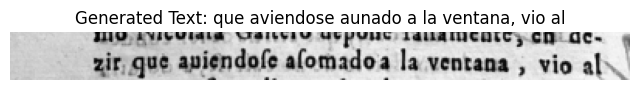

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_33.png
Generated Text: que aviendose aunado a la ventana, vio al


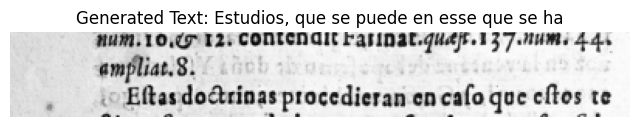

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_7.png
Generated Text: Estudios, que se puede en esse que se ha


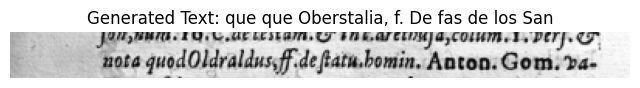

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_19.png
Generated Text: que que Oberstalia, f. De fas de los San


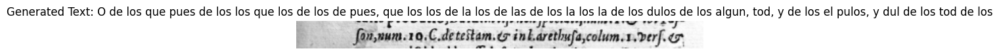

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_18.png
Generated Text: O de los que pues de los los que los de los de pues, que los los de la los de las de los la los la de los dulos de los algun, tod, y de los el pulos, y dul de los tod de los


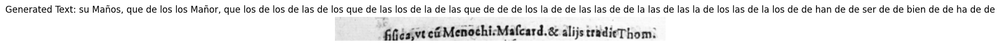

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_1.png
Generated Text: su Maños, que de los los Mañor, que los de los de las de los que de las los de la de las que de de de los la de de las las de de la las de las la de los las de la los de de han de de ser de de bien de de ha de de


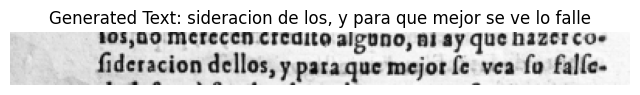

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_10.png
Generated Text: sideracion de los, y para que mejor se ve lo falle


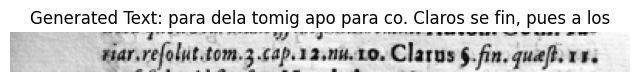

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_20.png
Generated Text: para dela tomig apo para co. Claros se fin, pues a los


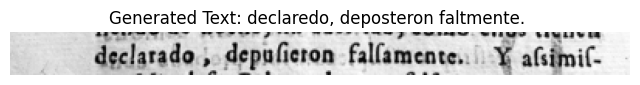

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_31.png
Generated Text: declaredo, deposteron faltmente. 


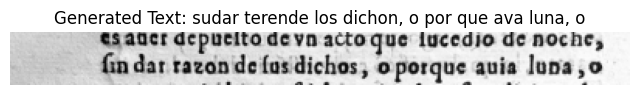

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_14.png
Generated Text: sudar terende los dichon, o por que ava luna, o


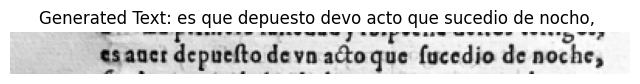

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_13.png
Generated Text: es que depuesto devo acto que sucedio de nocho, 


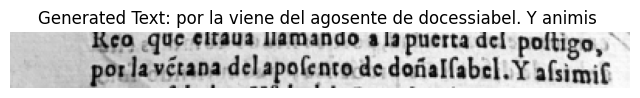

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_35.png
Generated Text: por la viene del agosente de docessiabel. Y animis 


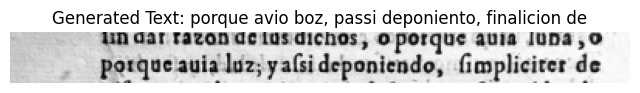

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_15.png
Generated Text: porque avio boz, passi deponiento, finalicion de


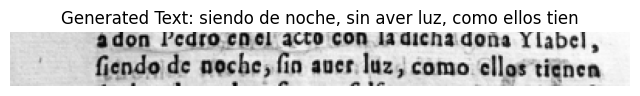

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_30.png
Generated Text: siendo de noche, sin aver luz, como ellos tien


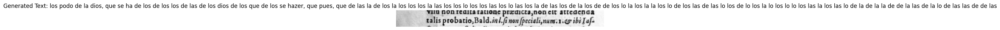

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_17.png
Generated Text: los podo de la dios, que se ha de los de los los de las de los dios de los que de los se hazer, que pues, que de las la de los la los los los la las los los lo los los las los lo las los la de las los de la los de de los lo la los la la los lo de los las de las lo los de lo los la lo los lo lo los las la los las lo de la de la la de de la las de la lo de las las de de las


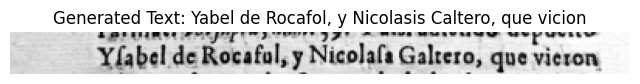

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_28.png
Generated Text: Yabel de Rocafol, y Nicolasis Caltero, que vicion


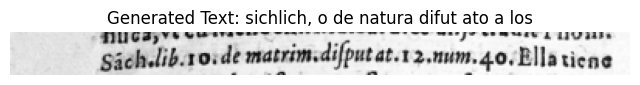

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_2.png
Generated Text: sichlich, o de natura difut ato a los


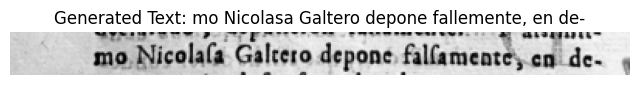

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_32.png
Generated Text: mo Nicolasa Galtero depone fallemente, en de-


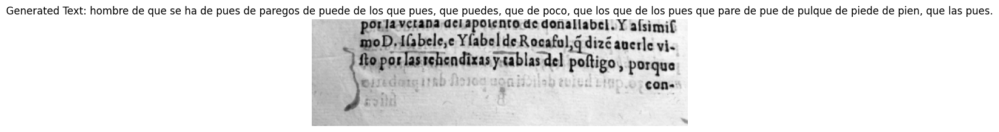

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_36.png
Generated Text: hombre de que se ha de pues de paregos de puede de los que pues, que puedes, que de poco, que los que de los pues que pare de pue de pulque de piede de pien, que las pues.


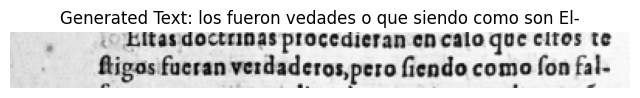

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_8.png
Generated Text: los fueron vedades o que siendo como son El-


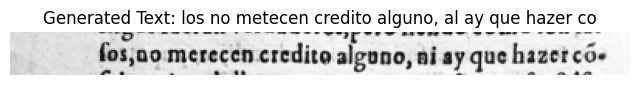

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_9.png
Generated Text: los no metecen credito alguno, al ay que hazer co


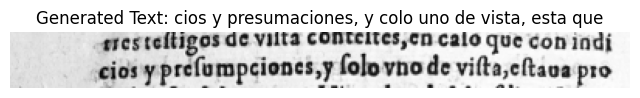

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_4.png
Generated Text: cios y presumaciones, y colo uno de vista, esta que


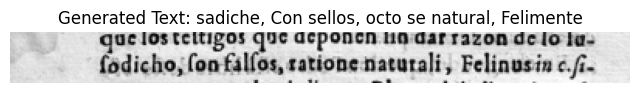

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_24.png
Generated Text: sadiche, Con sellos, octo se natural, Felimente


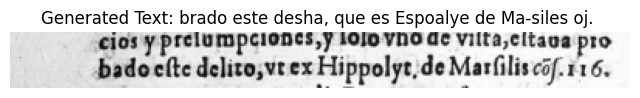

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_5.png
Generated Text: brado este desha, que es Espoalye de Ma-siles oj. 


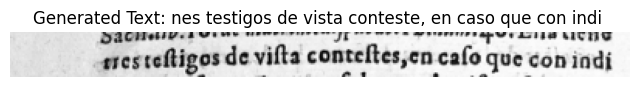

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_3.png
Generated Text: nes testigos de vista conteste, en caso que con indi 


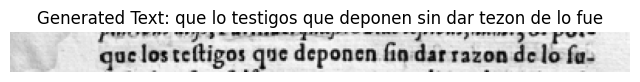

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_23.png
Generated Text: que lo testigos que deponen sin dar tezon de lo fue


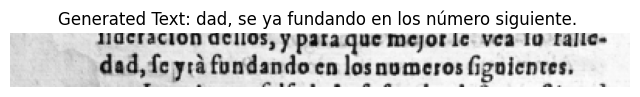

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_11.png
Generated Text: dad, se ya fundando en los número siguiente. 


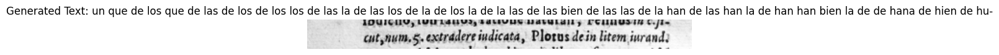

Image Path: /content/drive/MyDrive/porcones_test_2/Porcones.png_line_25.png
Generated Text: un que de los que de las de los de los los de las la de las los de la de los la de la las de las bien de las las de la han de las han la de han han bien la de de hana de hien de hu-


In [ ]:
# Load images from the specified directory
image_directory = '/content/drive/MyDrive/porcones_test_2'
target_size = (256, 64)
line_images, image_paths = load_images_from_directory(image_directory, target_size)

# Generate texts for the loaded images
generated_texts = generate_texts_from_images(line_images, target_size=target_size, batch_size=2)

# Display the images with their generated texts
for img_path, img, text in zip(image_paths, line_images, generated_texts):
    plt.figure(figsize=(8, 6))
    plt.imshow(img)
    plt.title(f"Generated Text: {text}")
    plt.axis('off')
    plt.show()
    print(f"Image Path: {img_path}\nGenerated Text: {text}\n{'='*50}")

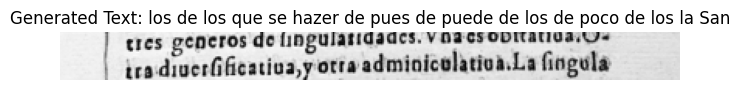

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_32.png
Generated Text: los de los que se hazer de pues de puede de los de poco de los la San


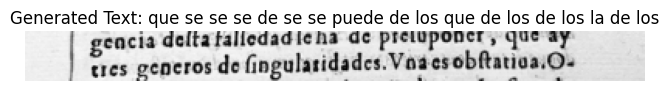

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_31.png
Generated Text: que se se se de se se puede de los que de los de los la de los


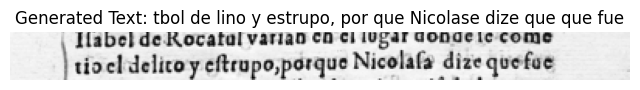

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_26.png
Generated Text: tbol de lino y estrupo, por que Nicolase dize que que fue


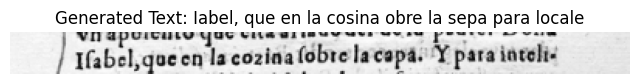

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_29.png
Generated Text: Iabel, que en la cosina obre la sepa para locale


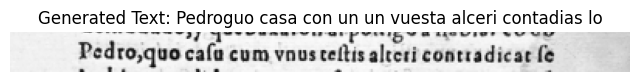

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_17.png
Generated Text: Pedroguo casa con un un vuesta alceri contadias lo


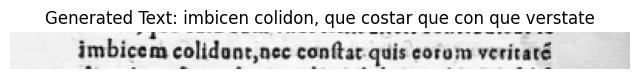

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_18.png
Generated Text: imbicen colidon, que costar que con que verstate


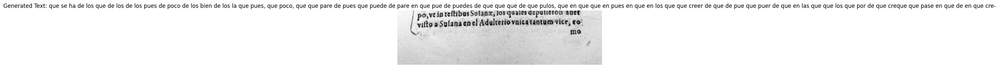

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_36.png
Generated Text: que se ha de los que de los de los pues de poco de los bien de los la que pues, que poco, que que pare de pues que puede de pare en que pue de puedes de que que que de que pulos, que en que que en pues en que en los que que creer de que de pue que puer de que en las que que los que por de que creque que pase en que de en que cre-


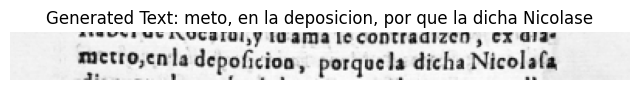

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_12.png
Generated Text: meto, en la deposicion, por que la dicha Nicolase


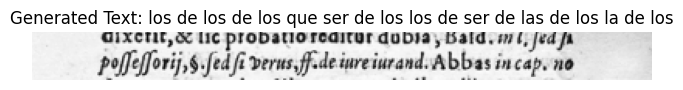

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_20.png
Generated Text: los de los de los que ser de los los de ser de las de los la de los


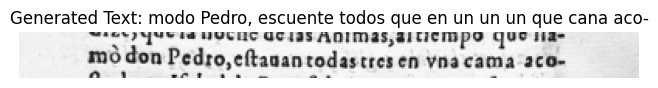

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_14.png
Generated Text: modo Pedro, escuente todos que en un un un que cana aco-


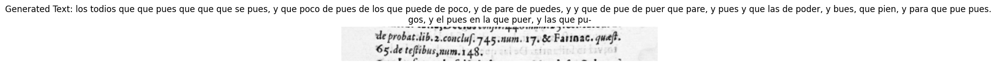

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_9.png
Generated Text: los todios que que pues que que que se pues, y que poco de pues de los que puede de poco, y de pare de puedes, y y que de pue de puer que pare, y pues y que las de poder, y bues, que pien, y para que pue pues. 
gos, y el pues en la que puer, y las que pu-


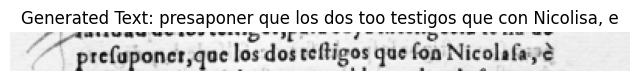

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_24.png
Generated Text: presaponer que los dos too testigos que con Nicolisa, e


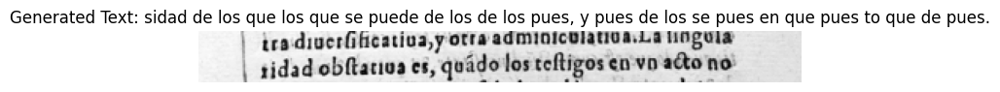

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_33.png
Generated Text: sidad de los que los que se puede de los de los pues, y pues de los se pues en que pues to que de pues.


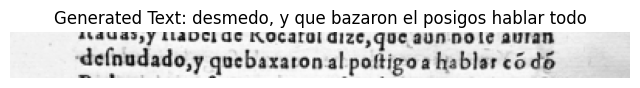

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_16.png
Generated Text: desmedo, y que bazaron el posigos hablar todo


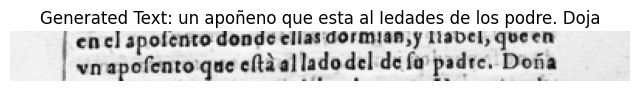

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_28.png
Generated Text: un apoñeno que esta al Iedades de los podre. Doja


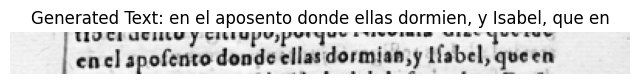

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_27.png
Generated Text: en el aposento donde ellas dormien, y Isabel, que en


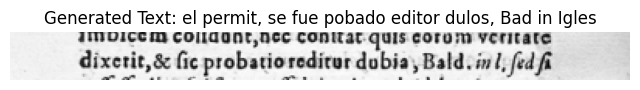

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_19.png
Generated Text: el permit, se fue pobado editor dulos, Bad in Igles


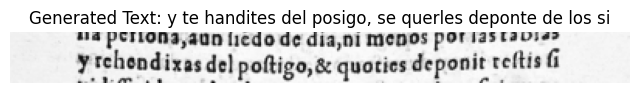

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_6.png
Generated Text: y te handites del posigo, se querles deponte de los si


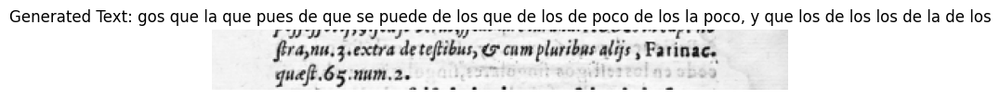

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_21.png
Generated Text: gos que la que pues de que se puede de los que de los de poco de los la poco, y que los de los los de la de los


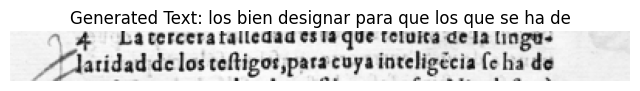

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_23.png
Generated Text: los bien designar para que los que se ha de


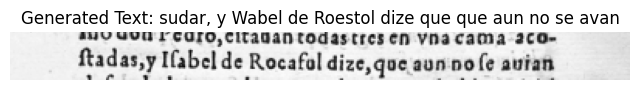

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_15.png
Generated Text: sudar, y Wabel de Roestol dize que que aun no se avan


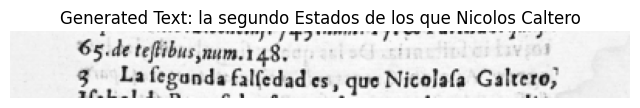

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_10.png
Generated Text: la segundo Estados de los que Nicolos Caltero


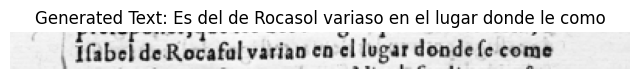

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_25.png
Generated Text: Es del de Rocasol variaso en el lugar donde le como


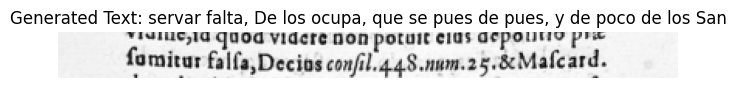

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_8.png
Generated Text: servar falta, De los ocupa, que se pues de pues, y de poco de los San


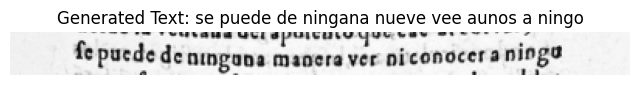

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_4.png
Generated Text: se puede de ningana nueve vee aunos a ningo


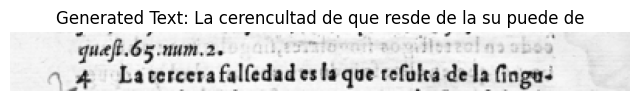

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_22.png
Generated Text: La cerencultad de que resde de la su puede de


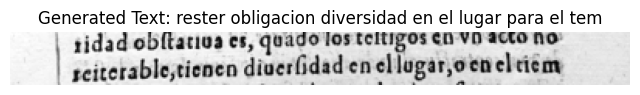

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_34.png
Generated Text: rester obligacion diversidad en el lugar para el tem


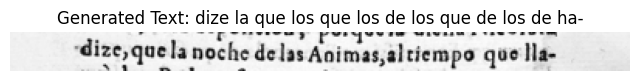

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_13.png
Generated Text: dize la que los que los de los que de los de ha-


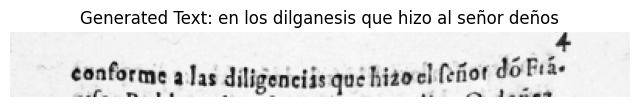

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_1.png
Generated Text: en los dilganesis que hizo al señor deños


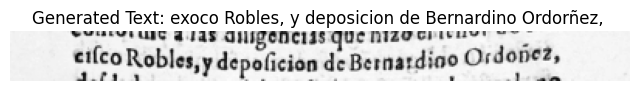

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_2.png
Generated Text: exoco Robles, y deposicion de Bernardino Ordorñez, 


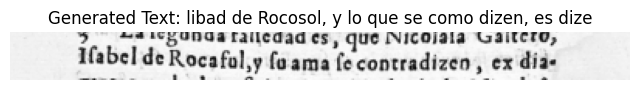

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_11.png
Generated Text: libad de Rocosol, y lo que se como dizen, es dize


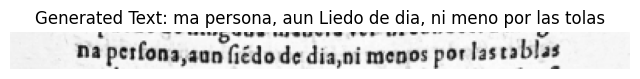

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_5.png
Generated Text: ma persona, aun Liedo de dia, ni meno por las tolas


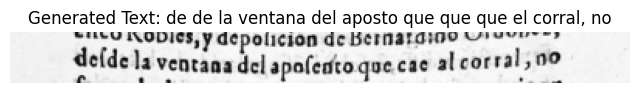

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_3.png
Generated Text: de de la ventana del aposto que que que el corral, no


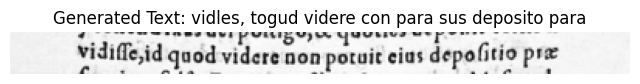

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_7.png
Generated Text: vidles, togud videre con para sus deposito para


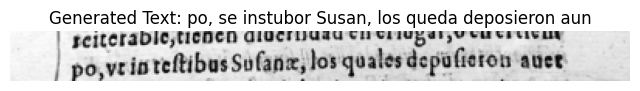

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_35.png
Generated Text: po, se instubor Susan, los queda deposieron aun


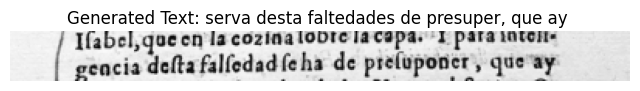

Image Path: /content/drive/MyDrive/porcones_test_3/Porcones.png_line_30.png
Generated Text: serva desta faltedades de presuper, que ay 


In [ ]:
# Load images from the specified directory
image_directory = '/content/drive/MyDrive/porcones_test_3'
target_size = (256, 64)
line_images, image_paths = load_images_from_directory(image_directory, target_size)

# Generate texts for the loaded images
generated_texts = generate_texts_from_images(line_images, target_size=target_size, batch_size=2)

# Display the images with their generated texts
for img_path, img, text in zip(image_paths, line_images, generated_texts):
    plt.figure(figsize=(8, 6))
    plt.imshow(img)
    plt.title(f"Generated Text: {text}")
    plt.axis('off')
    plt.show()
    print(f"Image Path: {img_path}\nGenerated Text: {text}\n{'='*50}")

#Training- 4

### Implemented Multiple Data Augmentation on a training image, each augmentation with its respected p probability

In [ ]:
from transformers import GenerationConfig

generation_config = GenerationConfig(
    max_length=512,
    no_repeat_ngram_size=3
)

generation_config.save_pretrained("generation_config_4")

In [ ]:
import albumentations as A
from albumentations.pytorch import ToTensorV2
import torch
from torch.utils.data import Dataset, DataLoader, random_split
from transformers import TrOCRProcessor, VisionEncoderDecoderModel, Trainer, TrainingArguments, GenerationConfig, get_linear_schedule_with_warmup
from PIL import Image
import numpy as np
from torch.nn.utils.rnn import pad_sequence
from torch.optim import AdamW
import cv2

class LineDataset(Dataset):
    def __init__(self, processor, model, line_images, texts, target_size=(256, 64), max_length=512):
        self.line_images = line_images
        self.texts = texts
        self.processor = processor
        self.processor.image_processor.max_length = max_length
        self.processor.tokenizer.model_max_length = max_length
        self.model = model
        self.model.config.max_length = max_length
        self.target_size = target_size
        self.max_length = max_length

        # Define augmentations
        self.transform = A.Compose([
            A.Rotate(limit=3, p=0.5),  # Randomly rotate upto 3 degrees
            A.ElasticTransform(alpha=0.25, sigma=100.0, alpha_affine=0.45, p=0.5),  # Apply elastic transformations
            A.GaussNoise(var_limit=(10.0, 40.0), p=0.5),  # Apply Gaussian noise
            A.Affine(scale=(0.95, 1.05), translate_percent=(0.01, 0.01), shear=(-3, 3), p=0.5),  # Affine transformations
            A.OpticalDistortion(distort_limit=0.05, shift_limit=0.05, p=0.5),  # Apply optical distortion
            A.CLAHE(clip_limit=2, tile_grid_size=(8, 8), p=0.5),  # Apply CLAHE for contrast enhancement
            A.Perspective(scale=(0.02, 0.05), p=0.5),  # Apply perspective transformations
            A.OneOf([
                A.GaussianBlur(blur_limit=(3, 7)),
                A.MedianBlur(blur_limit=3),
            ], p=1.0),  # Apply blur
            ToTensorV2()  # Convert image to tensor
        ])

    def __len__(self):
        return len(self.line_images)

    def __getitem__(self, idx):
        image = self.line_images[idx]
        text = self.texts[idx]

        # Convert image to numpy array and ensure it has 3 channels
        if isinstance(image, Image.Image):
            image = np.array(image)

        if image.ndim == 2:
            image = np.expand_dims(image, axis=-1)
        if image.shape[-1] == 1:
            image = np.repeat(image, 3, axis=-1)


        # Ensure the image is in uint8 format
        image = (image * 255).astype(np.uint8)

        # Apply augmentations
        augmented = self.transform(image=image)
        image = augmented['image']

        # Prepare inputs for the processor
        encoding = self.processor(images=image, text=text, return_tensors="pt")

        # Remove batch dimension from encoding
        encoding = {k: v.squeeze() for k, v in encoding.items()}
        return encoding

def collate_fn(batch):
    # Collate function to create batches
    pixel_values = torch.stack([item['pixel_values'] for item in batch])
    labels = pad_sequence([item['labels'] for item in batch], batch_first=True, padding_value=-100)
    return {'pixel_values': pixel_values, 'labels': labels}

def train_transformer_model(line_images, texts, target_size=(256, 64), batch_size=2, max_length=512, val_split=0.1):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    processor = TrOCRProcessor.from_pretrained("qantev/trocr-large-spanish", do_rescale=False)
    model = VisionEncoderDecoderModel.from_pretrained("qantev/trocr-large-spanish")

    # Load the GenerationConfig
    generation_config = GenerationConfig.from_pretrained("generation_config_4")

    dataset = LineDataset(processor, model, line_images, texts, target_size)

    # Split the dataset into training and validation datasets
    val_size = int(len(dataset) * val_split)
    train_size = len(dataset) - val_size
    train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

    # Create the model
    model = dataset.model.to(device)
    model.generation_config = generation_config

    # Define training arguments
    training_args = TrainingArguments(
        output_dir="./results",                # output directory
        num_train_epochs=25,                    # total number of training epochs
        per_device_train_batch_size=batch_size, # batch size per device during training
        per_device_eval_batch_size=batch_size, # batch size for evaluation
        logging_dir="./logs",                  # directory for storing logs
        logging_steps=50,
        save_steps=100,                         # Save checkpoint every 50 steps
        save_total_limit=2,                    # Limit the total amount of checkpoints
        evaluation_strategy="steps",           # Evaluation strategy to adopt during training
        eval_steps=100,                         # Number of update steps between two evaluations
        learning_rate=5e-5,                    # Learning rate
        weight_decay=0.01,                     # Weight decay for regularization
        load_best_model_at_end=True,           # Load the best model at the end of training
        metric_for_best_model="loss",          # Metric to use to compare models
        greater_is_better=False,               # Whether the metric should be maximized
        logging_first_step=True,               # Log the first step
        gradient_accumulation_steps=4,         # Gradient accumulation steps to simulate a larger batch size
        fp16=True,                             # Use mixed precision training
    )

    # Initialize the optimizer
    optimizer = AdamW(model.parameters(), lr=training_args.learning_rate, weight_decay=training_args.weight_decay)
    # Calculate total training steps
    total_steps = len(train_dataset) // batch_size * training_args.num_train_epochs

    # Initialize the learning rate scheduler
    scheduler = get_linear_schedule_with_warmup(
        optimizer,
        num_warmup_steps=total_steps * 0.1,   # Warmup steps as 10% of total steps
        num_training_steps=total_steps
    )
    # Initialize the Trainer
    trainer = Trainer(
        model=model,                           # Transformers model to be trained
        args=training_args,                    # training arguments, defined above
        train_dataset=train_dataset,           # training dataset
        eval_dataset=val_dataset,              # validation dataset
        data_collator=collate_fn,              # our data collator
        optimizers=(optimizer, scheduler)                 # AdamW optimizer
    )

    # Train the model
    trainer.train()

    # Save the trained model and the processor
    model.save_pretrained("finetuned_transformer_model4")
    dataset.processor.save_pretrained("finetuned_transformer_model4")

In [ ]:
# Flatten the aligned data
line_images = []
texts = []
for page_data in aligned_data.values():
    for line_img, text in page_data:
        line_images.append(line_img)
        texts.append(text)

# Train the model with the resized images
train_transformer_model(line_images, texts, target_size=(256, 64), batch_size=2, max_length=512)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1504: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Step,Training Loss,Validation Loss
100,5.597300,5.094706
200,4.807900,4.722744
300,4.563900,4.452231
400,4.291200,4.382329
500,4.073100,4.357211
600,4.001100,4.300858
700,3.864100,4.272550
800,3.645500,4.331416
900,3.771800,4.313147
1000,3.581900,4.298290


Some non-default generation parameters are set in the model config. These should go into a GenerationConfig file (https://huggingface.co/docs/transformers/generation_strategies#save-a-custom-decoding-strategy-with-your-model) instead. This warning will be raised to an exception in v4.41.
Non-default generation parameters: {'max_length': 512, 'no_repeat_ngram_size': 3}
Some non-default generation parameters are set in the model config. These should go into a GenerationConfig file (https://huggingface.co/docs/transformers/generation_strategies#save-a-custom-decoding-strategy-with-your-model) instead. This warning will be raised to an exception in v4.41.
Non-default generation parameters: {'max_length': 512, 'no_repeat_ngram_size': 3}
Some non-default generation parameters are set in the model config. These should go into a GenerationConfig file (https://huggingface.co/docs/transformers/generation_strategies#save-a-custom-decoding-strategy-with-your-model) instead. This warning will be ra

Step,Training Loss,Validation Loss
100,5.597300,5.094706
200,4.807900,4.722744
300,4.563900,4.452231
400,4.291200,4.382329
500,4.073100,4.357211
600,4.001100,4.300858
700,3.864100,4.272550
800,3.645500,4.331416
900,3.771800,4.313147
1000,3.581900,4.298290


Some non-default generation parameters are set in the model config. These should go into a GenerationConfig file (https://huggingface.co/docs/transformers/generation_strategies#save-a-custom-decoding-strategy-with-your-model) instead. This warning will be raised to an exception in v4.41.
Non-default generation parameters: {'max_length': 512, 'no_repeat_ngram_size': 3}
Some non-default generation parameters are set in the model config. These should go into a GenerationConfig file (https://huggingface.co/docs/transformers/generation_strategies#save-a-custom-decoding-strategy-with-your-model) instead. This warning will be raised to an exception in v4.41.
Non-default generation parameters: {'max_length': 512, 'no_repeat_ngram_size': 3}
Some non-default generation parameters are set in the model config. These should go into a GenerationConfig file (https://huggingface.co/docs/transformers/generation_strategies#save-a-custom-decoding-strategy-with-your-model) instead. This warning will be ra

In [ ]:
import albumentations as A
from albumentations.pytorch import ToTensorV2
import torch
from torch.utils.data import Dataset, DataLoader, random_split
from transformers import TrOCRProcessor, VisionEncoderDecoderModel, Trainer, TrainingArguments, GenerationConfig, get_linear_schedule_with_warmup, EarlyStoppingCallback
from PIL import Image
import numpy as np
from torch.nn.utils.rnn import pad_sequence
from torch.optim import AdamW
import cv2

class LineDataset(Dataset):
    def __init__(self, processor, model, line_images, texts, target_size=(256, 64), max_length=512):
        self.line_images = line_images
        self.texts = texts
        self.processor = processor
        self.processor.image_processor.max_length = max_length
        self.processor.tokenizer.model_max_length = max_length
        self.model = model
        self.model.config.max_length = max_length
        self.target_size = target_size
        self.max_length = max_length

        # Define augmentations
        self.transform = A.Compose([
            A.Rotate(limit=2, p=0.5),  # Randomly rotate up to 2 degrees
            A.GaussNoise(var_limit=(5.0, 10.0), p=0.5),  # Apply Gaussian noise
            A.OpticalDistortion(distort_limit=0.03, shift_limit=0.03, p=0.5),  # Apply optical distortion
            A.CLAHE(clip_limit=2, tile_grid_size=(2, 2), p=0.5),  # Apply CLAHE for contrast enhancement
            A.Perspective(scale=(0.01, 0.025), p=0.5),  # Apply perspective transformations
            A.OneOf([
                A.GaussianBlur(blur_limit=(1, 3)),
                A.MedianBlur(blur_limit=1),
            ], p=1.0),  # Apply blur
            ToTensorV2()  # Convert image to tensor
        ])

    def __len__(self):
        return len(self.line_images)

    def __getitem__(self, idx):
        image = self.line_images[idx]
        text = self.texts[idx]

        # Convert image to numpy array and ensure it has 3 channels
        if isinstance(image, Image.Image):
            image = np.array(image)

        if image.ndim == 2:
            image = np.expand_dims(image, axis=-1)
        if image.shape[-1] == 1:
            image = np.repeat(image, 3, axis=-1)

        # Ensure the image is in uint8 format
        image = (image * 255).astype(np.uint8)

        # Apply augmentations
        augmented = self.transform(image=image)
        image = augmented['image']

        # Prepare inputs for the processor
        encoding = self.processor(images=image, text=text, return_tensors="pt")

        # Remove batch dimension from encoding
        encoding = {k: v.squeeze() for k, v in encoding.items()}
        return encoding

def collate_fn(batch):
    # Collate function to create batches
    pixel_values = torch.stack([item['pixel_values'] for item in batch])
    labels = pad_sequence([item['labels'] for item in batch], batch_first=True, padding_value=-100)
    return {'pixel_values': pixel_values, 'labels': labels}

def train_transformer_model(line_images, texts, target_size=(256, 64), batch_size=2, max_length=512, val_split=0.1):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    processor = TrOCRProcessor.from_pretrained("qantev/trocr-large-spanish", do_rescale=False)
    model = VisionEncoderDecoderModel.from_pretrained("qantev/trocr-large-spanish")

    # Load the GenerationConfig
    generation_config = GenerationConfig.from_pretrained("generation_config_4")

    dataset = LineDataset(processor, model, line_images, texts, target_size)

    # Split the dataset into training and validation datasets
    val_size = int(len(dataset) * val_split)
    train_size = len(dataset) - val_size
    train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

    # Calculate total training steps
    total_steps = len(train_dataset) // batch_size * 30

    # Define training arguments
    training_args = TrainingArguments(
        output_dir="./results",                # output directory
        num_train_epochs=30,                    # total number of training epochs
        per_device_train_batch_size=batch_size, # batch size per device during training
        per_device_eval_batch_size=batch_size,  # batch size for evaluation
        logging_dir="./logs",                  # directory for storing logs
        logging_steps=50,
        save_steps=100,                         # Save checkpoint every 100 steps
        save_total_limit=2,                    # Limit the total amount of checkpoints
        evaluation_strategy="steps",           # Evaluation strategy to adopt during training
        eval_steps=100,                         # Number of update steps between two evaluations
        learning_rate= 0.0001,                    # Learning rate
        weight_decay=0.05,                     # Weight decay for regularization
        load_best_model_at_end=True,           # Load the best model at the end of training
        metric_for_best_model="loss",          # Metric to use to compare models
        greater_is_better=False,               # Whether the metric should be maximized
        logging_first_step=True,               # Log the first step
        gradient_accumulation_steps=6,         # Gradient accumulation steps to simulate a larger batch size
        fp16=True,                             # Use mixed precision training
        warmup_steps=int(total_steps * 0.05)   # Adjust warmup steps to 5% of total steps
    )

    # Initialize the optimizer
    optimizer = AdamW(model.parameters(), lr=training_args.learning_rate, weight_decay=training_args.weight_decay)

    # Initialize the learning rate scheduler
    scheduler = get_linear_schedule_with_warmup(
        optimizer,
        num_warmup_steps=int(total_steps * 0.05),   # Warmup steps as 5% of total steps
        num_training_steps=total_steps
    )

    # Initialize the Trainer
    trainer = Trainer(
        model=model,                           # Transformers model to be trained
        args=training_args,                    # training arguments, defined above
        train_dataset=train_dataset,           # training dataset
        eval_dataset=val_dataset,              # validation dataset
        data_collator=collate_fn,              # our data collator
        optimizers=(optimizer, scheduler),     # AdamW optimizer and scheduler
        callbacks=[EarlyStoppingCallback(early_stopping_patience=3)]  # Early stopping
    )

    # Train the model
    trainer.train()

    # Save the trained model and the processor
    model.save_pretrained("finetuned_transformer_model4V4")
    dataset.processor.save_pretrained("finetuned_transformer_model4V4")

In [ ]:
# Flatten the aligned data
line_images = []
texts = []
for page_data in aligned_data.values():
    for line_img, text in page_data:
        line_images.append(line_img)
        texts.append(text)

# Train the model with the resized images
train_transformer_model(line_images, texts, target_size=(256, 64), batch_size=2, max_length=512)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Step,Training Loss,Validation Loss
100,6.291900,5.291130
200,5.128300,4.721914
300,4.750500,4.510090
400,4.551900,4.356387
500,4.279600,4.245761


Some non-default generation parameters are set in the model config. These should go into a GenerationConfig file (https://huggingface.co/docs/transformers/generation_strategies#save-a-custom-decoding-strategy-with-your-model) instead. This warning will be raised to an exception in v4.41.
Non-default generation parameters: {'max_length': 512, 'no_repeat_ngram_size': 3}
Your generation config was originally created from the model config, but the model config has changed since then. Unless you pass the `generation_config` argument to this model's `generate` calls, they will revert to the legacy behavior where the base `generate` parameterization is loaded from the model config instead. To avoid this behavior and this warning, we recommend you to overwrite the generation config model attribute before calling the model's `save_pretrained`, preferably also removing any generation kwargs from the model config. This warning will be raised to an exception in v4.41.
Some non-default generation p

Step,Training Loss,Validation Loss
100,6.291900,5.291130
200,5.128300,4.721914
300,4.750500,4.510090
400,4.551900,4.356387
500,4.279600,4.245761
600,4.132900,4.168221
700,4.037300,4.090940
800,3.885000,4.074574
900,3.757900,4.098151
1000,3.621600,4.031971


Some non-default generation parameters are set in the model config. These should go into a GenerationConfig file (https://huggingface.co/docs/transformers/generation_strategies#save-a-custom-decoding-strategy-with-your-model) instead. This warning will be raised to an exception in v4.41.
Non-default generation parameters: {'max_length': 512, 'no_repeat_ngram_size': 3}
Your generation config was originally created from the model config, but the model config has changed since then. Unless you pass the `generation_config` argument to this model's `generate` calls, they will revert to the legacy behavior where the base `generate` parameterization is loaded from the model config instead. To avoid this behavior and this warning, we recommend you to overwrite the generation config model attribute before calling the model's `save_pretrained`, preferably also removing any generation kwargs from the model config. This warning will be raised to an exception in v4.41.
Some non-default generation p

# Training 3


### Added Optimizers and Schedulers

In [ ]:
from transformers import GenerationConfig

generation_config = GenerationConfig(
    max_length=512,
    no_repeat_ngram_size=3
)

generation_config.save_pretrained("finetuned_transformer_model2")


In [ ]:
import torch
from torch.utils.data import Dataset, DataLoader, random_split
from transformers import TrOCRProcessor, VisionEncoderDecoderModel, Trainer, TrainingArguments, GenerationConfig, get_linear_schedule_with_warmup
from PIL import Image
import numpy as np
from torch.nn.utils.rnn import pad_sequence
from torch.optim import AdamW

class LineDataset(Dataset):
    def __init__(self, processor, model, line_images, texts, target_size=(256, 64), max_length=512):
        self.line_images = line_images
        self.texts = texts
        self.processor = processor
        self.processor.image_processor.max_length = max_length
        self.processor.tokenizer.model_max_length = max_length
        self.model = model
        self.model.config.max_length = max_length
        self.target_size = target_size
        self.max_length = max_length

    def __len__(self):
        return len(self.line_images)

    def __getitem__(self, idx):
        image = self.line_images[idx]
        text = self.texts[idx]

        # Convert image to PIL for resizing
        image = Image.fromarray((image * 255).astype(np.uint8))

        # Resize image
        image = image.resize(self.target_size, Image.BILINEAR)

        # Convert image back to numpy array and ensure it has 3 dimensions
        image = np.array(image) / 255.0
        if image.ndim == 2:
            image = np.expand_dims(image, axis=-1)  # Add a channel dimension if it's missing
            image = np.repeat(image, 3, axis=-1)   # Repeat the single channel to create 3 channels

        # Ensure the image has shape (3, height, width)
        image = np.transpose(image, (2, 0, 1))

        # Prepare inputs for the processor
        encoding = self.processor(images=image, text=text, return_tensors="pt")

        # Remove batch dimension from encoding
        encoding = {k: v.squeeze() for k, v in encoding.items()}
        return encoding

def collate_fn(batch):
    # Collate function to create batches
    pixel_values = torch.stack([item['pixel_values'] for item in batch])
    labels = pad_sequence([item['labels'] for item in batch], batch_first=True, padding_value=-100)
    return {'pixel_values': pixel_values, 'labels': labels}

def train_transformer_model(line_images, texts, target_size=(256, 64), batch_size=2, max_length=512, val_split=0.1):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    processor = TrOCRProcessor.from_pretrained("qantev/trocr-large-spanish", do_rescale=False)
    model = VisionEncoderDecoderModel.from_pretrained("qantev/trocr-large-spanish")

    # Load the GenerationConfig
    generation_config = GenerationConfig.from_pretrained("finetuned_transformer_model2")

    dataset = LineDataset(processor, model, line_images, texts, target_size)

    # Split the dataset into training and validation datasets
    val_size = int(len(dataset) * val_split)
    train_size = len(dataset) - val_size
    train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

    # Create the model
    model = dataset.model.to(device)
    model.generation_config = generation_config

    # Define training arguments
    training_args = TrainingArguments(
        output_dir="./results",                # output directory
        num_train_epochs=20,                    # total number of training epochs
        per_device_train_batch_size=batch_size, # batch size per device during training
        per_device_eval_batch_size=batch_size, # batch size for evaluation
        logging_dir="./logs",                  # directory for storing logs
        logging_steps=50,
        save_steps=100,                         # Save checkpoint every 50 steps
        save_total_limit=2,                    # Limit the total amount of checkpoints
        evaluation_strategy="steps",           # Evaluation strategy to adopt during training
        eval_steps=100,                         # Number of update steps between two evaluations
        learning_rate=5e-5,                    # Learning rate
        weight_decay=0.01,                     # Weight decay for regularization
        load_best_model_at_end=True,           # Load the best model at the end of training
        metric_for_best_model="loss",          # Metric to use to compare models
        greater_is_better=False,               # Whether the metric should be maximized
        logging_first_step=True,               # Log the first step
        gradient_accumulation_steps=4,         # Gradient accumulation steps to simulate a larger batch size
        fp16=True,                             # Use mixed precision training
    )

    # Initialize the optimizer
    optimizer = AdamW(model.parameters(), lr=training_args.learning_rate, weight_decay=training_args.weight_decay)

    # Calculate total training steps
    total_steps = len(train_dataset) // batch_size * training_args.num_train_epochs

    # Initialize the learning rate scheduler
    scheduler = get_linear_schedule_with_warmup(
        optimizer,
        num_warmup_steps=total_steps * 0.1,   # Warmup steps as 10% of total steps
        num_training_steps=total_steps
    )

    # Initialize the Trainer
    trainer = Trainer(
        model=model,                           # Transformers model to be trained
        args=training_args,                    # training arguments, defined above
        train_dataset=train_dataset,           # training dataset
        eval_dataset=val_dataset,              # validation dataset
        data_collator=collate_fn,              # our data collator
        optimizers=(optimizer, scheduler)      # AdamW optimizer and learning rate scheduler
    )

    # Train the model
    trainer.train()

    # Save the trained model and the processor
    model.save_pretrained("finetuned_transformer_model3")
    dataset.processor.save_pretrained("finetuned_transformer_model3")

# Flatten the aligned data
line_images = []
texts = []
for page_data in aligned_data.values():
    for line_img, text in page_data:
        line_images.append(line_img)
        texts.append(text)

# Train the model with the resized images
train_transformer_model(line_images, texts, target_size=(256, 64), batch_size=2, max_length=512)


#Training - 2

### Used Trainer Api for training with some additional training arguments

In [ ]:
import torch
from torch.utils.data import Dataset, DataLoader, random_split
from transformers import TrOCRProcessor, VisionEncoderDecoderModel, Trainer, TrainingArguments
from PIL import Image
import numpy as np
from torch.nn.utils.rnn import pad_sequence

class LineDataset(Dataset):
    def __init__(self, processor, model, line_images, texts, target_size=(256, 64), max_length=512):
        self.line_images = line_images
        self.texts = texts
        self.processor = processor
        self.processor.image_processor.max_length = max_length
        self.processor.tokenizer.model_max_length = max_length
        self.model = model
        self.model.config.max_length = max_length
        self.target_size = target_size
        self.max_length = max_length

    def __len__(self):
        return len(self.line_images)

    def __getitem__(self, idx):
        image = self.line_images[idx]
        text = self.texts[idx]

        # Convert image to PIL for resizing
        image = Image.fromarray((image * 255).astype(np.uint8))

        # Resize image
        image = image.resize(self.target_size, Image.BILINEAR)

        # Convert image back to numpy array and ensure it has 3 dimensions
        image = np.array(image) / 255.0
        if image.ndim == 2:
            image = np.expand_dims(image, axis=-1)  # Add a channel dimension if it's missing
            image = np.repeat(image, 3, axis=-1)   # Repeat the single channel to create 3 channels

        # Ensure the image has shape (3, height, width)
        image = np.transpose(image, (2, 0, 1))

        # Prepare inputs for the processor
        encoding = self.processor(images=image, text=text, return_tensors="pt")

        # Remove batch dimension from encoding
        encoding = {k: v.squeeze() for k, v in encoding.items()}
        return encoding

def collate_fn(batch):
    # Collate function to create batches
    pixel_values = torch.stack([item['pixel_values'] for item in batch])
    labels = pad_sequence([item['labels'] for item in batch], batch_first=True, padding_value=-100)
    return {'pixel_values': pixel_values, 'labels': labels}

def train_transformer_model(line_images, texts, target_size=(256, 64), batch_size=2, max_length=512, val_split=0.1):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    processor = TrOCRProcessor.from_pretrained("qantev/trocr-large-spanish", do_rescale=False)
    model = VisionEncoderDecoderModel.from_pretrained("qantev/trocr-large-spanish")

    dataset = LineDataset(processor, model, line_images, texts, target_size)

    # Split the dataset into training and validation datasets
    val_size = int(len(dataset) * val_split)
    train_size = len(dataset) - val_size
    train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

    # Create the model
    model = dataset.model.to(device)

    # Define training arguments
    training_args = TrainingArguments(
        output_dir="./results",                # output directory
        num_train_epochs=5,                    # total number of training epochs
        per_device_train_batch_size=batch_size, # batch size per device during training
        per_device_eval_batch_size=batch_size, # batch size for evaluation
        logging_dir="./logs",                  # directory for storing logs
        logging_steps=10,
        save_steps=50,                         # Save checkpoint every 50 steps
        save_total_limit=2,                    # Limit the total amount of checkpoints
        evaluation_strategy="steps",           # Evaluation strategy to adopt during training
        eval_steps=50,                         # Number of update steps between two evaluations
        learning_rate=5e-5,                    # Learning rate
        weight_decay=0.01,                     # Weight decay for regularization
        load_best_model_at_end=True,           # Load the best model at the end of training
        metric_for_best_model="loss",          # Metric to use to compare models
        greater_is_better=False,               # Whether the metric should be maximized
        logging_first_step=True,               # Log the first step
        gradient_accumulation_steps=4,         # Gradient accumulation steps to simulate a larger batch size
        fp16=True,                             # Use mixed precision training
    )

    # Initialize the Trainer
    trainer = Trainer(
        model=model,                           # Transformers model to be trained
        args=training_args,                    # training arguments, defined above
        train_dataset=train_dataset,           # training dataset
        eval_dataset=val_dataset,              # validation dataset
        data_collator=collate_fn               # our data collator
    )

    # Train the model
    trainer.train()

    # Save the trained model and the processor
    model.save_pretrained("finetuned_transformer_model2")
    dataset.processor.save_pretrained("finetuned_transformer_model2")



In [ ]:
# Flatten the aligned data
line_images = []
texts = []
for page_data in aligned_data.values():
    for line_img, text in page_data:
        line_images.append(line_img)
        texts.append(text)

# Train the model with the resized images
train_transformer_model(line_images, texts, target_size=(256, 64), batch_size=2, max_length=512)


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/364 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/1.38k [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/798k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/2.11M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/957 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.97k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/2.44G [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/420 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Step,Training Loss,Validation Loss
50,0.923600,1.307793
100,1.085400,1.097796
150,1.255700,1.149701
200,0.949500,0.866058
250,0.835800,0.887893


Some non-default generation parameters are set in the model config. These should go into a GenerationConfig file (https://huggingface.co/docs/transformers/generation_strategies#save-a-custom-decoding-strategy-with-your-model) instead. This warning will be raised to an exception in v4.41.
Non-default generation parameters: {'max_length': 512, 'no_repeat_ngram_size': 3}
Your generation config was originally created from the model config, but the model config has changed since then. Unless you pass the `generation_config` argument to this model's `generate` calls, they will revert to the legacy behavior where the base `generate` parameterization is loaded from the model config instead. To avoid this behavior and this warning, we recommend you to overwrite the generation config model attribute before calling the model's `save_pretrained`, preferably also removing any generation kwargs from the model config. This warning will be raised to an exception in v4.41.
Some non-default generation p

KeyboardInterrupt: 

In [ ]:
# test

In [ ]:
! cp -r /content/drive/MyDrive/finetuned_transformer_model2 /content/finetuned_transformer_model2

In [ ]:
import torch
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
from nltk.translate.bleu_score import sentence_bleu, corpus_bleu
from jiwer import wer
import jiwer

def evaluating_model(line_images, texts, target_size=(256, 64), batch_size=2):
    # device = torch.device('cpu')
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    model_path = "./finetuned_transformer_model2"
    processor_path = "./finetuned_transformer_model2"

    processor = TrOCRProcessor.from_pretrained(processor_path)
    model = VisionEncoderDecoderModel.from_pretrained(model_path)

    dataset = LineDataset(processor, model, line_images, texts, target_size)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False, collate_fn=collate_fn)
    model = dataset.model.to(device)
    model.eval()
    total_loss = 0
    num_batches = 0

    cer_scores = []
    wer_scores = []
    bleu_scores = []

    with torch.no_grad():
        for batch in dataloader:
            pixel_values = batch["pixel_values"].to(device)

            # Generate predictions
            generated_ids = model.generate(pixel_values)
            generated_texts = dataset.processor.batch_decode(generated_ids, skip_special_tokens=True)

            # Calculate CER and WER for each prediction
            for i in range(len(generated_texts)):
                gt = texts[num_batches * batch_size + i]
                pred = generated_texts[i]

                # Calculate CER
                cer = jiwer.wer(gt, pred) / len(gt)
                cer_scores.append(cer)

                # Calculate WER
                wer_score = wer(gt, pred)
                wer_scores.append(wer_score)

                # Calculate BLEU score
                bleu_score = sentence_bleu([gt.split()], pred.split())
                bleu_scores.append(bleu_score)

                # Display image and predictions
                image = line_images[num_batches * batch_size + i]
                plt.figure(figsize=(8, 6))
                plt.imshow(image, cmap='gray')
                plt.title(f"Target: {gt}\nPrediction: {pred}")
                plt.axis('off')
                plt.show()
                print("="*50)

            num_batches += 1

    avg_cer = sum(cer_scores) / len(cer_scores) if cer_scores else 0
    avg_wer = sum(wer_scores) / len(wer_scores) if wer_scores else 0
    avg_bleu = sum(bleu_scores) / len(bleu_scores) if bleu_scores else 0

    print(f"Average CER: {avg_cer:.4f}")
    print(f"Average WER: {avg_wer:.4f}")
    print(f"Average BLEU: {avg_bleu:.4f}")
    print("Evaluation completed.")


/usr/local/lib/python3.10/dist-packages/transformers/generation/utils.py:1363: UserWarning: You have modified the pretrained model configuration to control generation. This is a deprecated strategy to control generation and will be removed soon, in a future version. Please use and modify the model generation configuration (see https://huggingface.co/docs/transformers/generation_strategies#default-text-generation-configuration )
  warnings.warn(


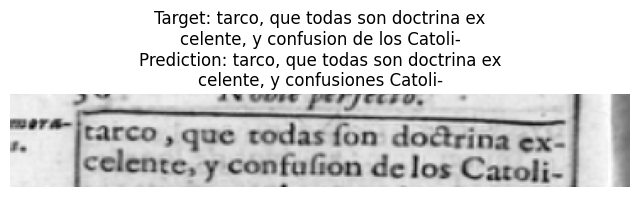

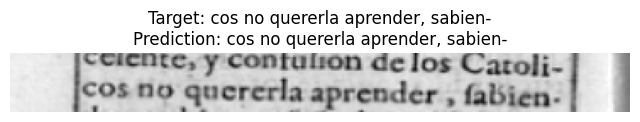

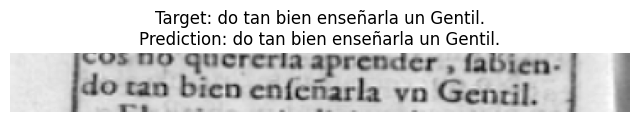

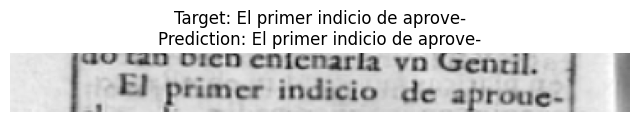

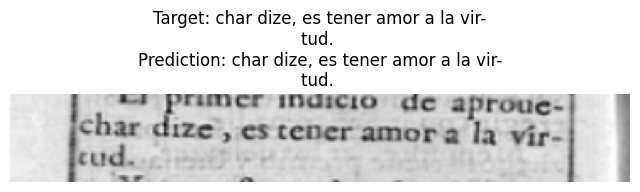

...

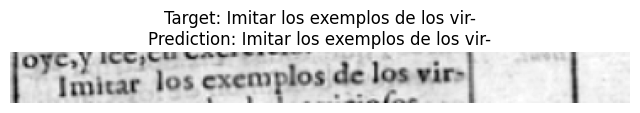

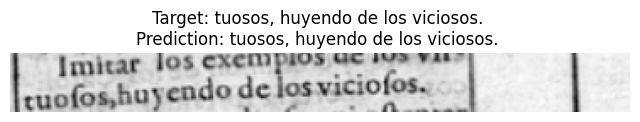

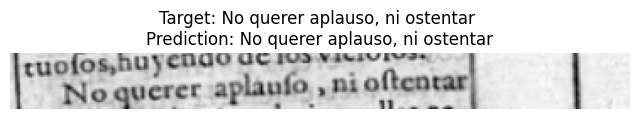

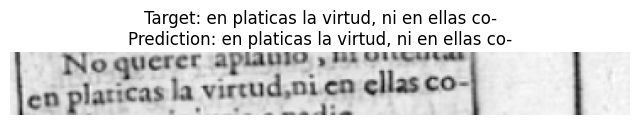

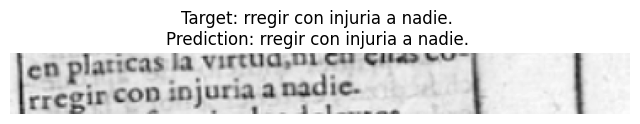

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


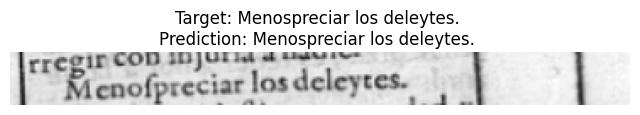

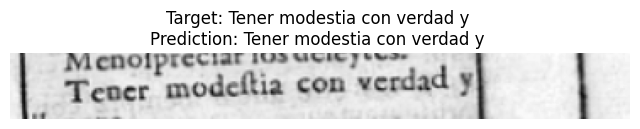

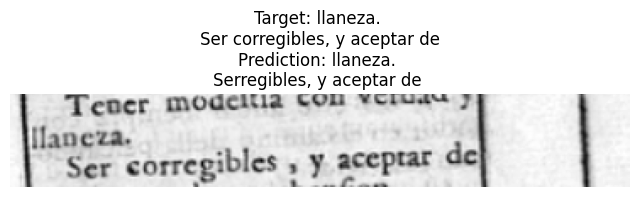

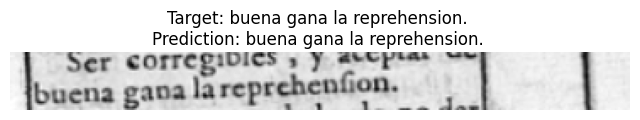

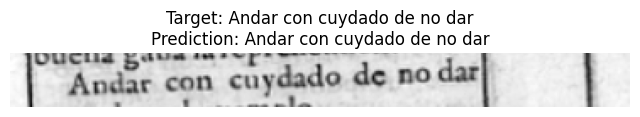

...

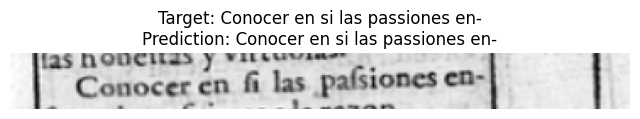

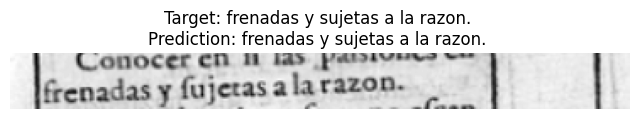

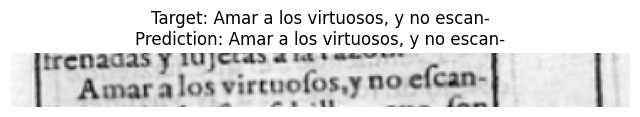

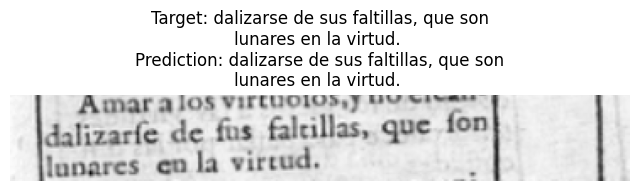

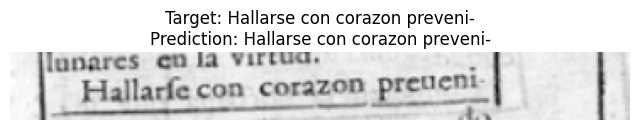

Average CER: 0.0007
Average WER: 0.0291
Average BLEU: 0.9024
Evaluation completed.


In [ ]:
test_line_images = '/content/test_images/P2-16'

aligned_data = {}
aligned_data['/content/image_folder2/Padilla - 2_page_16.png'] = align_segments_with_transcriptions('/content/image_folder2/Padilla - 2_page_16.png', test_line_images, transcript['/content/image_folder2/Padilla - 2_page_16.png'])

test_line_img = []
test_texts = []
for page_data in aligned_data.values():
    for line_img, text in page_data:
        test_line_img.append(line_img)
        test_texts.append(text)

evaluating_model(test_line_img, test_texts, target_size=(256, 64), batch_size=2)

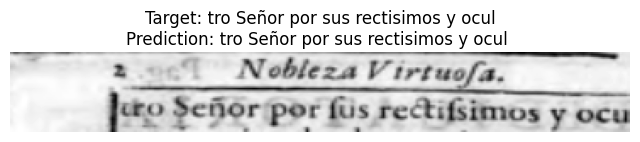

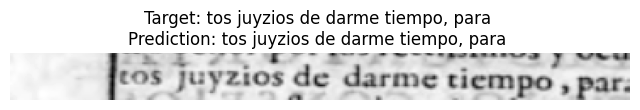

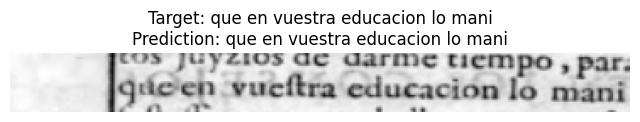

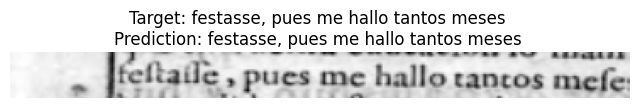

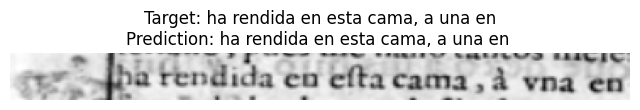

...

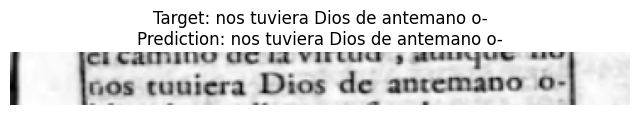

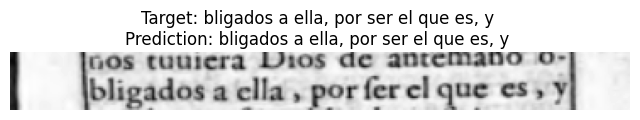

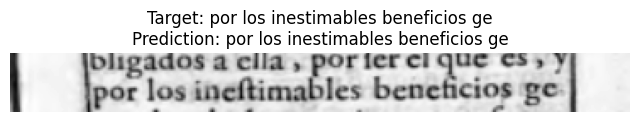

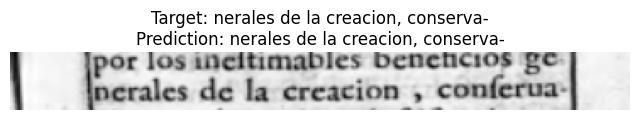

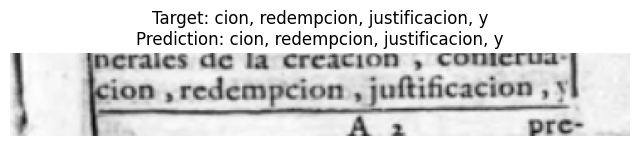

Average CER: 0.0007
Average WER: 0.0238
Average BLEU: 0.9547
Evaluation completed.


In [ ]:
test_line_images = '/content/test_images/P1-2'

aligned_data = {}
aligned_data['/content/image_folder1/Padilla - 1_page_2.png'] = align_segments_with_transcriptions('/content/image_folder1/Padilla - 1_page_2.png', test_line_images, transcript['/content/image_folder1/Padilla - 1_page_2.png'])

test_line_img = []
test_texts = []
for page_data in aligned_data.values():
    for line_img, text in page_data:
        test_line_img.append(line_img)
        test_texts.append(text)

evaluating_model(test_line_img, test_texts, target_size=(256, 64), batch_size=2)

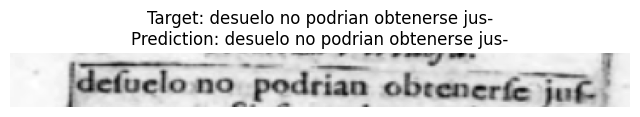

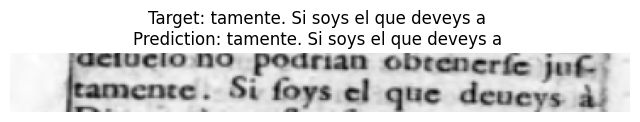

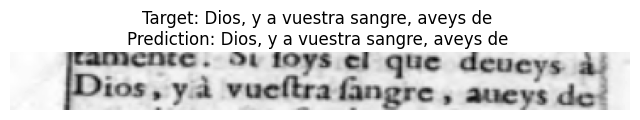

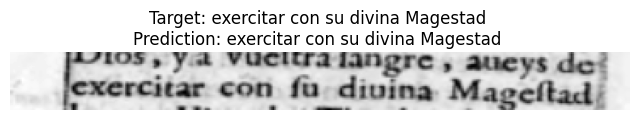

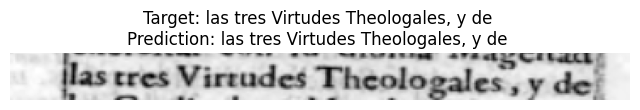

...

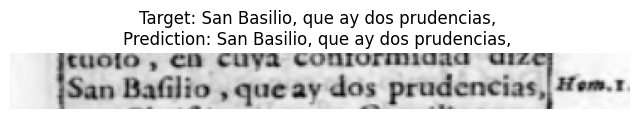

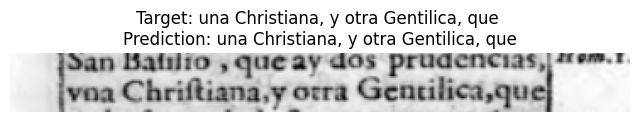

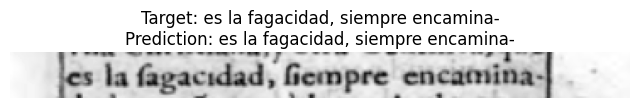

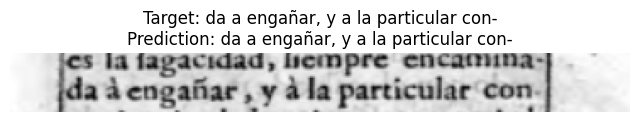

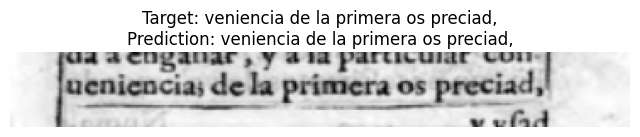

Average CER: 0.0004
Average WER: 0.0203
Average BLEU: 0.9387
Evaluation completed.


In [ ]:
test_line_images = '/content/test_images/P1-7'

aligned_data = {}
aligned_data['/content/image_folder1/Padilla - 1_page_7.png'] = align_segments_with_transcriptions('/content/image_folder1/Padilla - 1_page_7.png', test_line_images, transcript['/content/image_folder1/Padilla - 1_page_7.png'])

test_line_img = []
test_texts = []
for page_data in aligned_data.values():
    for line_img, text in page_data:
        test_line_img.append(line_img)
        test_texts.append(text)

evaluating_model(test_line_img, test_texts, target_size=(256, 64), batch_size=2)

#Training-1


In [ ]:
import torch
from torch.utils.data import Dataset, DataLoader
from transformers import TrOCRProcessor, VisionEncoderDecoderModel
from PIL import Image
import numpy as np
from torch.nn.utils.rnn import pad_sequence

class LineDataset(Dataset):
    def __init__(self,processor,model,line_images, texts, target_size=(256, 64)):
        self.line_images = line_images
        self.texts = texts
        self.processor = processor
        self.model = model
        self.target_size = target_size

    def __len__(self):
        return len(self.line_images)

    def __getitem__(self, idx):
        image = self.line_images[idx]
        text = self.texts[idx]

        # Convert image to PIL for resizing
        image = Image.fromarray((image * 255).astype(np.uint8))

        # Resize image
        image = image.resize(self.target_size, Image.BILINEAR)

        # Convert image back to numpy array and ensure it has 3 dimensions
        image = np.array(image) / 255.0
        if image.ndim == 2:
            image = np.expand_dims(image, axis=-1)  # Add a channel dimension if it's missing
            image = np.repeat(image, 3, axis=-1)   # Repeat the single channel to create 3 channels

        # Ensure the image has shape (3, height, width)
        image = np.transpose(image, (2, 0, 1))

        # Prepare inputs for the processor
        encoding = self.processor(images=image, text=text, return_tensors="pt")

        # Remove batch dimension from encoding
        encoding = {k: v.squeeze() for k, v in encoding.items()}
        return encoding

def collate_fn(batch):
    # Collate function to create batches
    pixel_values = torch.stack([item['pixel_values'] for item in batch])
    labels = pad_sequence([item['labels'] for item in batch], batch_first=True, padding_value=-100)
    return {'pixel_values': pixel_values, 'labels': labels}

def train_transformer_model(line_images, texts, target_size=(256, 64), batch_size=2):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    processor = TrOCRProcessor.from_pretrained("qantev/trocr-large-spanish", do_rescale=False)
    model = VisionEncoderDecoderModel.from_pretrained("qantev/trocr-large-spanish")

    dataset = LineDataset(processor, model, line_images, texts, target_size)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, collate_fn=collate_fn)
    model = dataset.model.to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr=5e-5)
    model.train()
    for epoch in range(3):  # Adjust epochs as needed
        for batch in dataloader:
            pixel_values = batch["pixel_values"].to(device)
            labels = batch["labels"].to(device)

            # Clear CUDA cache to free up memory
            torch.cuda.empty_cache()
            optimizer.zero_grad()

            outputs = model(pixel_values=pixel_values, labels=labels)
            loss = outputs.loss
            loss.backward()
            optimizer.step()
            print(f"Loss: {loss.item()}")
    model.save_pretrained("finetuned_transformer_model")
    dataset.processor.save_pretrained("finetuned_transformer_model")




In [ ]:
# Flatten the aligned data
line_images = []
texts = []
for page_data in aligned_data.values():
    for line_img, text in page_data:
        line_images.append(line_img)
        texts.append(text)

# Train the model with the resized images
train_transformer_model(line_images, texts, target_size=(256, 64), batch_size=2)


In [ ]:
# test

In [ ]:
def evaluate_model(line_images, texts, target_size=(256, 64), batch_size=2):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    model_path = "./finetuned_transformer_model"
    processor_path = "./finetuned_transformer_model"

    processor = TrOCRProcessor.from_pretrained(processor_path)
    model = VisionEncoderDecoderModel.from_pretrained(model_path)

    dataset = LineDataset(processor, model, line_images, texts, target_size)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False, collate_fn=collate_fn)
    model = dataset.model.to(device)
    model.eval()
    total_loss = 0
    num_batches = 0

    with torch.no_grad():
        for batch in dataloader:
            pixel_values = batch["pixel_values"].to(device)

            # Generate predictions
            generated_ids = model.generate(pixel_values)
            generated_texts = dataset.processor.batch_decode(generated_ids, skip_special_tokens=True)

            # Display images and predictions
            for i in range(len(generated_texts)):
                gt = texts[num_batches * batch_size + i]
                pred = generated_texts[i]
                image = line_images[num_batches * batch_size + i]

                plt.figure(figsize=(8, 6))
                plt.imshow(image, cmap='gray')
                plt.title(f"Target: {gt}\nPrediction: {pred}")
                plt.axis('off')
                plt.show()
                print("="*50)

            num_batches += 1

    print("Evaluation completed.")


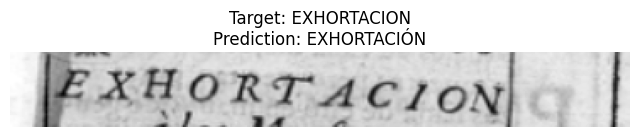

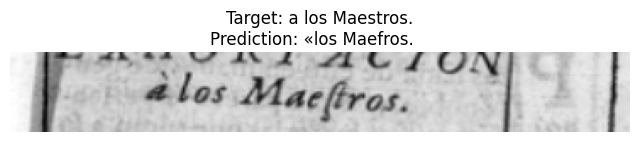

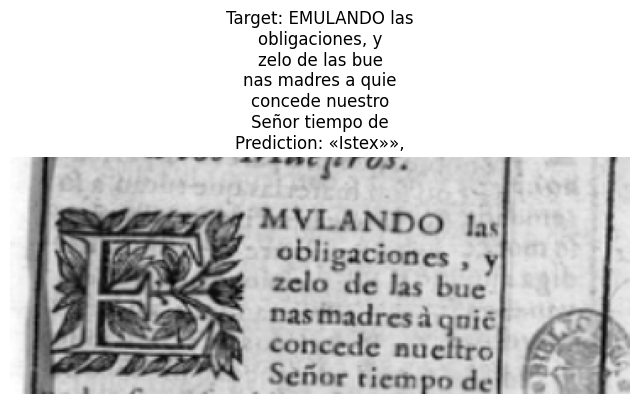

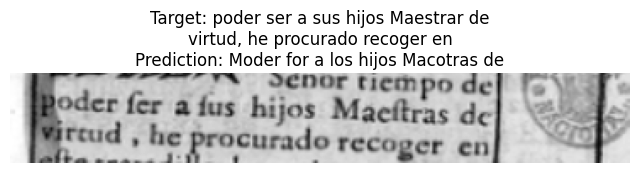

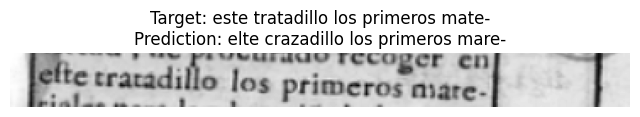

...

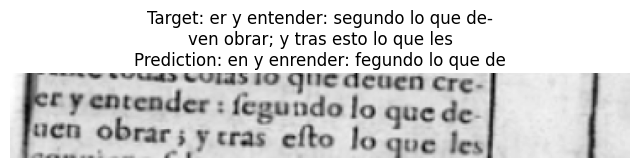

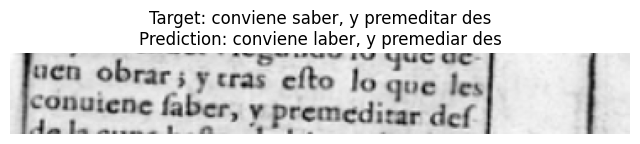

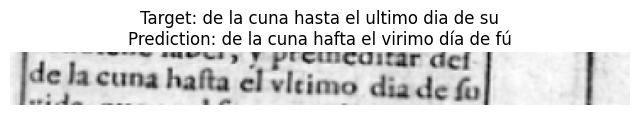

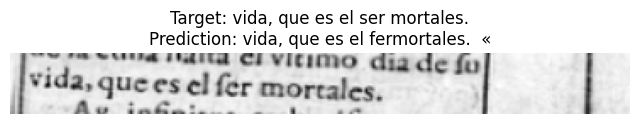

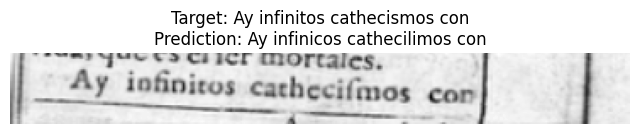

Evaluation completed.


In [ ]:
test_line_images = '/content/test_line_images'

aligned_data = {}

aligned_data['/content/image_folder2/Padilla - 2_page_1.png'] = align_segments_with_transcriptions('/content/image_folder2/Padilla - 2_page_1.png', test_line_images, transcript['/content/image_folder2/Padilla - 2_page_1.png'])

test_line_img = []
test_texts = []
for page_data in aligned_data.values():
    for line_img, text in page_data:
        test_line_img.append(line_img)
        test_texts.append(text)

evaluate_model(test_line_img, test_texts, target_size=(256, 64), batch_size=2)

/usr/local/lib/python3.10/dist-packages/transformers/generation/utils.py:1359: UserWarning: You have modified the pretrained model configuration to control generation. This is a deprecated strategy to control generation and will be removed soon, in a future version. Please use and modify the model generation configuration (see https://huggingface.co/docs/transformers/generation_strategies#default-text-generation-configuration )
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/generation/utils.py:1244: UserWarning: Using the model-agnostic default `max_length` (=20) to control the generation length. We recommend setting `max_new_tokens` to control the maximum length of the generation.
  warnings.warn(


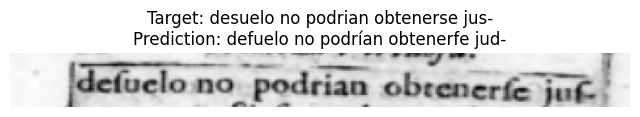

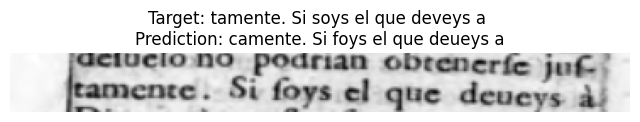

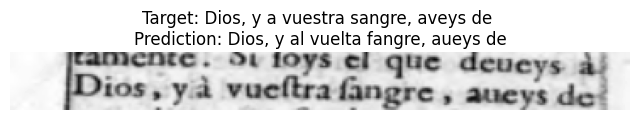

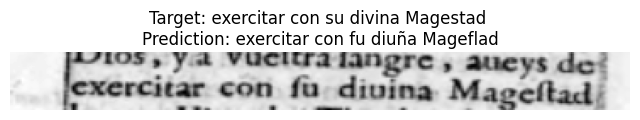

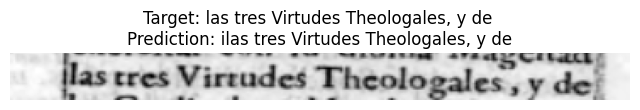

...

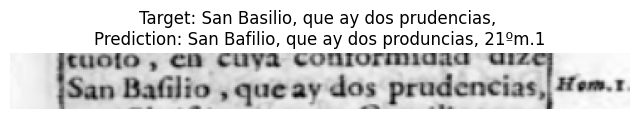

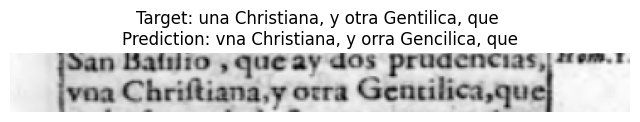

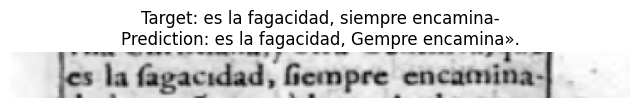

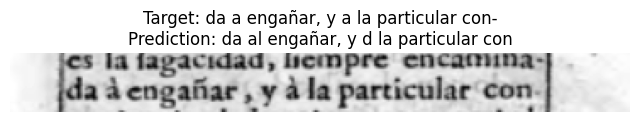

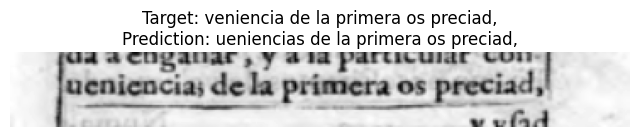

Evaluation completed.


In [ ]:
test_line_images = '/content/test_line_images2'

aligned_data = {}

aligned_data['/content/image_folder1/Padilla - 1_page_7.png'] = align_segments_with_transcriptions('/content/image_folder1/Padilla - 1_page_7.png', test_line_images, transcript['/content/image_folder1/Padilla - 1_page_7.png'])

test_line_img = []
test_texts = []
for page_data in aligned_data.values():
    for line_img, text in page_data:
        test_line_img.append(line_img)
        test_texts.append(text)

evaluate_model(test_line_img, test_texts, target_size=(256, 64), batch_size=2)

In [ ]:
! cp -r /content/drive/MyDrive/finetuned_transformer_model /content/finetuned_transformer_model

In [ ]:
import torch
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
from nltk.translate.bleu_score import sentence_bleu, corpus_bleu
from jiwer import wer
import jiwer

def evaluating_model(line_images, texts, target_size=(256, 64), batch_size=2):
    # device = torch.device('cpu')
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model_path = "./finetuned_transformer_model"
    processor_path = "./finetuned_transformer_model"

    processor = TrOCRProcessor.from_pretrained(processor_path)
    model = VisionEncoderDecoderModel.from_pretrained(model_path)

    dataset = LineDataset(processor, model, line_images, texts, target_size)

    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False, collate_fn=collate_fn)
    model = dataset.model.to(device)
    model.eval()
    total_loss = 0
    num_batches = 0

    cer_scores = []
    wer_scores = []
    bleu_scores = []

    with torch.no_grad():
        for batch in dataloader:
            pixel_values = batch["pixel_values"].to(device)

            # Generate predictions
            generated_ids = model.generate(pixel_values)
            generated_texts = dataset.processor.batch_decode(generated_ids, skip_special_tokens=True)

            # Calculate CER and WER for each prediction
            for i in range(len(generated_texts)):
                gt = texts[num_batches * batch_size + i]
                pred = generated_texts[i]

                # Calculate CER
                cer = jiwer.wer(gt, pred) / len(gt)
                cer_scores.append(cer)

                # Calculate WER
                wer_score = wer(gt, pred)
                wer_scores.append(wer_score)

                # Calculate BLEU score
                bleu_score = sentence_bleu([gt.split()], pred.split())
                bleu_scores.append(bleu_score)

                # Display image and predictions
                image = line_images[num_batches * batch_size + i]
                plt.figure(figsize=(8, 6))
                plt.imshow(image, cmap='gray')
                plt.title(f"Target: {gt}\nPrediction: {pred}")
                plt.axis('off')
                plt.show()
                print("="*50)

            num_batches += 1

    avg_cer = sum(cer_scores) / len(cer_scores) if cer_scores else 0
    avg_wer = sum(wer_scores) / len(wer_scores) if wer_scores else 0
    avg_bleu = sum(bleu_scores) / len(bleu_scores) if bleu_scores else 0

    print(f"Average CER: {avg_cer:.4f}")
    print(f"Average WER: {avg_wer:.4f}")
    print(f"Average BLEU: {avg_bleu:.4f}")
    print("Evaluation completed.")


/usr/local/lib/python3.10/dist-packages/transformers/generation/utils.py:1363: UserWarning: You have modified the pretrained model configuration to control generation. This is a deprecated strategy to control generation and will be removed soon, in a future version. Please use and modify the model generation configuration (see https://huggingface.co/docs/transformers/generation_strategies#default-text-generation-configuration )
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/generation/utils.py:1248: UserWarning: Using the model-agnostic default `max_length` (=20) to control the generation length. We recommend setting `max_new_tokens` to control the maximum length of the generation.
  warnings.warn(


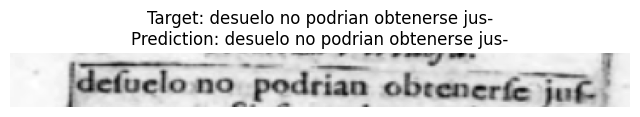

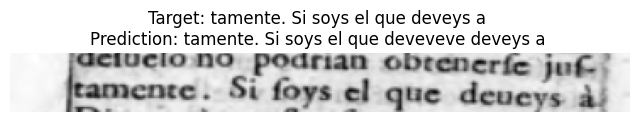

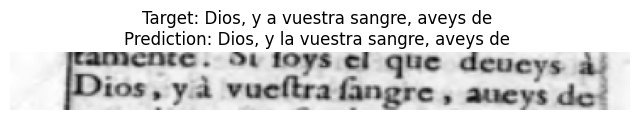

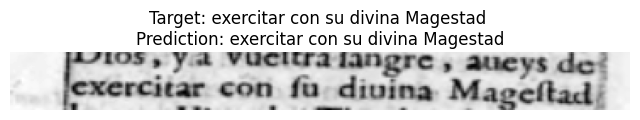

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


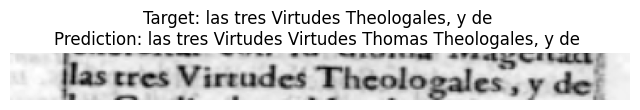

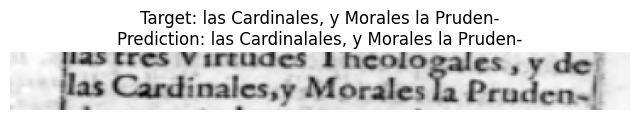

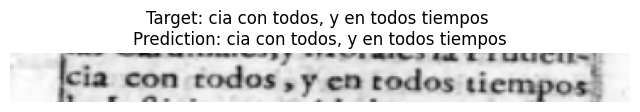

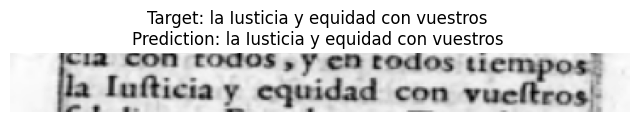

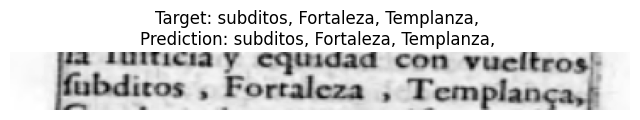

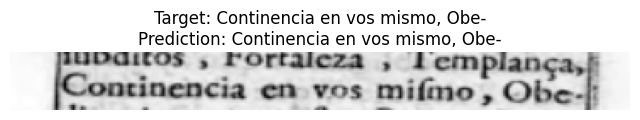

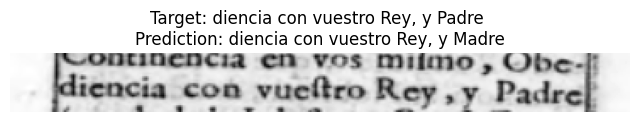

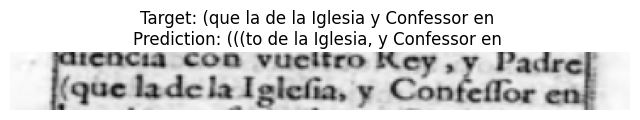

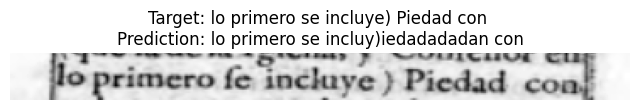

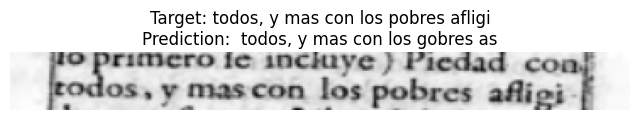

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


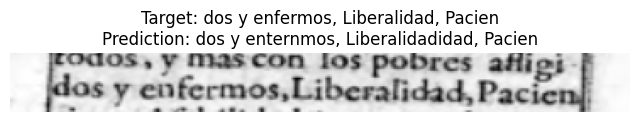

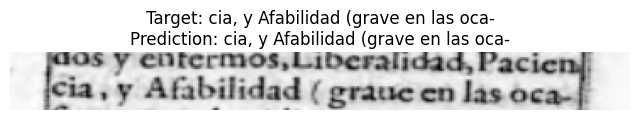

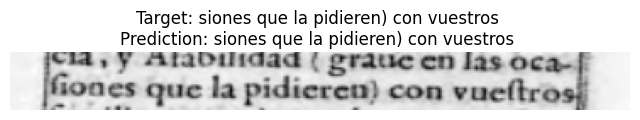

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


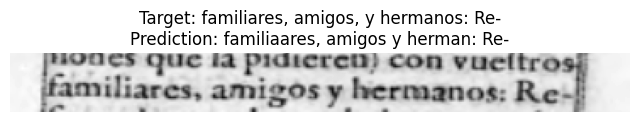

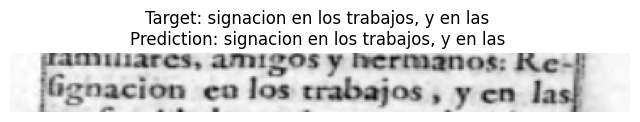

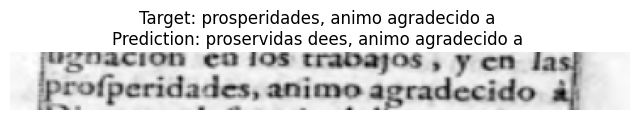

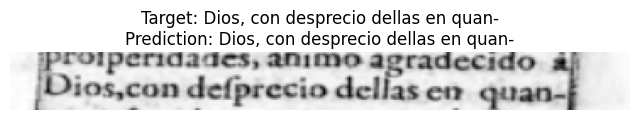

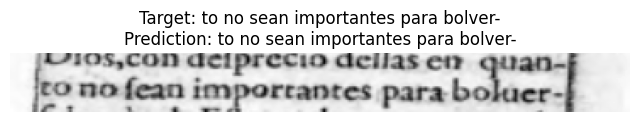

...

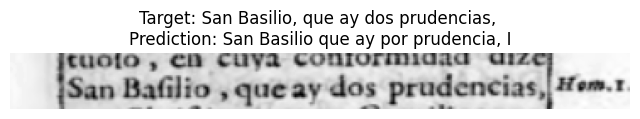

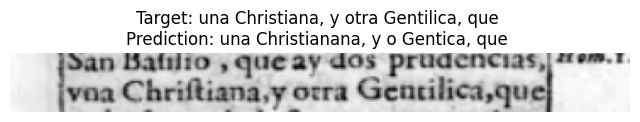

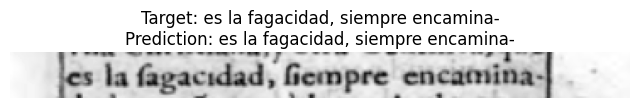

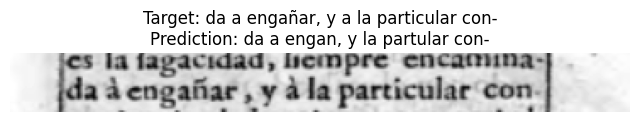

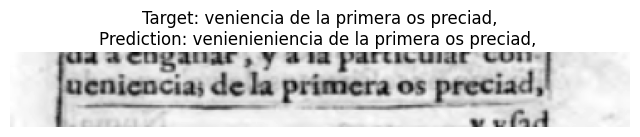

Average CER: 0.0054
Average WER: 0.1997
Average BLEU: 0.5559
Evaluation completed.


In [ ]:
test_line_images = '/content/test_images/P1-7'

aligned_data = {}

aligned_data['/content/image_folder1/Padilla - 1_page_7.png'] = align_segments_with_transcriptions('/content/image_folder1/Padilla - 1_page_7.png', test_line_images, transcript['/content/image_folder1/Padilla - 1_page_7.png'])

test_line_img = []
test_texts = []
for page_data in aligned_data.values():
    for line_img, text in page_data:
        test_line_img.append(line_img)
        test_texts.append(text)

evaluating_model(test_line_img, test_texts, target_size=(256, 64), batch_size=2)

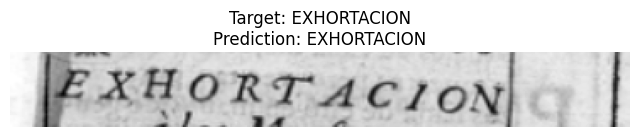

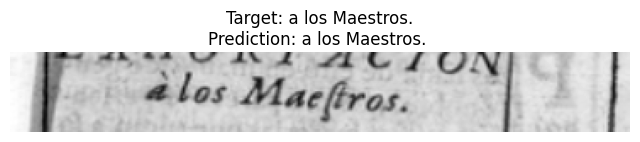

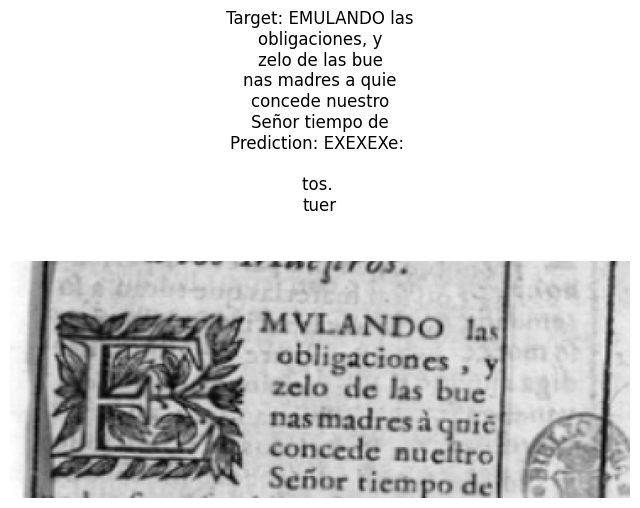

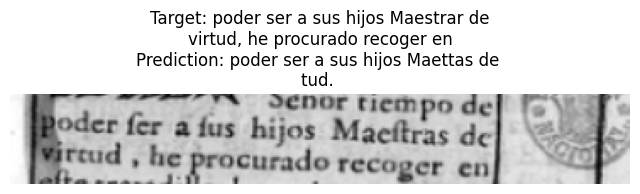

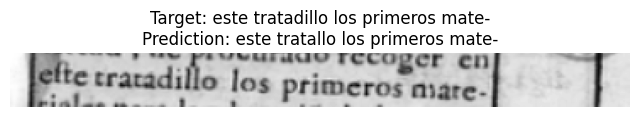

...

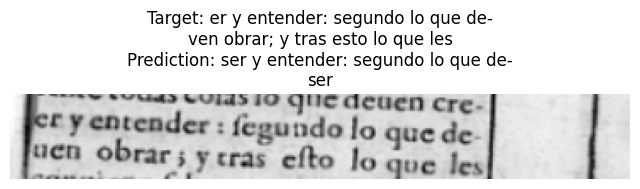

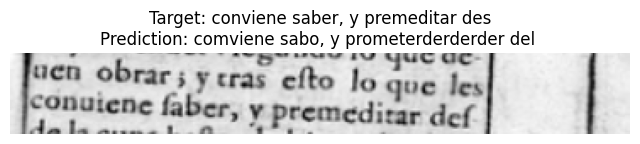

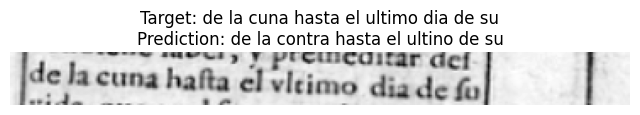

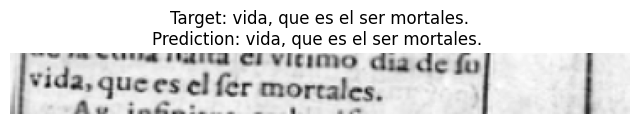

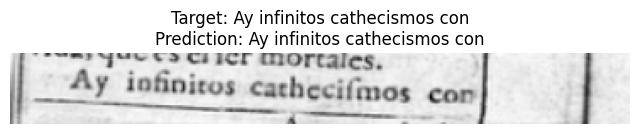

Average CER: 0.0061
Average WER: 0.3054
Average BLEU: 0.3684
Evaluation completed.


In [ ]:
test_line_images = '/content/test_images/P2-1'

aligned_data = {}

aligned_data['/content/image_folder2/Padilla - 2_page_1.png'] = align_segments_with_transcriptions('/content/image_folder2/Padilla - 2_page_1.png', test_line_images, transcript['/content/image_folder2/Padilla - 2_page_1.png'])

test_line_img = []
test_texts = []
for page_data in aligned_data.values():
    for line_img, text in page_data:
        test_line_img.append(line_img)
        test_texts.append(text)

evaluating_model(test_line_img, test_texts, target_size=(256, 64), batch_size=2)